In [1]:
# Step 1: Mount your Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Milestone 1

## Raw dataset

In [ ]:
import zipfile
import os

zip_path = "/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Raw.zip"
extract_path = "/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/"

# Check if extracted folder exists, otherwise extract
if not os.path.exists(f"{extract_path}/audio"):
    print("Extracting dataset...")
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_path)
    print("Extraction complete!")
else:
    print("Dataset already extracted.")


In [ ]:
import os

dataset_path = "/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset"

for root, dirs, files in os.walk(dataset_path):
    print(f"\nDirectory: {root}")
    for file in files[:5]:  # Display only first 5 files for each directory
        print(f"  🗂 {file}")



Directory: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset
  🗂 Raw.zip

Directory: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio

Directory: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/WAV_11025
  🗂 03bSnISJMiM.wav
  🗂 0h-zjBukYpk.wav
  🗂 1DmNV9C1hbY.wav
  🗂 1iG0909rllw.wav
  🗂 2WGyTLYerpo.wav

Directory: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/WAV_16000

Directory: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/WAV_16000/COVAREP
  🗂 03bSnISJMiM.mat
  🗂 0h-zjBukYpk.mat
  🗂 1DmNV9C1hbY.mat
  🗂 1iG0909rllw.mat
  🗂 2WGyTLYerpo.mat

Directory: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/WAV_16000/Full
  🗂 03bSnISJMiM.mat
  🗂 03bSnISJMiM.wav
  🗂 0h-zjBukYpk.mat
  🗂 0h-zjBukYpk.wav
  🗂 1DmNV9C1hbY.mat

Directory: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/WAV_16000/Segmented
  🗂 03bSnISJMiM_1.wav
  🗂 03bSnISJMiM_10.wav
  🗂 03bSnISJMiM_11.wav
  🗂 03bSnISJMi

## Preprocessing (Includes feature extraction)





### Audio

In [ ]:
import librosa
import IPython.display as ipd

audio_fp = '/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/WAV_11025/03bSnISJMiM.wav'

audio_data, sr = librosa.load(audio_fp, sr=None)

ipd.Audio(audio_data, rate=sr)


In [ ]:
import os

# Define output directory for preprocessed audio features
output_audio_folder = "/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/audio_features/"

# Create directory if it doesn't exist
os.makedirs(output_audio_folder, exist_ok=True)

print(f" Audio feature folder created: {output_audio_folder}")


 Audio feature folder created: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/audio_features/


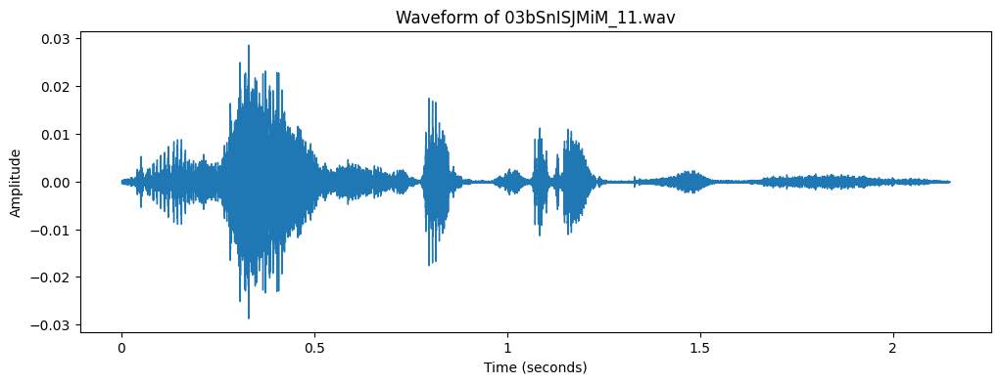

Loaded audio file: 03bSnISJMiM_11.wav with Sample Rate: 16000


In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import os

# Path to raw audio files
audio_folder = "/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/WAV_16000/Segmented"  # Update if needed
# Pick a sample audio file
sample_audio_file = os.listdir(audio_folder)[2]  # Select the first audio file
audio_path = os.path.join(audio_folder, sample_audio_file)

# Load the audio file
audio_data, sr = librosa.load(audio_path, sr=16000)  # Load with 16kHz sample rate

# Plot waveform
plt.figure(figsize=(12, 4))
librosa.display.waveshow(audio_data, sr=sr)
plt.title(f"Waveform of {sample_audio_file}")
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.show()

print(f"Loaded audio file: {sample_audio_file} with Sample Rate: {sr}")


In [ ]:
import numpy as np

# Function to extract audio features
def extract_audio_features(audio_path):
    audio_data, sr = librosa.load(audio_path, sr=16000)  # Load audio

    # Extract MFCCs
    mfccs = librosa.feature.mfcc(y=audio_data, sr=sr, n_mfcc=13)

    # Compute Spectrogram
    spectrogram = librosa.feature.melspectrogram(y=audio_data, sr=sr)
    spectrogram_db = librosa.power_to_db(spectrogram, ref=np.max)

    # Extract Chroma Features
    chroma = librosa.feature.chroma_stft(y=audio_data, sr=sr)

    return mfccs, spectrogram_db, chroma

# Extract features from the sample audio file
mfccs, spectrogram_db, chroma = extract_audio_features(audio_path)

print(f" Extracted Features: MFCC Shape: {mfccs.shape}, Spectrogram Shape: {spectrogram_db.shape}, Chroma Shape: {chroma.shape}")


 Extracted Features: MFCC Shape: (13, 68), Spectrogram Shape: (128, 68), Chroma Shape: (12, 68)


In [ ]:
# Function to process and save audio features
def process_audio_file(audio_path, output_path):
    mfccs, spectrogram_db, chroma = extract_audio_features(audio_path)

    # Save features as .npz (compressed NumPy format)
    np.savez(output_path, mfccs=mfccs, spectrogram=spectrogram_db, chroma=chroma)
    print(f" Processed & saved: {output_path}")

# Process all audio files in the dataset
for audio_file in os.listdir(audio_folder):
    if audio_file.endswith(".wav"):  # Ensure correct format
        audio_path = os.path.join(audio_folder, audio_file)
        output_path = os.path.join(output_audio_folder, f"{audio_file}.npz")  # Save as .npz
        process_audio_file(audio_path, output_path)

print("🎉 All audio features extracted and saved!")


 Processed & saved: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/audio_features/03bSnISJMiM_1.wav.npz
 Processed & saved: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/audio_features/03bSnISJMiM_10.wav.npz
 Processed & saved: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/audio_features/03bSnISJMiM_11.wav.npz
 Processed & saved: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/audio_features/03bSnISJMiM_12.wav.npz
 Processed & saved: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/audio_features/03bSnISJMiM_13.wav.npz
 Processed & saved: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/audio_features/03bSnISJMiM_2.wav.npz
 Processed & saved: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/audio_features/03bSnISJMiM_3.wav.npz
 Processed & saved: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Audio/audio_features/03bSnISJMiM_4.wav.npz
 Processed & saved: 

KeyboardInterrupt: 

In [ ]:
# Pick a sample processed audio file
sample_feature_file = os.listdir(output_audio_folder)[3]  # Select first file
sample_feature_path = os.path.join(output_audio_folder, sample_feature_file)

# Load extracted features
data = np.load(sample_feature_path)
print(f"Loaded feature file: {sample_feature_file}")
print(f"MFCC Shape: {data['mfccs'].shape}, Spectrogram Shape: {data['spectrogram'].shape}, Chroma Shape: {data['chroma'].shape}")


Loaded feature file: 03bSnISJMiM_12.wav.npz
MFCC Shape: (13, 85), Spectrogram Shape: (128, 85), Chroma Shape: (12, 85)


<ipython-input-137-75ef1ab755d3>:14: UserWarning: Trying to display complex-valued input. Showing magnitude instead.
  librosa.display.specshow(stft, sr=sr, x_axis='time', y_axis='hz')


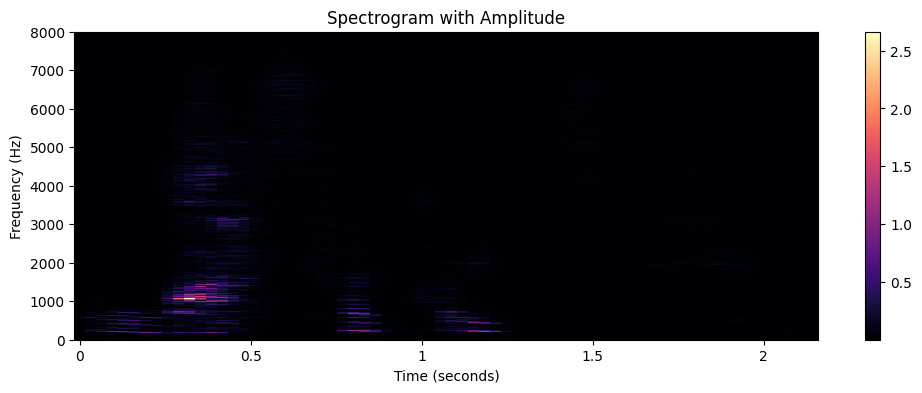

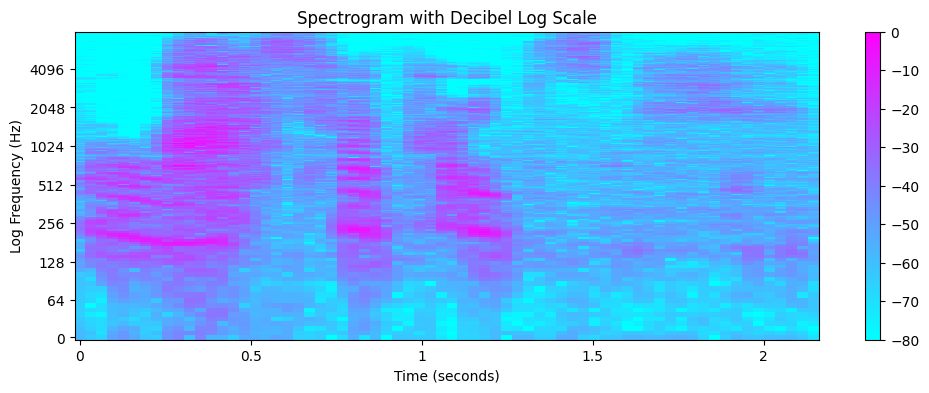

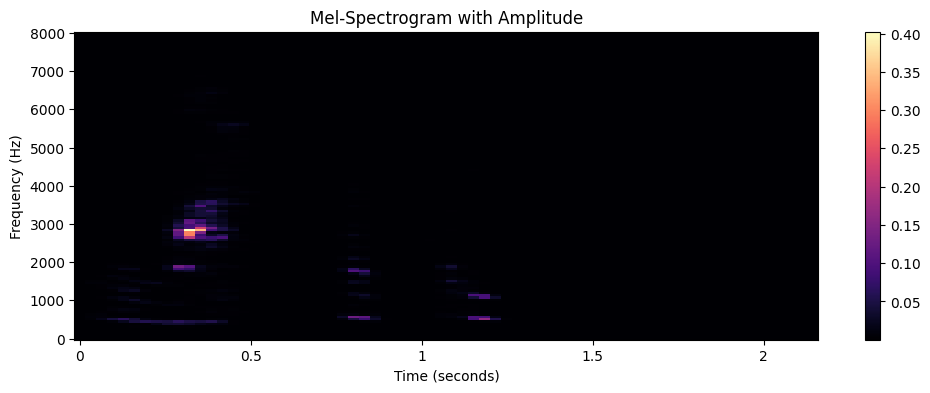

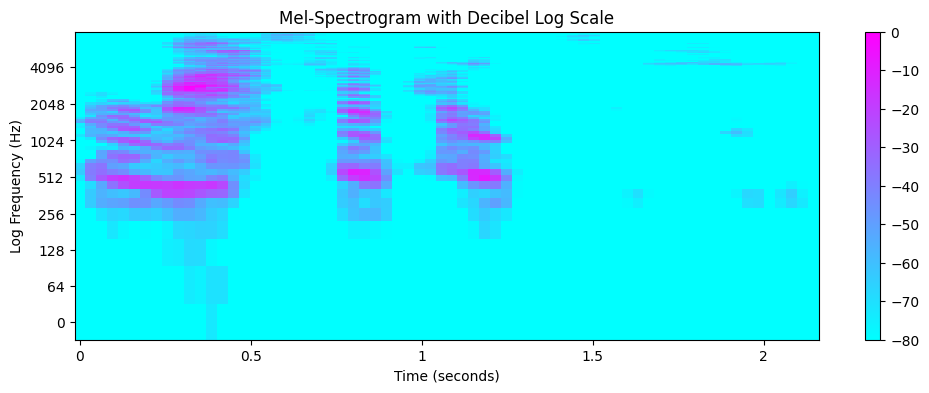

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt

# Compute Short-Time Fourier Transform (STFT)
n_fft = 2048  # Window size
hop_length = 512  # Hop length for STFT

stft = librosa.stft(audio_data, n_fft=n_fft, hop_length=hop_length)
stft_db = librosa.amplitude_to_db(abs(stft), ref=np.max)  # Convert amplitude to dB

# Spectrogram (Amplitude)**
plt.figure(figsize=(12, 4))
librosa.display.specshow(stft, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()
plt.title("Spectrogram with Amplitude")
plt.xlabel("Time (seconds)")
plt.ylabel("Frequency (Hz)")
plt.show()

# Spectrogram (Decibel Log Scale)**
plt.figure(figsize=(12, 4))
librosa.display.specshow(stft_db, sr=sr, x_axis='time', y_axis='log', cmap='cool')
plt.colorbar()
plt.title("Spectrogram with Decibel Log Scale")
plt.xlabel("Time (seconds)")
plt.ylabel("Log Frequency (Hz)")
plt.show()


melspec = librosa.feature.melspectrogram(y=audio_data, sr=sr, n_fft=n_fft, hop_length=hop_length)
melspec_db = librosa.amplitude_to_db(melspec, ref=np.max)


plt.figure(figsize=(12, 4))
librosa.display.specshow(melspec, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()
plt.title("Mel-Spectrogram with Amplitude")
plt.xlabel("Time (seconds)")
plt.ylabel("Frequency (Hz)")
plt.show()

plt.figure(figsize=(12, 4))
librosa.display.specshow(melspec_db, sr=sr, x_axis='time', y_axis='log', cmap='cool')
plt.colorbar()
plt.title("Mel-Spectrogram with Decibel Log Scale")
plt.xlabel("Time (seconds)")
plt.ylabel("Log Frequency (Hz)")
plt.show()


### Text

In [ ]:
transcript_folder = os.path.join(dataset_path, "Transcript")
print("Available transcript files:", os.listdir(transcript_folder)[:5])  # Show first 5 files


Available transcript files: ['Full', 'Segmented', 'processed_transcripts']


In [ ]:
# Define the path to transcript files
transcript_folder =  os.path.join(transcript_folder)

# List all transcript files
transcript_files = os.listdir(transcript_folder)

# Show a sample of transcript files
print(f" Found {len(transcript_files)} transcript files")
print("Sample files:", transcript_files[:5])


 Found 3 transcript files
Sample files: ['Full', 'Segmented', 'processed_transcripts']


In [ ]:
import os

# Define the transcript directory
transcript_dir = "/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Transcript/Full"

# List files in the transcript directory
transcript_files = os.listdir(transcript_dir)

# Ensure there are files in the directory
if transcript_files:
    first_transcript = transcript_files[0]  # Pick the first transcript file
    transcript_path = os.path.join(transcript_dir, first_transcript)

    # Read and display the transcript
    with open(transcript_path, "r", encoding="utf-8") as file:
        transcript_text = file.read()

    print(f" Displaying transcript: {first_transcript}\n")
    print(transcript_text)
else:
    print(" No transcript files found in the directory.")


 Displaying transcript: 03bSnISJMiM.textonly

 Oh this quality is horrible Ok well anyhow um This is xxx xxx and I just wanted to do a review of the movie Hanna coz I just watched it today with my family oh and BTW Happy Easter Ok Anyhow Hanna is basicaly about um I dont wanna give it away but basicaly this girl husband trained her whole life to fight and just be prepared for whats out there and trying to get her Anyhow It was really good thay did they didnt really do a whole bunch of background info on why she has to fight and be prepared I mean they did a little bit of it but not a whole bunch and they shouldve I guess they shouldve live up with more and xxx but besides that it was all over pretty good and there is like someone while someone there was a lot of action oh my god a lot of action there is sad part a lot of sad parts but it was really really awesome um well Ok so hanna she goes with this family and shes with this family and Im not gonna say why but the daughter of the fam

In [ ]:
import nltk
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
import os
import re
import nltk
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer

# Set NLTK WordNet path if needed (adjust if you're using custom location)
nltk.data.path.append('/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/wordnet')  # Optional
transcript_folder = "/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Transcript/Full"
transcript_files = os.listdir(transcript_folder)
# Initialize Lemmatizer
lemmatizer = WordNetLemmatizer()
output_text_folder= "/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Transcript/processed_transcripts"
os.makedirs(output_text_folder, exist_ok=True)
# Text cleaning and lemmatization function
def clean_text(text):
    text = text.lower()
    text = re.sub(r'\W', ' ', text)
    text = re.sub(r'\s+', ' ', text).strip()
    words = text.split()
    words = [lemmatizer.lemmatize(word) for word in words]
    return ' '.join(words)

# Process each transcript file
for transcript_file in transcript_files:
    transcript_path = os.path.join(transcript_folder, transcript_file)

    with open(transcript_path, "r", encoding="utf-8") as file:
        text = file.read()

    cleaned_text = clean_text(text)

    output_file = os.path.join(output_text_folder, transcript_file + ".processed")
    with open(output_file, "w", encoding="utf-8") as out_file:
        out_file.write(cleaned_text)

print(f" Processed {len(transcript_files)} transcript files and saved them in {output_text_folder}")


 Processed 93 transcript files and saved them in /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Transcript/processed_transcripts


### Video

In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

video_folder = "/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/Segmented"
output_folder = "/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/adaptive_segmented_frames"

os.makedirs(output_folder, exist_ok=True)

# Function to measure motion intensity between frames
def compute_motion_intensity(frame1, frame2):
    diff = cv2.absdiff(frame1, frame2)
    gray_diff = cv2.cvtColor(diff, cv2.COLOR_BGR2GRAY)
    motion_score = np.mean(gray_diff)  # Normalize motion intensity
    return motion_score

# Function to extract frames dynamically based on motion
def extract_adaptive_frames(video_path, output_path):
    cap = cv2.VideoCapture(video_path)
    frame_list = []
    frame_idx = 0
    prev_frame = None

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        if prev_frame is not None:
            motion_intensity = compute_motion_intensity(prev_frame, frame)

            # Adaptive frame rate based on motion
            if motion_intensity > 10:
                frame_rate = 2   # High motion -> Extract more frames
            elif motion_intensity > 5:
                frame_rate = 5   # Medium motion
            else:
                frame_rate = 10  # Low motion

        else:
            frame_rate = 5  # Default extraction rate for the first frame

        if frame_idx % frame_rate == 0:
            frame_resized = cv2.resize(frame, (224, 224))
            frame_list.append(frame_resized)

        prev_frame = frame.copy()
        frame_idx += 1

    cap.release()

    if frame_list:
        np.save(output_path, np.array(frame_list))
        print(f"Processed: {video_path} ({len(frame_list)} frames)")

# Process all videos
for video_file in os.listdir(video_folder):
    if video_file.endswith(".mp4"):
        video_path = os.path.join(video_folder, video_file)
        output_path = os.path.join(output_folder, f"{video_file}.npy")
        extract_adaptive_frames(video_path, output_path)

print("Adaptive segmented video frames extracted and saved!")



Processed: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/Segmented/VbQk4H8hgr0_2.mp4 (11 frames)
Processed: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/Segmented/VbQk4H8hgr0_20.mp4 (22 frames)
Processed: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/Segmented/VbQk4H8hgr0_21.mp4 (6 frames)
Processed: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/Segmented/VbQk4H8hgr0_22.mp4 (11 frames)
Processed: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/Segmented/VbQk4H8hgr0_23.mp4 (5 frames)
Processed: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/Segmented/VbQk4H8hgr0_24.mp4 (8 frames)
Processed: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/Segmented/VbQk4H8hgr0_25.mp4 (10 frames)
Processed: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/Segmented/VbQk4H8hgr0_26.mp4 (26 frames)
Processed: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Datase

In [ ]:
# Pick a sample processed video file
sample_feature_file = os.listdir(output_folder)[0]
sample_feature_path = os.path.join(output_folder, sample_feature_file)

# Load extracted frames
frames = np.load(sample_feature_path)
print("Feature Shape:", frames.shape)  # (Num_Frames, 224, 224, 3)

Feature Shape: (11, 224, 224, 3)


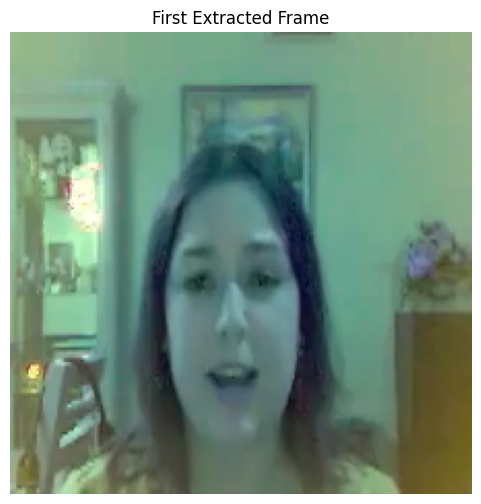

In [ ]:
# Plot pixel intensity of the first frame
plt.figure(figsize=(6, 6))
plt.imshow(frames[0])
plt.title("First Extracted Frame")
plt.axis("off")
plt.show()

## Class Imbalance Adjustment

In [ ]:
import pandas as pd
import numpy as np
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.model_selection import train_test_split
import os
from mmsdk import mmdatasdk

labels_file = "/content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_labels/CMU_MOSI_Opinion_Labels.csd"
mosi_labels = mmdatasdk.mmdataset({"CMU_MOSI_Opinion_Labels": labels_file})

data = []
raw_labels = []  # Store raw sentiment scores before discretization

for video_id in mosi_labels["CMU_MOSI_Opinion_Labels"].data.keys():
    features = mosi_labels["CMU_MOSI_Opinion_Labels"].data[video_id]['features']
    timestamps = mosi_labels["CMU_MOSI_Opinion_Labels"].data[video_id]['intervals']

    for i in range(len(features)):
        label = features[i][0]  # Extract numerical sentiment score
        raw_labels.append(label)  # Store raw label before discretization

        timestamp = timestamps[i]

        # Convert continuous sentiment score into discrete class
        if label < 0:
            sentiment_class = -1  # Negative
        elif label > 0 :
            sentiment_class = 1  # Positive
        else:
            sentiment_class = 0  # Neutral


        data.append([video_id, timestamp[0], timestamp[1], sentiment_class])


print("Original (Continuous) Sentiment Score Distribution:", Counter(raw_labels))

df = pd.DataFrame(data, columns=["video_id", "start_time", "end_time", "label"])

original_counts = Counter(df["label"])
print("Original (Discrete) Class Distribution:", Counter(df["label"]))

X = df.drop(columns=["label"])  # Features
y = df["label"].astype(int)     # Convert to categorical labels

# Convert categorical video_id to numerical (One-Hot Encoding)
X = pd.get_dummies(X, columns=["video_id"])

smote = SMOTE(sampling_strategy='auto', random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)

df_resampled = pd.DataFrame(X_resampled)
df_resampled["label"] = y_resampled
resampled_counts = Counter(y_resampled)
output_path = "/content/drive/MyDrive/CMU_MOSI_Project/Balanced_CMU_MOSI.csv"
df_resampled.to_csv(output_path, index=False)

print(" Resampled Class Distribution:", Counter(y_resampled))
print(f" Balanced dataset saved at: {output_path}")


[2025-03-28 00:27:03.918] | Success | Computational sequence read from file /content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_labels/CMU_MOSI_Opinion_Labels.csd ...
[2025-03-28 00:27:03.949] | Status  | Checking the integrity of the <Opinion Segment Labels> computational sequence ...
[2025-03-28 00:27:03.949] | Status  | Checking the format of the data in <Opinion Segment Labels> computational sequence ...


[2025-03-28 00:27:04.075] | Success | <Opinion Segment Labels> computational sequence data in correct format.
[2025-03-28 00:27:04.075] | Status  | Checking the format of the metadata in <Opinion Segment Labels> computational sequence ...
[2025-03-28 00:27:04.075] | Warning | <Opinion Segment Labels> computational sequence does not have all the required metadata ... continuing 
[2025-03-28 00:27:04.075] | Success | Dataset initialized successfully ... 


Original (Continuous) Sentiment Score Distribution: Counter({np.float32(2.0): 120, np.float32(-1.0): 110, np.float32(-2.0): 103, np.float32(0.0): 96, np.float32(2.2): 94, np.float32(1.8): 94, np.float32(1.4): 92, np.float32(-1.6): 91, np.float32(1.6): 90, np.float32(-1.4): 79, np.float32(0.8): 77, np.float32(-1.8): 72, np.float32(-1.2): 71, np.float32(-0.4): 69, np.float32(-0.8): 68, np.float32(1.2): 68, np.float32(0.6): 63, np.float32(0.4): 62, np.float32(1.0): 62, np.float32(0.2): 61, np.float32(-2.2): 61, np.float32(-0.2): 55, np.float32(-0.6): 55, np.float32(2.4): 54, np.float32(2.6): 44, np.float32(-2.4): 40, np.float32(-2.6): 36, np.float32(-2.8): 32, np.float32(2.8): 29, np.float32(-0.5): 18, np.float32(0.5): 17, np.float32(0.25): 12, np.float32(3.0): 12, np.float32(-3.0): 12, np.float32(-1.5): 10, np.float32(-0.25): 10, np.float32(-1.25): 8, np.float32(-0.75): 8, np.float32(1.25): 7, np.float32(-1.75): 4, np.float32(1.75): 4, np.float32(0.75): 4, np.float32(1.3333334): 4, np.fl

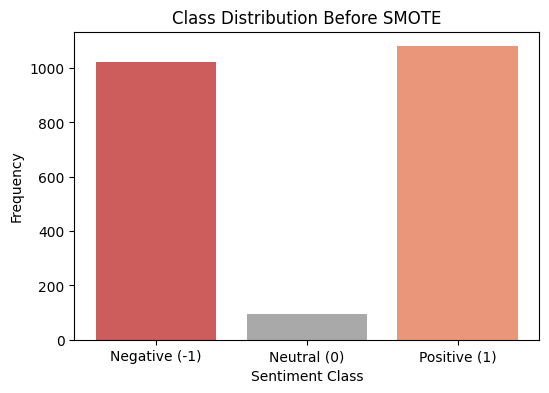

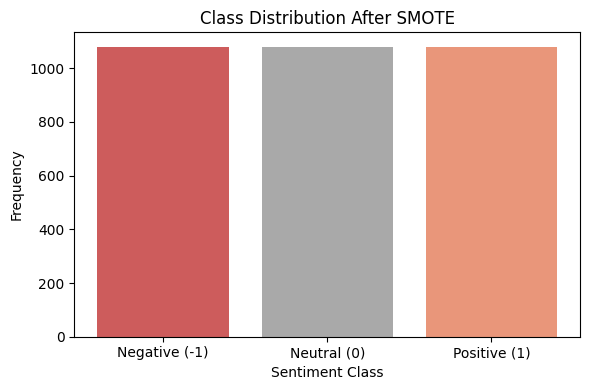

In [ ]:
import matplotlib.pyplot as plt

# Before SMOTE
plt.figure(figsize=(6,4))
plt.bar(["Negative (-1)", "Neutral (0)", "Positive (1)"],
        [original_counts[-1], original_counts[0], original_counts[1]],
        color=["indianred", "darkgray", "darksalmon"])
plt.title("Class Distribution Before SMOTE")
plt.xlabel("Sentiment Class")
plt.ylabel("Frequency")

# After SMOTE

plt.figure(figsize=(6,4))
plt.bar(["Negative (-1)", "Neutral (0)", "Positive (1)"],
        [resampled_counts[-1], resampled_counts[0], resampled_counts[1]],
        color=["indianred", "darkgray", "darksalmon"])
plt.title("Class Distribution After SMOTE")
plt.xlabel("Sentiment Class")
plt.ylabel("Frequency")

plt.tight_layout()
plt.show()

## Saving CMU-MOSI features in Dataframe (will be used in modeling feature engineering)

In [ ]:
import pandas as pd
import numpy as np
from mmsdk import mmdatasdk

# Paths to CMU-MOSI Feature Files
labels_file = "/content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_raw/CMU_MOSI_Opinion_Labels.csd"
acoustic_file = "/content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_raw/CMU_MOSI_COVAREP.csd"
visual_file = "/content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_raw/CMU_MOSI_Visual_OpenFace_1.csd"
text_file = "/content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_raw/CMU_MOSI_TimestampedWordVectors.csd"

# Load CMU-MOSI Dataset
mosi_data = mmdatasdk.mmdataset({
    "labels": labels_file,
    "acoustic": acoustic_file,
    "visual": visual_file,
    "text": text_file
})

# Dynamically determine feature dimensions
def get_feature_dim(data_dict, key, default_dim):
    """Returns the feature dimension if available, otherwise returns a default."""
    for vid in data_dict.keys():
        features = data_dict[vid].get("features", None)
        if features is not None and len(features) > 0:
            return features.shape[1]  # Extract feature dimension
    return default_dim  # Use default if no valid features found

# Get actual feature dimensions
acoustic_dim = get_feature_dim(mosi_data["acoustic"].data, "acoustic", 74)
visual_dim = get_feature_dim(mosi_data["visual"].data, "visual", 35)
text_dim = get_feature_dim(mosi_data["text"].data, "text", 300)

# Initialize data list
# Initialize data list
data = []

for video_id in mosi_data["labels"].data.keys():
    sentiment_scores = mosi_data["labels"].data[video_id]['features']
    sentiment_intervals = mosi_data["labels"].data[video_id]['intervals']

    # Extract Features & Handle Missing Data
    acoustic_features = mosi_data["acoustic"].data.get(video_id, {}).get('features', np.zeros((1, acoustic_dim)))
    visual_features = mosi_data["visual"].data.get(video_id, {}).get('features', np.zeros((1, visual_dim)))
    text_features = mosi_data["text"].data.get(video_id, {}).get('features', np.zeros((1, text_dim)))

    # Use mean pooling if the feature is variable-length
    acoustic_avg = np.mean(acoustic_features, axis=0) if len(acoustic_features.shape) > 1 else np.zeros(acoustic_dim)
    visual_avg = np.mean(visual_features, axis=0) if len(visual_features.shape) > 1 else np.zeros(visual_dim)
    text_avg = np.mean(text_features, axis=0) if len(text_features.shape) > 1 else np.zeros(text_dim)

    for i in range(len(sentiment_scores)):
        # Extract sentiment and timestamps
        sentiment = sentiment_scores[i][0]  # Ensure this is a single float value
        start_time, end_time = sentiment_intervals[i]

        # Store Data (Sentiment score is at the correct position)
        data.append([video_id, start_time, end_time, sentiment] +
                    list(acoustic_avg) + list(visual_avg) + list(text_avg))

# Convert to DataFrame
columns = (
    ["video_id", "start_time", "end_time", "sentiment_score"] +
    [f"acoustic_{i}" for i in range(acoustic_dim)] +
    [f"visual_{i}" for i in range(visual_dim)] +
    [f"text_{i}" for i in range(text_dim)]
)
df_features = pd.DataFrame(data, columns=columns)

# Save CSV with Features
features_csv_path = "/content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_Features.csv"
df_features.to_csv(features_csv_path, index=False)

print(f" Features saved at: {features_csv_path}")


[2025-03-28 01:25:40.920] | Success | Computational sequence read from file /content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_raw/CMU_MOSI_Opinion_Labels.csd ...
[2025-03-28 01:25:40.944] | Status  | Checking the integrity of the <Opinion Segment Labels> computational sequence ...
[2025-03-28 01:25:40.944] | Status  | Checking the format of the data in <Opinion Segment Labels> computational sequence ...


[2025-03-28 01:25:41.065] | Success | <Opinion Segment Labels> computational sequence data in correct format.
[2025-03-28 01:25:41.065] | Status  | Checking the format of the metadata in <Opinion Segment Labels> computational sequence ...
[2025-03-28 01:25:41.065] | Warning | <Opinion Segment Labels> computational sequence does not have all the required metadata ... continuing 


[2025-03-28 01:25:41.246] | Success | Computational sequence read from file /content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_raw/CMU_MOSI_COVAREP.csd ...
[2025-03-28 01:25:41.266] | Status  | Checking the integrity of the <COVAREP> computational sequence ...
[2025-03-28 01:25:41.266] | Status  | Checking the format of the data in <COVAREP> computational sequence ...


[2025-03-28 01:25:41.411] | Success | <COVAREP> computational sequence data in correct format.
[2025-03-28 01:25:41.411] | Status  | Checking the format of the metadata in <COVAREP> computational sequence ...
[2025-03-28 01:25:41.411] | Warning | <COVAREP> computational sequence does not have all the required metadata ... continuing 


[2025-03-28 01:25:41.613] | Success | Computational sequence read from file /content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_raw/CMU_MOSI_Visual_OpenFace_1.csd ...
[2025-03-28 01:25:41.628] | Status  | Checking the integrity of the <OpenFace_1> computational sequence ...
[2025-03-28 01:25:41.628] | Status  | Checking the format of the data in <OpenFace_1> computational sequence ...


[2025-03-28 01:25:41.750] | Success | <OpenFace_1> computational sequence data in correct format.
[2025-03-28 01:25:41.750] | Status  | Checking the format of the metadata in <OpenFace_1> computational sequence ...
[2025-03-28 01:25:41.750] | Warning | <OpenFace_1> computational sequence does not have all the required metadata ... continuing 
[2025-03-28 01:25:41.789] | Success | Computational sequence read from file /content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_raw/CMU_MOSI_TimestampedWordVectors.csd ...


[2025-03-28 01:25:41.827] | Status  | Checking the integrity of the <glove_vectors> computational sequence ...
[2025-03-28 01:25:41.827] | Status  | Checking the format of the data in <glove_vectors> computational sequence ...


[2025-03-28 01:25:41.977] | Success | <glove_vectors> computational sequence data in correct format.
[2025-03-28 01:25:41.977] | Status  | Checking the format of the metadata in <glove_vectors> computational sequence ...
[2025-03-28 01:25:41.977] | Warning | <glove_vectors> computational sequence does not have all the required metadata ... continuing 
[2025-03-28 01:25:41.977] | Success | Dataset initialized successfully ... 


 Features saved at: /content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_Features.csv


In [ ]:
df.columns

Index(['video_id', 'start_time', 'end_time', 'sentiment_score', 'acoustic_0',
       'acoustic_1', 'acoustic_2', 'acoustic_3', 'acoustic_4', 'acoustic_5',
       ...
       'text_291', 'text_292', 'text_293', 'text_294', 'text_295', 'text_296',
       'text_297', 'text_298', 'text_299', 'sentiment_category'],
      dtype='object', length=809)

In [ ]:
# Check if sentiment values are within expected range
df_features["sentiment_score"].describe()

,sentiment_score
count,2199.000000
mean,0.070267
std,1.571723
min,-3.000000
25%,-1.250000
50%,0.000000
75%,1.400000
max,3.000000


In [ ]:
# Show Sample Dat
df_features.head()

,video_id,start_time,end_time,sentiment_score,acoustic_0,acoustic_1,acoustic_2,acoustic_3,acoustic_4,acoustic_5,...,text_290,text_291,text_292,text_293,text_294,text_295,text_296,text_297,text_298,text_299
0,03bSnISJMiM,51.904533,55.945351,2.40,231.982681,0.518543,0.10173,0.312767,4.735631,0.26167,...,-0.028237,-0.007658,-0.129621,-0.089237,0.061532,0.106335,-0.066678,-0.036917,-0.048457,0.117718
1,03bSnISJMiM,56.045124,66.780724,-0.80,231.982681,0.518543,0.10173,0.312767,4.735631,0.26167,...,-0.028237,-0.007658,-0.129621,-0.089237,0.061532,0.106335,-0.066678,-0.036917,-0.048457,0.117718
2,03bSnISJMiM,66.780724,68.736282,-1.00,231.982681,0.518543,0.10173,0.312767,4.735631,0.26167,...,-0.028237,-0.007658,-0.129621,-0.089237,0.061532,0.106335,-0.066678,-0.036917,-0.048457,0.117718
3,03bSnISJMiM,68.736282,70.542175,-1.75,231.982681,0.518543,0.10173,0.312767,4.735631,0.26167,...,-0.028237,-0.007658,-0.129621,-0.089237,0.061532,0.106335,-0.066678,-0.036917,-0.048457,0.117718
4,03bSnISJMiM,70.542175,71.699547,0.00,231.982681,0.518543,0.10173,0.312767,4.735631,0.26167,...,-0.028237,-0.007658,-0.129621,-0.089237,0.061532,0.106335,-0.066678,-0.036917,-0.048457,0.117718


## Visualizations

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Load CMU-MOSI extracted features
features_csv_path = "/content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_Features.csv"
df = pd.read_csv(features_csv_path)

# Display basic info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2199 entries, 0 to 2198
Columns: 808 entries, video_id to text_299
dtypes: float64(807), object(1)
memory usage: 13.6+ MB


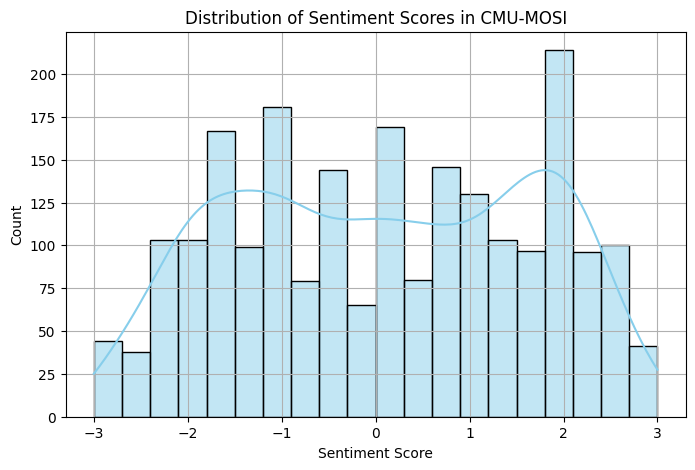

In [ ]:
plt.figure(figsize=(8, 5))
sns.histplot(df["sentiment_score"], bins=20, kde=True, color="skyblue")
plt.title("Distribution of Sentiment Scores in CMU-MOSI")
plt.xlabel("Sentiment Score")
plt.ylabel("Count")
plt.grid()
plt.show()

<ipython-input-59-c7cba0bdbd92>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x="sentiment_category", data=df, palette={"Negative": "lightblue", "Neutral": "gray", "Positive": "lightgreen"})


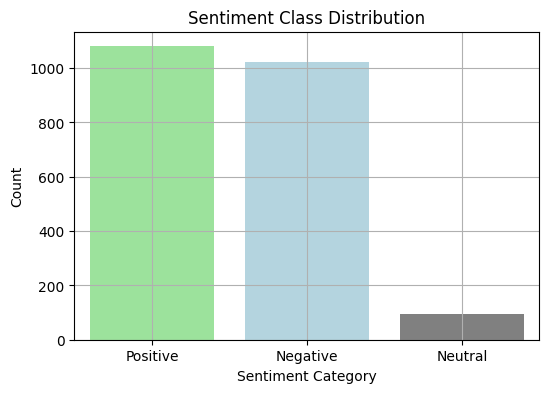

In [ ]:
df["sentiment_category"] = df["sentiment_score"].apply(
    lambda x: "Negative" if x < 0 else ("Positive" if x > 0 else "Neutral")
)

plt.figure(figsize=(6, 4))
sns.countplot(x="sentiment_category", data=df, palette={"Negative": "lightblue", "Neutral": "gray", "Positive": "lightgreen"})
plt.title("Sentiment Class Distribution")
plt.xlabel("Sentiment Category")
plt.ylabel("Count")
plt.grid()
plt.show()


<ipython-input-53-72eb9eec5560>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x=df["sentiment_category"], y=df["acoustic_0"], palette="coolwarm")


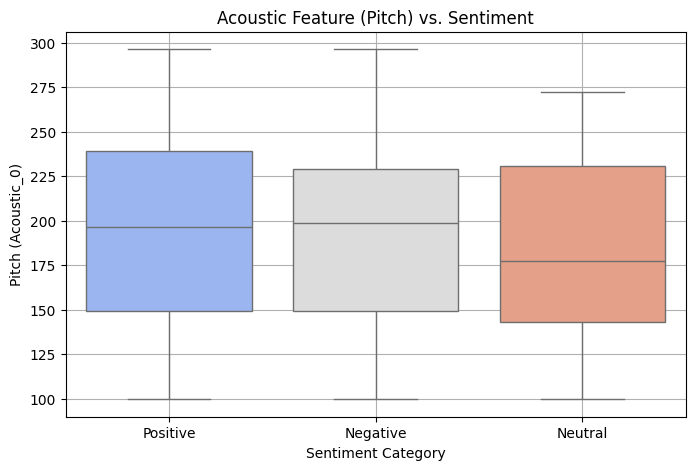

In [ ]:
plt.figure(figsize=(8, 5))
sns.boxplot(x=df["sentiment_category"], y=df["acoustic_0"], palette="coolwarm")
plt.title("Acoustic Feature (Pitch) vs. Sentiment")
plt.xlabel("Sentiment Category")
plt.ylabel("Pitch (Acoustic_0)")
plt.grid()
plt.show()

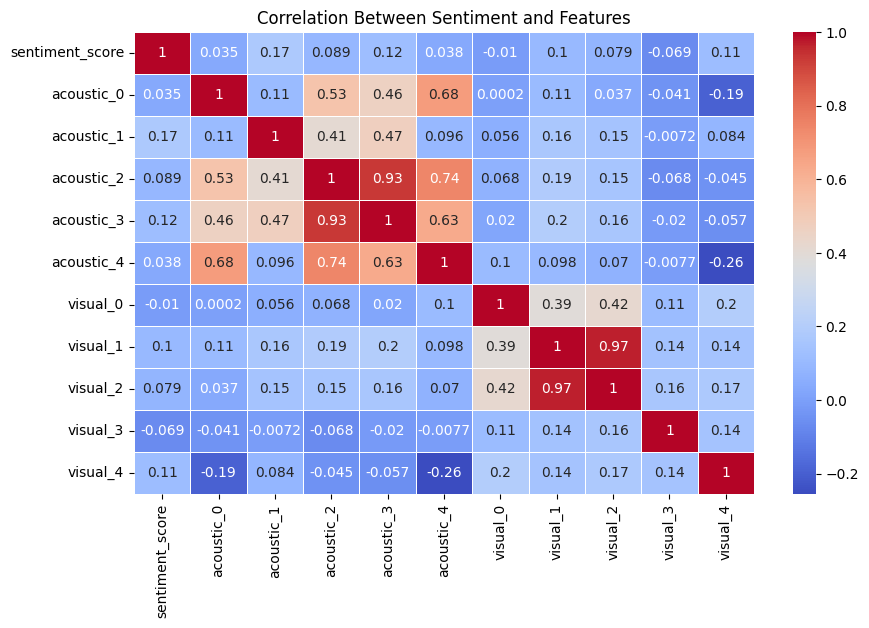

In [ ]:
correlation_matrix = df[["sentiment_score"] + [f"acoustic_{i}" for i in range(5)] + [f"visual_{i}" for i in range(5)]].corr()

plt.figure(figsize=(10, 6))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", linewidths=0.5)
plt.title("Correlation Between Sentiment and Features")
plt.show()


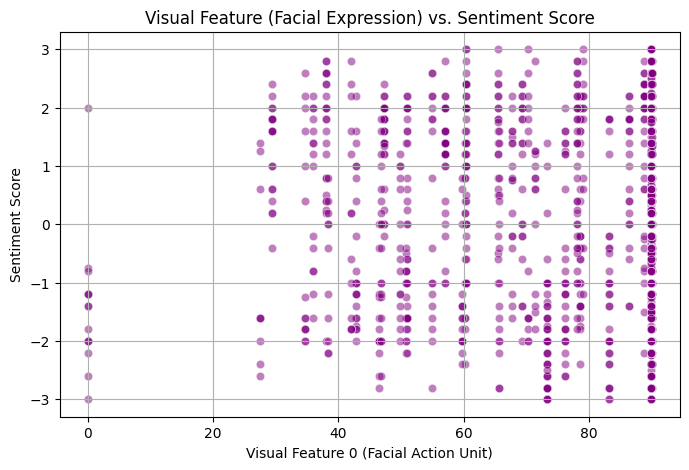

In [ ]:
plt.figure(figsize=(8, 5))
sns.scatterplot(x=df["visual_0"], y=df["sentiment_score"], alpha=0.5, color="purple")
plt.title("Visual Feature (Facial Expression) vs. Sentiment Score")
plt.xlabel("Visual Feature 0 (Facial Action Unit)")
plt.ylabel("Sentiment Score")
plt.grid()
plt.show()

# Mileston 2

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip uninstall -y numpy transformers gensim
!pip install numpy==1.26.4
!pip install transformers==4.39.3
!pip install gensim==4.3.2


Found existing installation: numpy 1.24.3
Uninstalling numpy-1.24.3:
  Successfully uninstalled numpy-1.24.3
Found existing installation: transformers 4.50.3
Uninstalling transformers-4.50.3:
  Successfully uninstalled transformers-4.50.3
Found existing installation: gensim 4.3.1
Uninstalling gensim-4.3.1:
  Successfully uninstalled gensim-4.3.1
  Using cached numpy-1.26.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (61 kB)
Using cached numpy-1.26.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (18.3 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
sentence-transformers 3.4.1 requires transformers<5.0.0,>=4.41.0, which is not installed.
peft 0.14.0 requires transformers, which is not installed.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.26.4 which is incompatible.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.7/26.7 MB 13.3 MB/s eta 0:00:00
^C


In [ ]:
!pip install gensim==4.3.2

  Using cached gensim-4.3.2-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (8.3 kB)
Using cached gensim-4.3.2-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (26.7 MB)


In [ ]:
!pip install numpy==1.23.5 gensim==4.3.1 --force-reinstall --no-cache-dir


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 72.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.6/26.6 MB 92.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.6/37.6 MB 85.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.7/61.7 kB 141.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.2/83.2 kB 147.7 MB/s eta 0:00:00
  Attempting uninstall: wrapt
    Found existing installation: wrapt 1.17.2
    Uninstalling wrapt-1.17.2:
      Successfully uninstalled wrapt-1.17.2
  Attempting uninstall: numpy
    Found existing installation: numpy 1.23.5
    Uninstalling numpy-1.23.5:
      Successfully uninstalled numpy-1.23.5
  Attempting uninstall: smart-open
    Found existing installation: smart-open 7.1.0
    Uninstalling smart-open-7.1.0:
      Successfully uninstalled smart-open-7.1.0
  Attempting uninstall: scipy
    Found existing inst

In [ ]:
!python -m spacy download en_core_web_lg


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.7/400.7 MB 1.3 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_lg')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.


## Advaced Preprocessing

### Text Feature Engineering

In [ ]:
import spacy
from textblob import TextBlob
import os
import pandas as pd
import numpy as np
from tqdm import tqdm  # For progress bar

# Load spaCy for NER and word vectors (en_core_web_lg has word vectors)
nlp = spacy.load("en_core_web_lg")

def extract_text_features_spacy(text):
    # Sentiment features
    blob = TextBlob(text)
    polarity = blob.sentiment.polarity
    subjectivity = blob.sentiment.subjectivity

    # NER
    doc = nlp(text)
    entities = [ent.text for ent in doc.ents]

    # Tokenize text
    words = text.split()

    # Get word vectors and compute average
    vectors = [token.vector for token in doc if token.has_vector]

    if vectors:
        mean_vector = np.mean(vectors, axis=0)
    else:
        mean_vector = np.zeros(300)  # fallback for empty or OOV text

    return {
        'sentiment_polarity': polarity,
        'sentiment_subjectivity': subjectivity,
        'entities_count': len(entities),
        'word_count': len(words),
        **{f'spacy_{i}': v for i, v in enumerate(mean_vector)}
    }

# Path to .annotprocessed files
transcript_directory = '/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/extracted_files/Transcript/Segmented/'

text_data = []

# Loop through all files and extract features with progress bar
for filename in tqdm(os.listdir(transcript_directory), desc="Processing files"):
    if filename.endswith('.annotprocessed'):
        file_path = os.path.join(transcript_directory, filename)
        with open(file_path, 'r') as f:
            lines = f.readlines()  # Read all lines in the file

            # Process each line individually
            for line in lines:
                line = line.strip()  # Remove any leading/trailing spaces
                if line:  # Avoid processing empty lines
                    features = extract_text_features_spacy(line)
                    features['filename'] = filename
                    features['line_text'] = line  # Store the line text as well
                    text_data.append(features)

# Convert to DataFrame
df_spacy = pd.DataFrame(text_data)

# Save to CSV
output_csv = '/content/drive/MyDrive/CMU_MOSI_Project/text_features_spacy_per_line.csv'
df_spacy.to_csv(output_csv, index=False)

print(f"Text features with spaCy saved at {output_csv}")


Processing files: 100%|██████████| 93/93 [00:36<00:00,  2.56it/s]


Text features with spaCy saved at /content/drive/MyDrive/CMU_MOSI_Project/text_features_spacy_per_line.csv


In [ ]:
df_spacy

,sentiment_polarity,sentiment_subjectivity,entities_count,word_count,spacy_0,spacy_1,spacy_2,spacy_3,spacy_4,spacy_5,...,spacy_292,spacy_293,spacy_294,spacy_295,spacy_296,spacy_297,spacy_298,spacy_299,filename,line_text
0,0.000000,0.000000,0,10,-0.010450,0.053228,-0.150323,-0.122595,0.064218,0.040025,...,0.011060,-0.102905,-0.008914,0.008080,-0.161977,-0.097590,0.049753,0.067465,0h-zjBukYpk.annotprocessed,1_DELIM_NOW THE TITLE OF THE MOVIE BASICALLY S...
1,-0.181250,0.625000,2,29,-0.037657,0.114718,-0.185996,-0.064820,0.038202,0.068260,...,0.013330,-0.151557,0.061108,0.093715,-0.044989,0.002026,0.049489,0.167619,0h-zjBukYpk.annotprocessed,2_DELIM_NOW IM NOT EVEN GONNA SUGAR COAT THIS ...
2,0.250000,0.500000,2,7,-0.037373,0.221875,-0.107747,0.009926,0.034125,0.074247,...,-0.199292,-0.077722,0.257174,-0.061410,0.226191,-0.413923,-0.005412,0.155584,0h-zjBukYpk.annotprocessed,3_DELIM_MY REASON IM A COMIC BOOK FAN
3,0.225000,0.525000,1,9,-0.192217,0.024996,-0.182062,-0.055508,-0.079970,0.126358,...,-0.198294,0.137931,-0.020982,-0.090773,0.017288,-0.230190,0.147833,0.070956,0h-zjBukYpk.annotprocessed,4_DELIM_THAT LIKE TO SEE COMIC BOOK CHARACTERS...
4,0.166667,0.666667,1,19,0.015418,0.133975,-0.190212,-0.100991,0.040757,0.010985,...,-0.008458,-0.062390,0.105619,-0.115358,-0.083945,-0.053253,0.114639,0.118311,0h-zjBukYpk.annotprocessed,5_DELIM_ THAT HUH BEFORE WE GO ON WITH THAT I ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2194,0.438889,0.683333,0,13,0.028323,-0.036606,-0.267204,0.044070,0.085719,0.040104,...,0.025852,-0.112756,0.008564,0.161623,-0.075764,0.009096,0.001972,0.154471,yDtzw_Y-7RU.annotprocessed,20_DELIM_EXCEPT THEIR EYES ARE KIND OF LIKE TH...
2195,0.000000,0.000000,2,12,-0.115638,0.262316,-0.189991,0.018785,0.182133,-0.131783,...,0.075228,-0.106250,0.098577,-0.023317,-0.138626,-0.151423,-0.010235,0.236798,yDtzw_Y-7RU.annotprocessed,21_DELIM_AND THATS A LOT TO BE SAID FOR A ONE ...
2196,0.000000,0.100000,1,5,0.050463,0.008066,-0.144680,-0.053724,0.143360,0.249695,...,0.000510,-0.034288,0.018530,0.119804,-0.126798,-0.107480,0.095903,0.220212,yDtzw_Y-7RU.annotprocessed,22_DELIM_I ACTUALLY LIKE THE FILM
2197,0.500000,0.700000,1,10,0.053316,0.162400,-0.240009,-0.155021,0.137705,0.100788,...,-0.152075,-0.085548,0.153621,-0.034847,-0.083438,-0.127465,0.085170,0.102822,yDtzw_Y-7RU.annotprocessed,23_DELIM_UM I ENJOYED MYSELF IN IT YOU MIGHT A...


In [ ]:
!pip install librosa numpy pandas


### Audio Feature Engineering

In [ ]:
import librosa
import numpy as np
import os
import pandas as pd

# Function to extract audio features
def extract_audio_features(audio_path):
    # Load audio file
    y, sr = librosa.load(audio_path, sr=None)  # `sr=None` keeps the original sampling rate

    # Extract features
    mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=33)  # MFCC features
    chroma = librosa.feature.chroma_stft(y=y, sr=sr)  # Chroma feature
    spectral_contrast = librosa.feature.spectral_contrast(y=y, sr=sr)  # Spectral contrast
    zcr = librosa.feature.zero_crossing_rate(y=y)  # Zero crossing rate
    rmse = librosa.feature.rms(y=y)  # Root mean square energy

    # Aggregate features (mean of each feature over time)
    mfcc_mean = np.mean(mfcc, axis=1)
    chroma_mean = np.mean(chroma, axis=1)
    spectral_contrast_mean = np.mean(spectral_contrast, axis=1)
    zcr_mean = np.mean(zcr, axis=1)
    rmse_mean = np.mean(rmse, axis=1)

    # Return extracted features as a dictionary
    features = {
        **{f'mfcc_mean_{i}': mfcc[i].mean() for i in range(mfcc.shape[0])},
        **{f'mfcc_std_{i}': mfcc[i].std() for i in range(mfcc.shape[0])},
        **{f'chroma_mean_{i}': chroma[i].mean() for i in range(chroma.shape[0])},
        **{f'spectral_contrast_mean_{i}': spectral_contrast[i].mean() for i in range(spectral_contrast.shape[0])},
        'zcr': zcr_mean,
        'rmse': rmse_mean
    }

    return features

# Directory containing audio files
audio_directory = '/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/extracted_files/Audio/WAV_16000/Segmented/'
# List to store extracted features
audio_data = []

# Loop through audio files in the directory and extract features
for filename in os.listdir(audio_directory):
    if filename.endswith('.wav'):  # Process only .wav files
        file_path = os.path.join(audio_directory, filename)
        audio_features = extract_audio_features(file_path)
        audio_features['filename'] = filename  # Add filename to the features
        audio_data.append(audio_features)

# Convert extracted features to a DataFrame
df_audio_features = pd.DataFrame(audio_data)

# Save to CSV
output_csv_audio = '/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/audio_features.csv'
df_audio_features.to_csv(output_csv_audio, index=False)

print(f"Audio features saved at {output_csv_audio}")


Audio features saved at /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/audio_features.csv


In [ ]:
df_audio_features

,mfcc,chroma,spectral_contrast,zcr,rmse,filename
0,"[-154.03206, 80.59041, -14.012939, 59.06457, -...","[0.29068923, 0.28928983, 0.3149345, 0.30760095...","[12.975280555331544, 16.047215564575716, 18.76...",[0.17203776041666666],[0.06508436],VbQk4H8hgr0_16.wav
1,"[-156.16177, 81.37537, -9.620962, 56.059982, -...","[0.25861642, 0.21979833, 0.3613162, 0.427536, ...","[15.996626089373914, 16.290547820425413, 19.40...",[0.15739152238175674],[0.078079894],VbQk4H8hgr0_20.wav
2,"[-146.7901, 78.77423, -20.646976, 61.147198, -...","[0.23871814, 0.22352962, 0.25430763, 0.2912121...","[14.885400530296701, 16.232971008307256, 19.43...",[0.1943088107638889],[0.06997402],VbQk4H8hgr0_21.wav
3,"[-143.32599, 75.32385, -7.119049, 57.17192, -1...","[0.33017904, 0.26621118, 0.3794658, 0.41313356...","[14.767279825833745, 14.792926993238133, 18.30...",[0.203857421875],[0.075250454],VbQk4H8hgr0_22.wav
4,"[-171.927, 78.03664, -4.734558, 54.246956, -14...","[0.3178159, 0.30511603, 0.43532744, 0.39525, 0...","[14.380079660947198, 15.328074275923308, 18.40...",[0.14969576322115385],[0.060475692],VbQk4H8hgr0_24.wav
...,...,...,...,...,...,...
2194,"[-469.8215, 90.30063, 16.311592, 7.9407887, -4...","[0.15679628, 0.11811089, 0.09873714, 0.0640530...","[23.7713301920052, 20.36374163524792, 22.79330...",[0.14774445564516128],[0.01447692],5W7Z1C_fDaE_3.wav
2195,"[-388.98947, 103.75839, -42.24687, 10.256707, ...","[0.46020067, 0.33432057, 0.111248046, 0.043996...","[25.122943213302776, 20.654952476306377, 22.74...",[0.10673384232954546],[0.019925764],5W7Z1C_fDaE_6.wav
2196,"[-425.5567, 114.16761, -39.90248, 20.508698, -...","[0.2953132, 0.20228674, 0.20356765, 0.20799103...","[27.457667105102303, 24.130654330397842, 23.99...",[0.07489372702205882],[0.018952811],5W7Z1C_fDaE_8.wav
2197,"[-417.66135, 77.47472, -6.746536, 0.58581483, ...","[0.34965122, 0.21594761, 0.13608384, 0.1091912...","[22.459570980742633, 19.982071872865124, 23.38...",[0.18074392158294392],[0.01941278],5W7Z1C_fDaE_7.wav


### Audio Feature (Denoise)

In [ ]:
pip install noisereduce

In [ ]:
import noisereduce as nr
import librosa
import numpy as np
import os
import pandas as pd
from tqdm import tqdm

def extract_audio_features_denoised(audio_path):
    y, sr = librosa.load(audio_path, sr=None)

    # Noise reduction using entire clip
    y_denoised = nr.reduce_noise(y=y, sr=sr)

    # Extract features
    mfcc = librosa.feature.mfcc(y=y_denoised, sr=sr, n_mfcc=30)
    chroma = librosa.feature.chroma_stft(y=y_denoised, sr=sr)
    spectral_contrast = librosa.feature.spectral_contrast(y=y_denoised, sr=sr)
    zcr = librosa.feature.zero_crossing_rate(y=y_denoised)
    rmse = librosa.feature.rms(y=y_denoised)

    # Aggregate features
    features = {
        **{f'mfcc_mean_{i}': mfcc[i].mean() for i in range(mfcc.shape[0])},
        **{f'mfcc_std_{i}': mfcc[i].std() for i in range(mfcc.shape[0])},
        **{f'chroma_mean_{i}': chroma[i].mean() for i in range(6)},  # first 6
        **{f'spectral_contrast_mean_{i}': spectral_contrast[i].mean() for i in range(4)},  # first 4
        'zcr_mean': zcr.mean(),
        'zcr_std': zcr.std(),
        'rmse_mean': rmse.mean(),
        'rmse_std': rmse.std()
    }

    return features

# Path to audio files
audio_directory = '/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/extracted_files/Audio/WAV_16000/Segmented/'
audio_data = []

# Process all .wav files
for filename in tqdm(os.listdir(audio_directory), desc="Extracting audio features"):
    if filename.endswith('.wav'):
        file_path = os.path.join(audio_directory, filename)
        features = extract_audio_features_denoised(file_path)
        features['filename'] = filename
        audio_data.append(features)

# Save to DataFrame and CSV
df_audio_features = pd.DataFrame(audio_data)
output_csv_audio = '/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/audio_features_denoised.csv'
df_audio_features.to_csv(output_csv_audio, index=False)

print(f" Audio features (denoised) saved at: {output_csv_audio}")
print(f"Total columns: {df_audio_features.shape[1]} (Expected: 75 including filename)")


Extracting audio features: 100%|██████████| 2199/2199 [05:31<00:00,  6.64it/s]


 Audio features (denoised) saved at: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/audio_features_denoised.csv
Total columns: 75 (Expected: 75 including filename)


In [ ]:
# Save to DataFrame and CSV
df_audio_features = pd.DataFrame(audio_data)
output_csv_audio = '/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/audio_features_denoised.csv'
df_audio_features.to_csv(output_csv_audio, index=False)

print(f" Audio features (denoised) saved at: {output_csv_audio}")
print(f"Total columns: {df_audio_features.shape[1]} (Expected: 75 including filename)")
df_audio_features

 Audio features (denoised) saved at: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/audio_features_denoised.csv
Total columns: 75 (Expected: 75 including filename)


,mfcc_mean_0,mfcc_mean_1,mfcc_mean_2,mfcc_mean_3,mfcc_mean_4,mfcc_mean_5,mfcc_mean_6,mfcc_mean_7,mfcc_mean_8,mfcc_mean_9,...,chroma_mean_5,spectral_contrast_mean_0,spectral_contrast_mean_1,spectral_contrast_mean_2,spectral_contrast_mean_3,zcr_mean,zcr_std,rmse_mean,rmse_std,filename
0,-368.137512,65.312027,8.414616,59.446018,-10.238630,17.207108,-3.689290,-9.175271,10.881575,-8.911885,...,0.327772,14.902082,17.752057,22.818848,25.280845,0.231877,0.103541,0.026351,0.017169,VbQk4H8hgr0_16.wav
1,-458.275421,66.943047,3.780416,43.172554,-23.739630,18.569164,-11.373702,-18.715820,15.040833,-7.623674,...,0.332969,18.480768,18.031468,25.702639,23.681400,0.249087,0.181963,0.022273,0.015761,VbQk4H8hgr0_20.wav
2,-293.174835,80.080849,-2.411047,61.026779,-28.378195,26.575228,4.672551,-13.356315,19.134981,-10.373248,...,0.386203,15.843279,16.497577,21.545796,20.907860,0.213840,0.113513,0.033271,0.015137,VbQk4H8hgr0_21.wav
3,-389.410370,79.099594,15.747735,55.930645,-22.554308,23.088963,1.625898,-15.683707,16.054348,-13.007686,...,0.424506,16.144428,15.739976,23.013927,24.206939,0.238253,0.168131,0.031686,0.018466,VbQk4H8hgr0_22.wav
4,-397.494659,75.038589,25.555111,52.337879,-6.054044,25.725826,-1.815432,-6.775278,10.897857,-8.344961,...,0.368964,15.356684,17.114870,23.121178,21.897414,0.176733,0.108852,0.026393,0.022979,VbQk4H8hgr0_24.wav
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2194,-562.557190,75.053017,28.841749,13.735650,-29.237995,-16.813492,-21.427092,-15.076041,-7.123239,-25.863083,...,0.123703,24.757855,21.010831,22.996361,27.113886,0.155714,0.141049,0.009191,0.007293,5W7Z1C_fDaE_3.wav
2195,-504.859589,85.900719,-28.553150,13.463282,-42.224945,-14.107276,-26.544167,-16.979195,-4.044556,-25.876801,...,0.160891,28.596634,20.923848,24.551265,25.115358,0.129783,0.072799,0.009320,0.005973,5W7Z1C_fDaE_6.wav
2196,-527.921143,94.336113,-24.386885,33.129059,-40.188290,-11.886528,-30.035145,-20.803583,0.432368,-26.267471,...,0.067516,29.211393,25.369907,25.932413,26.201665,0.091064,0.054735,0.009635,0.003422,5W7Z1C_fDaE_8.wav
2197,-563.997742,31.422041,8.683523,2.975022,-10.600202,-14.795151,-19.236210,-14.739199,-13.160266,-13.074912,...,0.185973,25.252181,21.213085,29.052702,28.935789,0.215467,0.203807,0.006558,0.009929,5W7Z1C_fDaE_7.wav


### Video Feature Engineering

In [ ]:
!pip install deepface

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 3.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.6/108.6 kB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.0/85.0 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 30.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 44.3 MB/s eta 0:00:00
  Created wheel for fire: filename=fire-0.7.0-py3-none-any.whl size=114249 sha256=3433c4170e49cabb5b5b92f8f3202e4d881579b65d0c4a496652fc79ec73c489
  Stored in directory: /root/.cache/pip/wheels/46/54/24/1624fd5b8674eb1188623f7e8e17cdf7c0f6c24b609dfb8a89
Successfully built fire


In [ ]:
!pip install mediapipe

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.6/35.6 MB 19.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 59.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.6/294.6 kB 16.6 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 5.29.4
    Uninstalling protobuf-5.29.4:
      Successfully uninstalled protobuf-5.29.4
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
grpcio-status 1.71.0 requires protobuf<6.0dev,>=5.26.1, but you have protobuf 4.25.6 which is incompatible.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.26.4 which is incompatib

In [ ]:
!pip install opencv-python pandas mediapipe torch torchvision tqdm
# Download OpenFace binary: https://github.com/TadasBaltrusaitis/OpenFace/releases

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 47.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 52.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 34.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 49.4 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlink

In [ ]:
import cv2
import os
import pandas as pd
import numpy as np
import torch
from torchvision import models, transforms
import mediapipe as mp
from tqdm import tqdm

# Initialize MediaPipe Pose
mp_pose = mp.solutions.pose
pose = mp_pose.Pose(static_image_mode=False, min_detection_confidence=0.5)

# VGG-Face (Deep Features)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = models.vgg16(pretrained=True).to(device).eval()  # Use GPU if available
preprocess = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Paths
video_directory = '/content/gdrive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/extracted_files/Video/Segmented'
output_dir = '/content/gdrive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset'
os.makedirs(output_dir, exist_ok=True)

# List of video files (we'll sample them)
video_files = [f for f in os.listdir(video_directory) if f.endswith('.mp4')]

# Function to extract body pose landmarks using MediaPipe Pose
def extract_mediapipe_features(frame):
    """Extract body pose landmarks (33 points)"""
    results = pose.process(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    if results.pose_landmarks:
        return np.array([[lmk.x, lmk.y, lmk.z] for lmk in results.pose_landmarks.landmark]).flatten()
    return np.zeros(33*3)  # Default if no pose detected

# Function to extract deep features using VGG16
def extract_vgg_features(frame):
    """Extract 4096D VGG-Face embeddings"""
    img_tensor = preprocess(frame).unsqueeze(0).to(device)
    with torch.no_grad():
        features = model(img_tensor).cpu().numpy().flatten()
    return features[:100]  # Use first 100 dims for demo (adjust as needed)

# Function to calculate optical flow between two frames
def extract_optical_flow(prev_frame, curr_frame):
    """Dense optical flow (Farneback method)"""
    prev_gray = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)
    curr_gray = cv2.cvtColor(curr_frame, cv2.COLOR_BGR2GRAY)
    flow = cv2.calcOpticalFlowFarneback(prev_gray, curr_gray, None, 0.5, 3, 15, 3, 5, 1.2, 0)
    return flow.mean(axis=(0, 1))  # Return mean flow (2D vector)

# Function to extract all features from a video
def extract_all_features(video_file, sample_rate=10):
    video_path = os.path.join(video_directory, video_file)
    cap = cv2.VideoCapture(video_path)
    features = {
        'video_file': video_file,
        'frame_count': int(cap.get(cv2.CAP_PROP_FRAME_COUNT)),
        'fps': cap.get(cv2.CAP_PROP_FPS)
    }

    # Initialize feature lists
    mediapipe_feats, vgg_feats, flow_feats = [], [], []
    prev_frame = None
    sampled_frames = 0

    # Process frames of the video, sampling every `sample_rate` frame
    while True:
        success, frame = cap.read()
        if not success:
            break

        # Sample every `sample_rate` frames to speed up processing
        if sampled_frames % sample_rate == 0:
            # Extract MediaPipe Pose features
            mediapipe_feats.append(extract_mediapipe_features(frame))
            # Extract VGG deep features
            vgg_feats.append(extract_vgg_features(frame))
            # Optical flow between consecutive frames
            if prev_frame is not None:
                flow_feats.append(extract_optical_flow(prev_frame, frame))

        prev_frame = frame
        sampled_frames += 1

    cap.release()

    # Aggregate features
    features.update({
        'body_pose_mean': np.mean(mediapipe_feats, axis=0).tolist() if mediapipe_feats else [],
        'vgg_features_mean': np.mean(vgg_feats, axis=0).tolist() if vgg_feats else [],
        'optical_flow_mean': np.mean(flow_feats, axis=0).tolist() if flow_feats else []
    })

    return features

# Run feature extraction on all video files (sampling every 10th frame, process a subset of videos)
all_features = []
sample_video_files = video_files[:94]  # Process only first 50 videos for testing
for video_file in tqdm(sample_video_files):  # No limit, processing sampled subset of videos
    features = extract_all_features(video_file, sample_rate=10)  # Adjust sample rate as needed
    all_features.append(features)

# Save to CSV
df = pd.DataFrame(all_features)
csv_path = os.path.join(output_dir, 'VIDEO_features.csv')
df.to_csv(csv_path, index=False)
print(f"Features saved to {csv_path}")


100%|██████████| 94/94 [20:53<00:00, 13.34s/it]

Features saved to /content/gdrive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/VIDEO_features.csv


In [ ]:
# prompt: display video fetaures .csv

import pandas as pd
df = pd.read_csv('/content/gdrive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/VIDEO_features.csv')
df


,video_file,frame_count,fps,body_pose_mean,vgg_features_mean,optical_flow_mean
0,03bSnISJMiM_1.mp4,100,30.0,"[0.6492946445941925, 0.5762682318687439, -1.82...","[1.9940418004989624, 1.1363003253936768, 3.832...","[0.2441388964653015, -0.03610118106007576]"
1,03bSnISJMiM_10.mp4,47,30.0,"[0.5997925639152527, 0.5476373910903931, -1.53...","[1.1842321157455444, 0.13537713885307312, 2.97...","[-0.15552595257759094, 0.06696005910634995]"
2,03bSnISJMiM_11.mp4,65,30.0,"[0.5707015565463475, 0.5481675522668021, -1.55...","[1.1037499904632568, 0.17472505569458008, 3.37...","[0.30793526768684387, -0.10457544773817062]"
3,03bSnISJMiM_12.mp4,81,30.0,"[0.5973416434393989, 0.49706149763531154, -1.5...","[2.291630744934082, 0.6570932865142822, 3.8859...","[0.12044588476419449, -0.0463530458509922]"
4,03bSnISJMiM_13.mp4,51,30.0,"[0.6464153329531351, 0.5083340605099996, -1.86...","[1.686360239982605, 1.2170337438583374, 3.8725...","[-0.006136411335319281, -0.0010027959942817688]"
...,...,...,...,...,...,...
89,2WGyTLYerpo_16.mp4,69,30.0,"[0.33286585978099276, 0.22337020933628082, -1....","[2.350593090057373, 0.3572724759578705, 0.4673...","[-0.03129582479596138, -0.03390403464436531]"
90,2WGyTLYerpo_17.mp4,73,30.0,"[0.35773662477731705, 0.2273651883006096, -1.0...","[1.8789724111557007, -0.10807101428508759, 0.3...","[0.026863325387239456, -0.005972377955913544]"
91,2WGyTLYerpo_18.mp4,39,30.0,"[0.3820780888199806, 0.23934833332896233, -1.0...","[1.7989470958709717, -0.41036751866340637, 0.3...","[0.07829165458679199, 0.06715889275074005]"
92,2WGyTLYerpo_19.mp4,146,30.0,"[0.4125426113605499, 0.22667780717213948, -1.0...","[1.9477286338806152, -0.5152394771575928, 0.54...","[0.05467431619763374, 0.08490061014890671]"


In [ ]:
import pandas as pd

# Load individual CSV files
text_df = pd.read_csv('/content/gdrive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/text_features.csv')
audio_df = pd.read_csv('/content/gdrive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/audio_features.csv')
video_df = pd.read_csv('/content/gdrive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/VIDEO_features.csv')

# Concatenate the DataFrames
# This assumes that the rows in each DataFrame are in the same order and correspond to the same entities (e.g., videos)
combined_df = pd.concat([text_df, audio_df, video_df], axis=1)

# Save the combined DataFrame to a CSV file
combined_csv_path = '/content/gdrive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Unpreprocessed_features.csv'
combined_df.to_csv(combined_csv_path, index=False)

print(f"Combined CSV saved to {combined_csv_path}")


Combined CSV saved to /content/gdrive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Unpreprocessed_features.csv


In [ ]:
import pandas as pd

# Load the unprocessed dataset
df = pd.read_csv('/content/gdrive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Unpreprocessed_features.csv')

# Define a function to map sentiment values to categorical labels
def map_sentiment_to_label(sentiment_value):
    if sentiment_value < 0.33:
        return 'negative'
    elif sentiment_value > 0.66:
        return 'positive'
    else:
        return 'neutral'

# Apply the function to create a new column 'sentiment_category'
df['sentiment_category'] = df['sentiment'].apply(map_sentiment_to_label)

# Save the dataset with added labels
labeled_csv_path = '/content/gdrive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Unprocessed_featureswithlabels.csv'
df.to_csv(labeled_csv_path, index=False)
print(f"Labeled dataset saved to {labeled_csv_path}")

# Display the first few rows to check the added labels
df.head()


Labeled dataset saved to /content/gdrive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Unprocessed_featureswithlabels.csv


,sentiment,entities_count,word_count,filename,mfcc_mean,mfcc_std,spectral_centroid_mean,spectral_centroid_std,zcr_mean,zcr_std,filename.1,video_file,frame_count,fps,body_pose_mean,vgg_features_mean,optical_flow_mean,sentiment_category
0,0.155758,10.0,106.0,03bSnISJMiM.annotprocessed,-45.390010,171.71178,1322.091772,482.123734,0.092336,0.044400,03bSnISJMiM_1.wav,03bSnISJMiM_1.mp4,100.0,30.0,"[0.6492946445941925, 0.5762682318687439, -1.82...","[1.9940418004989624, 1.1363003253936768, 3.832...","[0.2441388964653015, -0.03610118106007576]",negative
1,0.197972,27.0,311.0,0h-zjBukYpk.annotprocessed,-44.820095,164.08460,2073.270901,1218.163436,0.202057,0.154076,03bSnISJMiM_10.wav,03bSnISJMiM_10.mp4,47.0,30.0,"[0.5997925639152527, 0.5476373910903931, -1.53...","[1.1842321157455444, 0.13537713885307312, 2.97...","[-0.15552595257759094, 0.06696005910634995]",negative
2,0.229464,12.0,146.0,1DmNV9C1hbY.annotprocessed,-46.584824,167.62010,2337.667177,1408.489054,0.246898,0.185495,03bSnISJMiM_11.wav,03bSnISJMiM_11.mp4,65.0,30.0,"[0.5707015565463475, 0.5481675522668021, -1.55...","[1.1037499904632568, 0.17472505569458008, 3.37...","[0.30793526768684387, -0.10457544773817062]",negative
3,0.156968,29.0,404.0,1iG0909rllw.annotprocessed,-46.878212,171.15244,1727.173212,1144.501777,0.150368,0.128177,03bSnISJMiM_12.wav,03bSnISJMiM_12.mp4,81.0,30.0,"[0.5973416434393989, 0.49706149763531154, -1.5...","[2.291630744934082, 0.6570932865142822, 3.8859...","[0.12044588476419449, -0.0463530458509922]",negative
4,0.247481,60.0,561.0,2WGyTLYerpo.annotprocessed,-42.642536,157.21040,1502.070433,877.552238,0.111319,0.086311,03bSnISJMiM_13.wav,03bSnISJMiM_13.mp4,51.0,30.0,"[0.6464153329531351, 0.5083340605099996, -1.86...","[1.686360239982605, 1.2170337438583374, 3.8725...","[-0.006136411335319281, -0.0010027959942817688]",negative


## Loading and saving dataset

In [ ]:
import pandas as pd

# Define the path to your CSV file
csv_path = '/content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_Features.csv'

# Load the CSV into a DataFrame
df = pd.read_csv(csv_path)

# Preview the first few rows of the DataFrame
df.head()

,video_id,start_time,end_time,sentiment_score,acoustic_0,acoustic_1,acoustic_2,acoustic_3,acoustic_4,acoustic_5,...,text_290,text_291,text_292,text_293,text_294,text_295,text_296,text_297,text_298,text_299
0,03bSnISJMiM,51.904533,55.945350,2.40,231.98268,0.518543,0.10173,0.312767,4.735631,0.26167,...,-0.028237,-0.007658,-0.129621,-0.089237,0.061532,0.106335,-0.066678,-0.036917,-0.048457,0.117718
1,03bSnISJMiM,56.045124,66.780720,-0.80,231.98268,0.518543,0.10173,0.312767,4.735631,0.26167,...,-0.028237,-0.007658,-0.129621,-0.089237,0.061532,0.106335,-0.066678,-0.036917,-0.048457,0.117718
2,03bSnISJMiM,66.780720,68.736280,-1.00,231.98268,0.518543,0.10173,0.312767,4.735631,0.26167,...,-0.028237,-0.007658,-0.129621,-0.089237,0.061532,0.106335,-0.066678,-0.036917,-0.048457,0.117718
3,03bSnISJMiM,68.736280,70.542175,-1.75,231.98268,0.518543,0.10173,0.312767,4.735631,0.26167,...,-0.028237,-0.007658,-0.129621,-0.089237,0.061532,0.106335,-0.066678,-0.036917,-0.048457,0.117718
4,03bSnISJMiM,70.542175,71.699550,0.00,231.98268,0.518543,0.10173,0.312767,4.735631,0.26167,...,-0.028237,-0.007658,-0.129621,-0.089237,0.061532,0.106335,-0.066678,-0.036917,-0.048457,0.117718


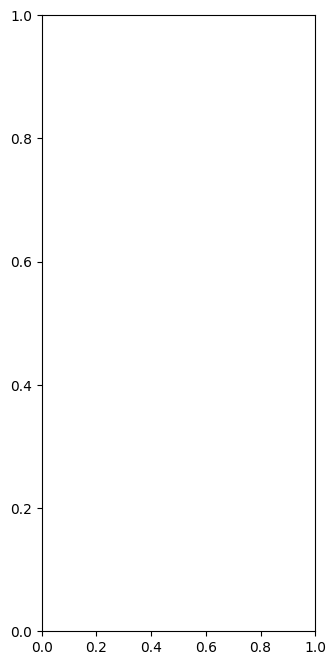

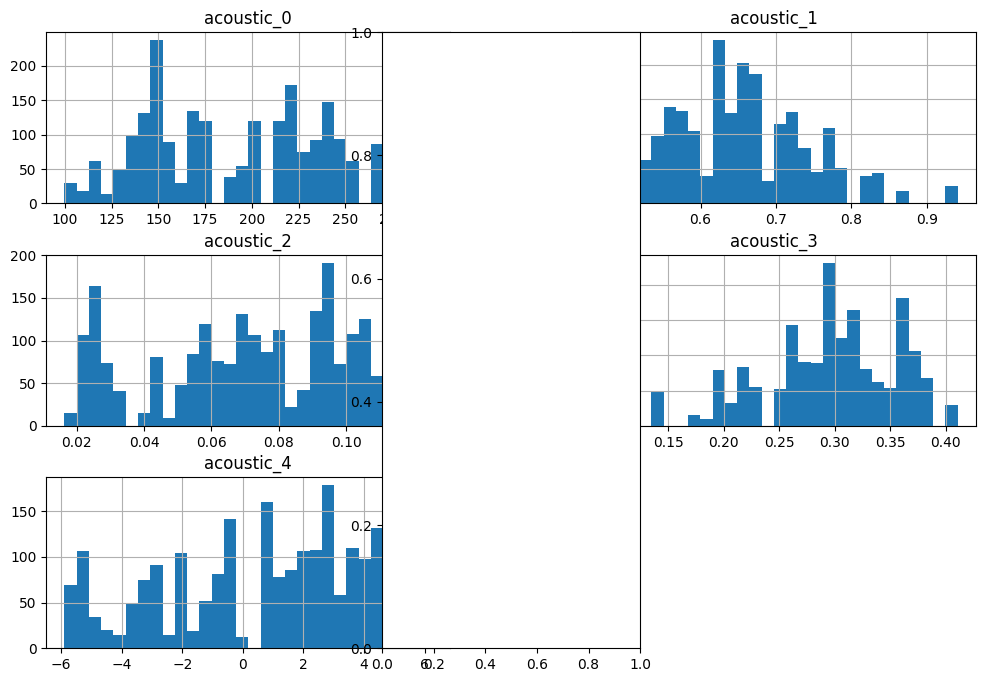

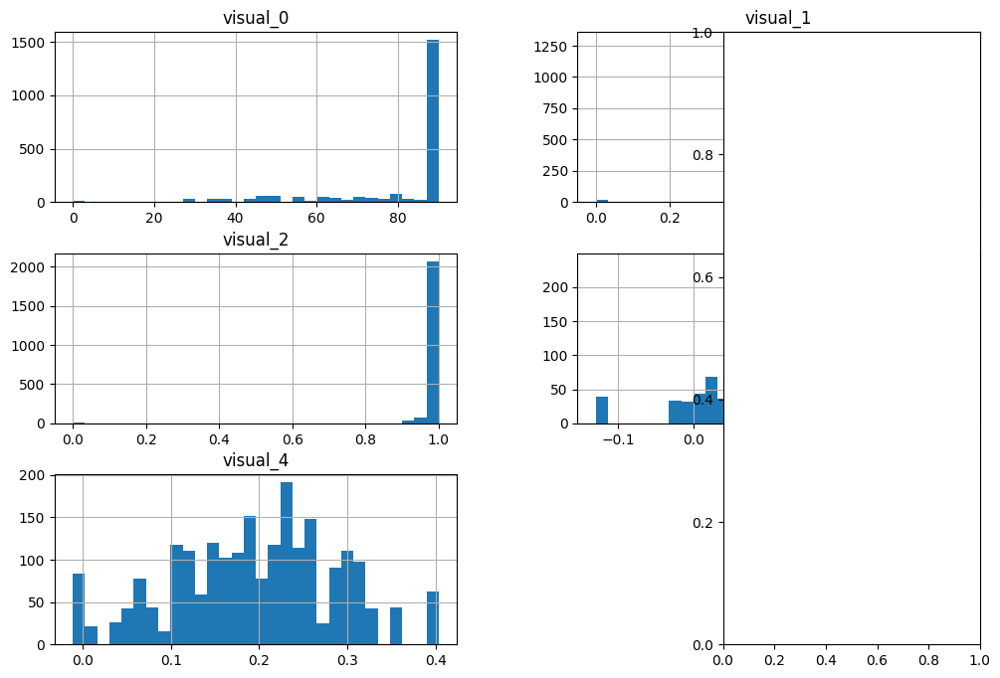

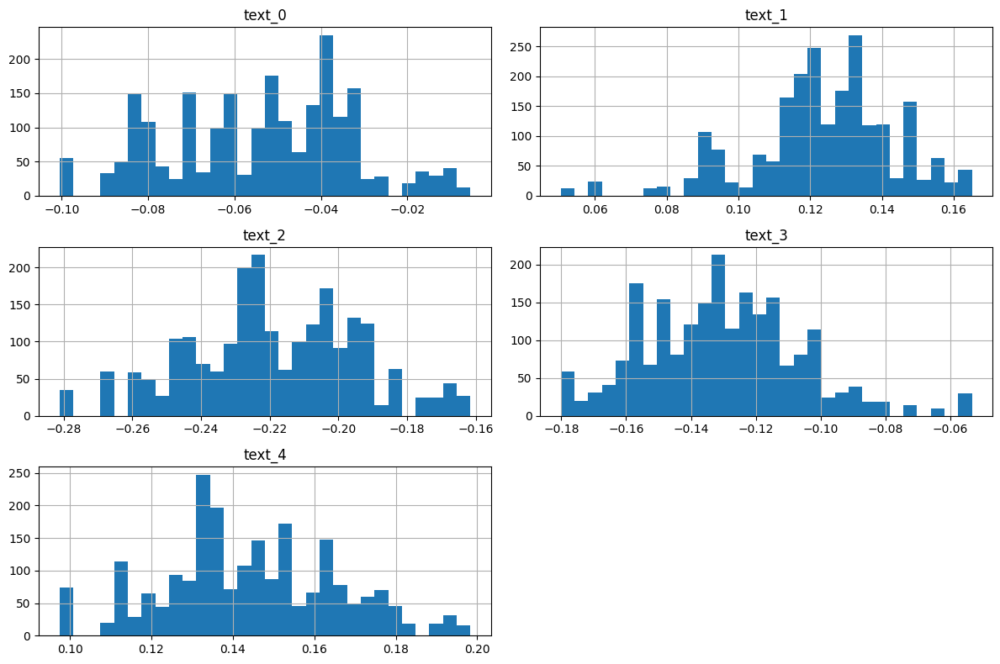

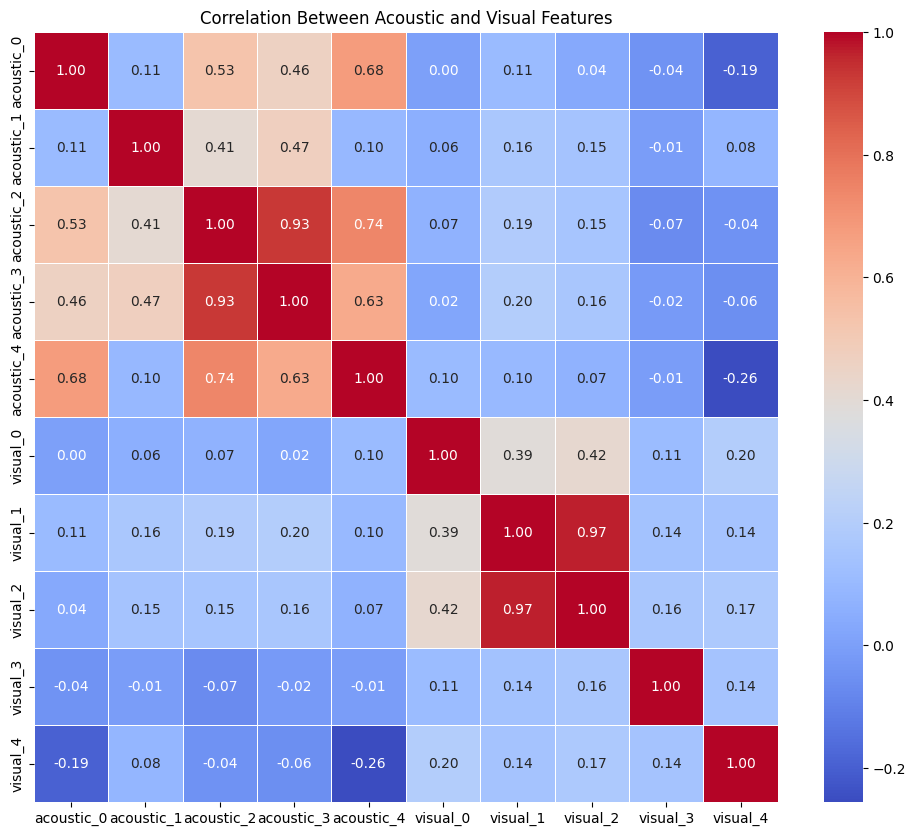

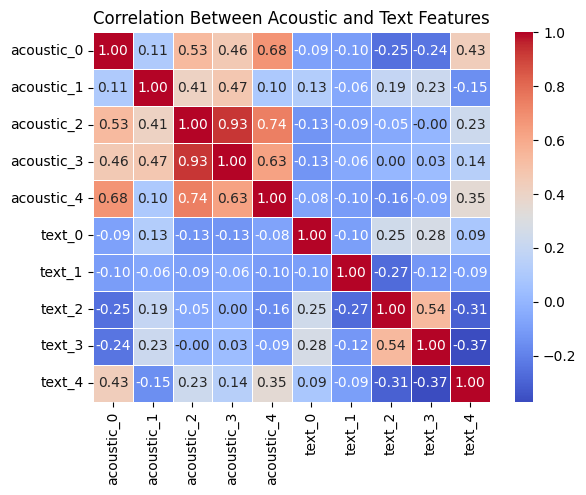

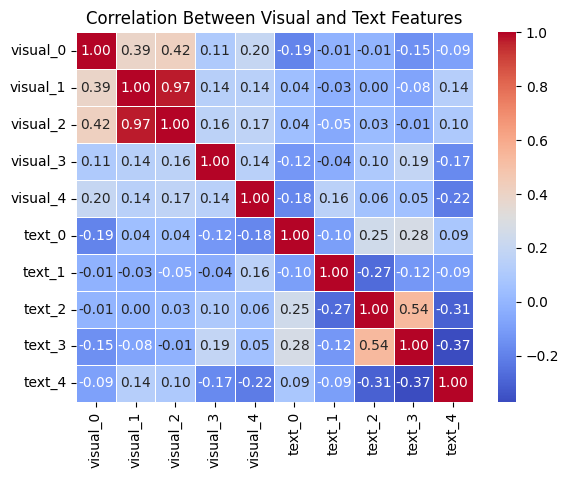

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Check the columns to identify the acoustic, visual, and text features
acoustic_columns = [col for col in df.columns if 'acoustic' in col]
visual_columns = [col for col in df.columns if 'visual' in col]
text_columns = [col for col in df.columns if 'text' in col]

# Limit the number of columns to display for each feature type
acoustic_columns_subset = acoustic_columns[:5]  # Display first 5 acoustic features
visual_columns_subset = visual_columns[:5]      # Display first 5 visual features
text_columns_subset = text_columns[:5]          # Display first 5 text features

# Visualize distributions for each feature type (Acoustic, Visual, Text)
plt.figure(figsize=(12, 8))

# Acoustic Features Distribution
plt.subplot(1, 3, 1)
df[acoustic_columns_subset].hist(bins=30, figsize=(12, 8))
plt.title('Acoustic Features Distribution')

# Visual Features Distribution
plt.subplot(1, 3, 2)
df[visual_columns_subset].hist(bins=30, figsize=(12, 8))
plt.title('Visual Features Distribution')

# Text Features Distribution (Embeddings are usually normalized already)
plt.subplot(1, 3, 3)
df[text_columns_subset].hist(bins=30, figsize=(12, 8))
plt.title('Text Features Distribution')

plt.tight_layout()
plt.show()

# Check correlations for different feature types
plt.figure(figsize=(12, 10))

# Acoustic-Visual Correlation
sns.heatmap(df[acoustic_columns_subset + visual_columns_subset].corr(), annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Between Acoustic and Visual Features')
plt.show()

# Acoustic-Text Correlation
sns.heatmap(df[acoustic_columns_subset + text_columns_subset].corr(), annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Between Acoustic and Text Features')
plt.show()

# Visual-Text Correlation
sns.heatmap(df[visual_columns_subset + text_columns_subset].corr(), annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Between Visual and Text Features')
plt.show()


In [ ]:
# Display first few rows of the dataset
print(df.head())

# Get general info about the dataset
print(df.info())

# Check for missing values
print(df.isnull().sum())


      video_id  start_time   end_time  sentiment_score  acoustic_0  \
0  03bSnISJMiM   51.904533  55.945350             2.40   231.98268   
1  03bSnISJMiM   56.045124  66.780720            -0.80   231.98268   
2  03bSnISJMiM   66.780720  68.736280            -1.00   231.98268   
3  03bSnISJMiM   68.736280  70.542175            -1.75   231.98268   
4  03bSnISJMiM   70.542175  71.699550             0.00   231.98268   

   acoustic_1  acoustic_2  acoustic_3  acoustic_4  acoustic_5  ...  text_290  \
0    0.518543     0.10173    0.312767    4.735631     0.26167  ... -0.028237   
1    0.518543     0.10173    0.312767    4.735631     0.26167  ... -0.028237   
2    0.518543     0.10173    0.312767    4.735631     0.26167  ... -0.028237   
3    0.518543     0.10173    0.312767    4.735631     0.26167  ... -0.028237   
4    0.518543     0.10173    0.312767    4.735631     0.26167  ... -0.028237   

   text_291  text_292  text_293  text_294  text_295  text_296  text_297  \
0 -0.007658 -0.129621 -

In [ ]:
from sklearn.preprocessing import StandardScaler

# Identify text columns dynamically
text_columns = [col for col in df.columns if 'text_' in col]

# Normalize text features
scaler = StandardScaler()
df[text_columns] = scaler.fit_transform(df[text_columns])
df[text_columns]

,text_0,text_1,text_2,text_3,text_4,text_5,text_6,text_7,text_8,text_9,...,text_290,text_291,text_292,text_293,text_294,text_295,text_296,text_297,text_298,text_299
0,-1.298050,-0.549646,-1.370254,1.218029,1.391578,-0.386995,-0.811134,0.384876,-1.300425,-0.414673,...,1.603632,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136
1,-1.298050,-0.549646,-1.370254,1.218029,1.391578,-0.386995,-0.811134,0.384876,-1.300425,-0.414673,...,1.603632,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136
2,-1.298050,-0.549646,-1.370254,1.218029,1.391578,-0.386995,-0.811134,0.384876,-1.300425,-0.414673,...,1.603632,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136
3,-1.298050,-0.549646,-1.370254,1.218029,1.391578,-0.386995,-0.811134,0.384876,-1.300425,-0.414673,...,1.603632,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136
4,-1.298050,-0.549646,-1.370254,1.218029,1.391578,-0.386995,-0.811134,0.384876,-1.300425,-0.414673,...,1.603632,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2194,-0.441704,1.272700,-2.490831,-1.326660,0.662835,1.228787,2.371779,-0.839636,-0.358491,-0.697758,...,0.246276,-0.711583,-1.811318,-1.532370,2.314333,0.546902,-1.726666,-1.239136,1.310215,2.265009
2195,-0.441704,1.272700,-2.490831,-1.326660,0.662835,1.228787,2.371779,-0.839636,-0.358491,-0.697758,...,0.246276,-0.711583,-1.811318,-1.532370,2.314333,0.546902,-1.726666,-1.239136,1.310215,2.265009
2196,-0.441704,1.272700,-2.490831,-1.326660,0.662835,1.228787,2.371779,-0.839636,-0.358491,-0.697758,...,0.246276,-0.711583,-1.811318,-1.532370,2.314333,0.546902,-1.726666,-1.239136,1.310215,2.265009
2197,-0.441704,1.272700,-2.490831,-1.326660,0.662835,1.228787,2.371779,-0.839636,-0.358491,-0.697758,...,0.246276,-0.711583,-1.811318,-1.532370,2.314333,0.546902,-1.726666,-1.239136,1.310215,2.265009


In [ ]:
# Identify audio columns dynamically
audio_columns = [col for col in df.columns if 'acoustic_' in col]

# Replace '-inf' values with NaN, then impute with the mean
df.replace(-float('inf'), float('nan'), inplace=True)
df[audio_columns] = df[audio_columns].fillna(df[audio_columns].mean())  # Impute NaN with mean values

# Normalize audio features
scaler = StandardScaler()
df[audio_columns] = scaler.fit_transform(df[audio_columns])
df[audio_columns]

,acoustic_0,acoustic_1,acoustic_2,acoustic_3,acoustic_4,acoustic_5,acoustic_6,acoustic_7,acoustic_8,acoustic_9,...,acoustic_64,acoustic_65,acoustic_66,acoustic_67,acoustic_68,acoustic_69,acoustic_70,acoustic_71,acoustic_72,acoustic_73
0,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,0.965336,0.0,-0.015875,0.462737,...,-0.266785,-0.343101,-0.262892,0.132358,-0.008173,0.089821,0.159742,0.250812,0.341341,0.407887
1,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,0.965336,0.0,-0.015875,0.462737,...,-0.266785,-0.343101,-0.262892,0.132358,-0.008173,0.089821,0.159742,0.250812,0.341341,0.407887
2,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,0.965336,0.0,-0.015875,0.462737,...,-0.266785,-0.343101,-0.262892,0.132358,-0.008173,0.089821,0.159742,0.250812,0.341341,0.407887
3,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,0.965336,0.0,-0.015875,0.462737,...,-0.266785,-0.343101,-0.262892,0.132358,-0.008173,0.089821,0.159742,0.250812,0.341341,0.407887
4,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,0.965336,0.0,-0.015875,0.462737,...,-0.266785,-0.343101,-0.262892,0.132358,-0.008173,0.089821,0.159742,0.250812,0.341341,0.407887
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2194,0.372724,0.221524,1.577788,1.148331,1.447326,-0.231606,1.652935,0.0,1.179069,-0.134594,...,-0.208193,-0.583271,-1.375076,-0.350900,0.117931,0.323209,0.343751,0.250337,0.286589,0.449153
2195,0.372724,0.221524,1.577788,1.148331,1.447326,-0.231606,1.652935,0.0,1.179069,-0.134594,...,-0.208193,-0.583271,-1.375076,-0.350900,0.117931,0.323209,0.343751,0.250337,0.286589,0.449153
2196,0.372724,0.221524,1.577788,1.148331,1.447326,-0.231606,1.652935,0.0,1.179069,-0.134594,...,-0.208193,-0.583271,-1.375076,-0.350900,0.117931,0.323209,0.343751,0.250337,0.286589,0.449153
2197,0.372724,0.221524,1.577788,1.148331,1.447326,-0.231606,1.652935,0.0,1.179069,-0.134594,...,-0.208193,-0.583271,-1.375076,-0.350900,0.117931,0.323209,0.343751,0.250337,0.286589,0.449153


In [ ]:
# Identify visual columns dynamically
visual_columns = [col for col in df.columns if 'visual_' in col]

# Replace '-inf' values with NaN, then impute with the mean
df.replace(-float('inf'), float('nan'), inplace=True)
df[visual_columns] = df[visual_columns].fillna(df[visual_columns].mean())  # Impute NaN with mean values

# Normalize visual features
scaler = StandardScaler()
df[visual_columns] = scaler.fit_transform(df[visual_columns])
df[visual_columns]

,visual_0,visual_1,visual_2,visual_3,visual_4,visual_5,visual_6,visual_7,visual_8,visual_9,...,visual_420,visual_421,visual_422,visual_423,visual_424,visual_425,visual_426,visual_427,visual_428,visual_429
0,0.552778,-0.671401,0.059419,-1.566936,-0.186458,-0.283856,-1.232765,-0.284878,0.008426,0.915900,...,-0.633155,-0.933692,0.160304,0.950844,0.337143,-1.015661,0.529632,0.745168,0.027211,0.126354
1,0.552778,-0.671401,0.059419,-1.566936,-0.186458,-0.283856,-1.232765,-0.284878,0.008426,0.915900,...,-0.633155,-0.933692,0.160304,0.950844,0.337143,-1.015661,0.529632,0.745168,0.027211,0.126354
2,0.552778,-0.671401,0.059419,-1.566936,-0.186458,-0.283856,-1.232765,-0.284878,0.008426,0.915900,...,-0.633155,-0.933692,0.160304,0.950844,0.337143,-1.015661,0.529632,0.745168,0.027211,0.126354
3,0.552778,-0.671401,0.059419,-1.566936,-0.186458,-0.283856,-1.232765,-0.284878,0.008426,0.915900,...,-0.633155,-0.933692,0.160304,0.950844,0.337143,-1.015661,0.529632,0.745168,0.027211,0.126354
4,0.552778,-0.671401,0.059419,-1.566936,-0.186458,-0.283856,-1.232765,-0.284878,0.008426,0.915900,...,-0.633155,-0.933692,0.160304,0.950844,0.337143,-1.015661,0.529632,0.745168,0.027211,0.126354
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2194,0.550880,-0.224353,0.130846,-1.362157,-0.298160,-0.385700,-0.905891,-0.704858,-0.224351,1.193657,...,-0.489506,-0.901695,-0.818802,0.309828,0.855982,-0.811547,0.075054,0.301930,0.264761,-1.470535
2195,0.550880,-0.224353,0.130846,-1.362157,-0.298160,-0.385700,-0.905891,-0.704858,-0.224351,1.193657,...,-0.489506,-0.901695,-0.818802,0.309828,0.855982,-0.811547,0.075054,0.301930,0.264761,-1.470535
2196,0.550880,-0.224353,0.130846,-1.362157,-0.298160,-0.385700,-0.905891,-0.704858,-0.224351,1.193657,...,-0.489506,-0.901695,-0.818802,0.309828,0.855982,-0.811547,0.075054,0.301930,0.264761,-1.470535
2197,0.550880,-0.224353,0.130846,-1.362157,-0.298160,-0.385700,-0.905891,-0.704858,-0.224351,1.193657,...,-0.489506,-0.901695,-0.818802,0.309828,0.855982,-0.811547,0.075054,0.301930,0.264761,-1.470535


In [ ]:
# Define the sentiment_to_label function
def sentiment_to_label(score):
    if score > 0:
        return 1  # Positive
    elif score < 0:
        return -1  # Negative
    else:
        return 0  # Neutral

# Apply the function to the 'sentiment_score' column to generate a new 'sentiment_label' column
sentiment_labels = df['sentiment_score'].apply(sentiment_to_label)

# Concatenate the new 'sentiment_label' column with the original dataframe
df = pd.concat([df, sentiment_labels.rename('sentiment_label')], axis=1)


In [ ]:
df

,video_id,start_time,end_time,sentiment_score,acoustic_0,acoustic_1,acoustic_2,acoustic_3,acoustic_4,acoustic_5,...,text_291,text_292,text_293,text_294,text_295,text_296,text_297,text_298,text_299,sentiment_label
0,03bSnISJMiM,51.904533,55.945350,2.40,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,...,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136,1
1,03bSnISJMiM,56.045124,66.780720,-0.80,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,...,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136,-1
2,03bSnISJMiM,66.780720,68.736280,-1.00,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,...,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136,-1
3,03bSnISJMiM,68.736280,70.542175,-1.75,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,...,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136,-1
4,03bSnISJMiM,70.542175,71.699550,0.00,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,...,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2194,zhpQhgha_KU,130.007030,136.921310,-1.00,0.372724,0.221524,1.577788,1.148331,1.447326,-0.231606,...,-0.711583,-1.811318,-1.532370,2.314333,0.546902,-1.726666,-1.239136,1.310215,2.265009,-1
2195,zhpQhgha_KU,136.921310,143.007480,0.80,0.372724,0.221524,1.577788,1.148331,1.447326,-0.231606,...,-0.711583,-1.811318,-1.532370,2.314333,0.546902,-1.726666,-1.239136,1.310215,2.265009,1
2196,zhpQhgha_KU,143.007480,147.736740,-0.40,0.372724,0.221524,1.577788,1.148331,1.447326,-0.231606,...,-0.711583,-1.811318,-1.532370,2.314333,0.546902,-1.726666,-1.239136,1.310215,2.265009,-1
2197,zhpQhgha_KU,157.594330,159.669620,1.20,0.372724,0.221524,1.577788,1.148331,1.447326,-0.231606,...,-0.711583,-1.811318,-1.532370,2.314333,0.546902,-1.726666,-1.239136,1.310215,2.265009,1


In [ ]:
# 1. Check for missing values in the dataset
print("Checking for missing values:")
print(df.isnull().sum())

# 2. Check for duplicate rows
print("\nChecking for duplicate rows:")
print(df.duplicated().sum())

# 3. Verify data types of all columns to ensure they match expectations
print("\nData types of all columns:")
print(df.dtypes)

# 4. Check distribution of sentiment labels to ensure they are within expected values (-1, 0, 1)
print("\nSentiment label distribution:")
print(df['sentiment_label'].value_counts())

# 5. Basic statistics summary for numerical columns to identify outliers or abnormal values
print("\nBasic statistics for numerical columns:")
print(df.describe())

# 6. Check the range of sentiment scores (assuming they should be between -1 and 1)
print("\nRange of sentiment scores:")
print(df['sentiment_score'].min(), df['sentiment_score'].max())

# 7. Check for any infinite values in the numerical columns (especially relevant for acoustic or visual features)
print("\nChecking for infinite values:")
print((df == float('inf')).sum())
print((df == float('-inf')).sum())


Checking for missing values:
video_id           0
start_time         0
end_time           0
sentiment_score    0
acoustic_0         0
                  ..
text_296           0
text_297           0
text_298           0
text_299           0
sentiment_label    0
Length: 809, dtype: int64

Checking for duplicate rows:
0

Data types of all columns:
video_id            object
start_time         float64
end_time           float64
sentiment_score    float64
acoustic_0         float64
                    ...   
text_296           float64
text_297           float64
text_298           float64
text_299           float64
sentiment_label      int64
Length: 809, dtype: object

Sentiment label distribution:
sentiment_label
 1    1080
-1    1023
 0      96
Name: count, dtype: int64

Basic statistics for numerical columns:
        start_time     end_time  sentiment_score    acoustic_0    acoustic_1  \
count  2199.000000  2199.000000      2199.000000  2.199000e+03  2.199000e+03   
mean     85.601975    8

In [ ]:
combined_df = pd.concat([X_resampled, y_resampled], axis=1)

save_path = '/content/drive/MyDrive/CMU_MOSI_Project/resampledr_data.csv'
combined_df.to_csv(save_path, index=False)


## Model Training and Testing

In [ ]:
from sklearn.model_selection import train_test_split
import pandas as pd

# Path to the saved CSV
file_path = '/content/drive/MyDrive/CMU_MOSI_Project/resampledr_data.csv'

# Load the CSV into a DataFrame
df = pd.read_csv(file_path)

# Split into features and target
X_resampled = df.drop(columns=df.columns[-1])  # All columns except last
y_resampled = df[df.columns[-1]]              # Last column as target

# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)


### Logistic regression

In [ ]:
model_lr = LogisticRegression(max_iter=1000, multi_class='ovr')  # Use 'ovr' (One-vs-Rest)

# Train the model
model_lr.fit(X_train, y_train)

# Predict on the test set
y_pred_lr = model_lr.predict(X_test)

# Evaluate performance
print("Logistic Regression Accuracy:", accuracy_score(y_test, y_pred_lr))
print("Classification Report:\n", classification_report(y_test, y_pred_lr))

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Logistic Regression Accuracy: 0.8580246913580247
Classification Report:
               precision    recall  f1-score   support

          -1       0.90      0.83      0.86       218
           0       0.76      0.86      0.80       197
           1       0.92      0.89      0.91       233

    accuracy                           0.86       648
   macro avg       0.86      0.86      0.86       648
weighted avg       0.86      0.86      0.86       648



/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



Fold 1 Accuracy: 0.8225
              precision    recall  f1-score   support

          -1       0.86      0.79      0.82       216
           0       0.75      0.82      0.78       216
           1       0.87      0.86      0.86       216

    accuracy                           0.82       648
   macro avg       0.83      0.82      0.82       648
weighted avg       0.83      0.82      0.82       648



/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



Fold 2 Accuracy: 0.8534
              precision    recall  f1-score   support

          -1       0.88      0.84      0.86       216
           0       0.79      0.89      0.84       216
           1       0.90      0.83      0.86       216

    accuracy                           0.85       648
   macro avg       0.86      0.85      0.85       648
weighted avg       0.86      0.85      0.85       648



/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



Fold 3 Accuracy: 0.8349
              precision    recall  f1-score   support

          -1       0.89      0.83      0.86       216
           0       0.76      0.82      0.79       216
           1       0.87      0.85      0.86       216

    accuracy                           0.83       648
   macro avg       0.84      0.83      0.84       648
weighted avg       0.84      0.83      0.84       648



/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



Fold 4 Accuracy: 0.8549
              precision    recall  f1-score   support

          -1       0.90      0.84      0.87       216
           0       0.78      0.86      0.82       216
           1       0.89      0.87      0.88       216

    accuracy                           0.85       648
   macro avg       0.86      0.85      0.86       648
weighted avg       0.86      0.85      0.86       648



/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



Fold 5 Accuracy: 0.8611
              precision    recall  f1-score   support

          -1       0.85      0.89      0.87       216
           0       0.82      0.86      0.84       216
           1       0.92      0.84      0.88       216

    accuracy                           0.86       648
   macro avg       0.86      0.86      0.86       648
weighted avg       0.86      0.86      0.86       648



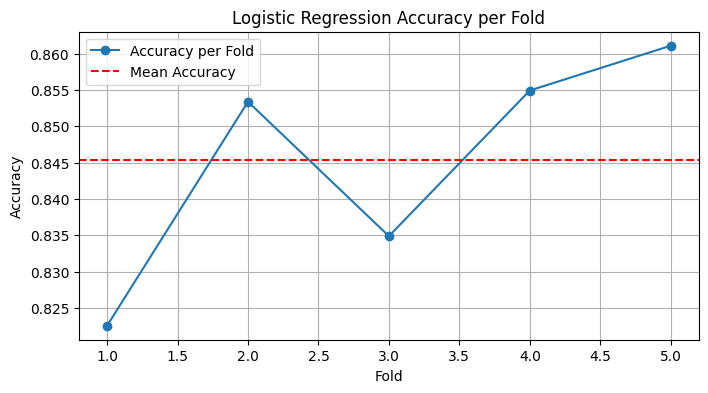

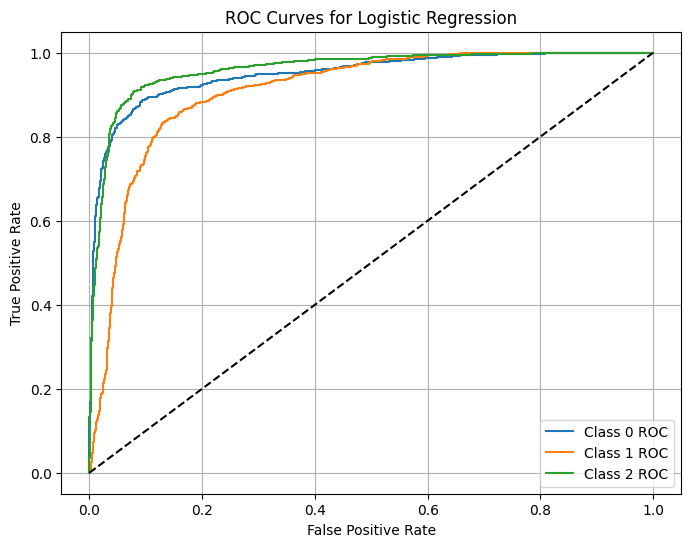

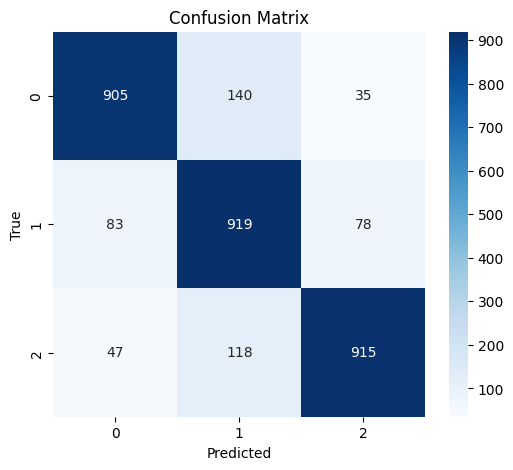

Model saved to: /content/drive/MyDrive/CMU_MOSI_Project/logistic_regression_model.joblib


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score, classification_report, roc_auc_score, roc_curve, confusion_matrix
from sklearn.preprocessing import label_binarize
from joblib import dump
import os

# Initialize model
model_lr = LogisticRegression(max_iter=1000, multi_class='ovr')

# Set up Stratified K-Fold Cross-Validation
kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
acc_scores = []
roc_scores = []
all_y_test = []
all_y_pred = []
all_y_proba = []
fold = 1

for train_idx, test_idx in kf.split(X, y):
    X_train_cv, X_test_cv = X.iloc[train_idx], X.iloc[test_idx]
    y_train_cv, y_test_cv = y.iloc[train_idx], y.iloc[test_idx]

    model_lr.fit(X_train_cv, y_train_cv)

    y_pred = model_lr.predict(X_test_cv)
    y_proba = model_lr.predict_proba(X_test_cv)

    acc = accuracy_score(y_test_cv, y_pred)
    acc_scores.append(acc)

    y_test_bin = label_binarize(y_test_cv, classes=np.unique(y))
    roc_auc = roc_auc_score(y_test_bin, y_proba, average='macro', multi_class='ovr')
    roc_scores.append(roc_auc)

    all_y_test.extend(y_test_cv)
    all_y_pred.extend(y_pred)
    all_y_proba.extend(y_proba)

    print(f"\nFold {fold} Accuracy: {acc:.4f}")
    print(classification_report(y_test_cv, y_pred))
    fold += 1

# Plot Accuracy per Fold
plt.figure(figsize=(8, 4))
plt.plot(range(1, 6), acc_scores, marker='o', label='Accuracy per Fold')
plt.axhline(np.mean(acc_scores), color='r', linestyle='--', label='Mean Accuracy')
plt.title("Logistic Regression Accuracy per Fold")
plt.xlabel("Fold")
plt.ylabel("Accuracy")
plt.legend()
plt.grid(True)
plt.show()

# ROC Curve
fpr = dict()
tpr = dict()
n_classes = len(np.unique(y))
y_test_bin_all = label_binarize(all_y_test, classes=np.unique(y))
all_y_proba = np.array(all_y_proba)

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin_all[:, i], all_y_proba[:, i])

plt.figure(figsize=(8, 6))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Class {i} ROC')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curves for Logistic Regression")
plt.legend()
plt.grid(True)
plt.show()

# Confusion Matrix
cm = confusion_matrix(all_y_test, all_y_pred)
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

# Save model
os.makedirs('/content/drive/MyDrive/CMU_MOSI_Project', exist_ok=True)
model_path = '/content/drive/MyDrive/CMU_MOSI_Project/logistic_regression_model.joblib'
dump(model_lr, model_path)
print(f"Model saved to: {model_path}")


### Random forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report

# Initialize Random Forest model
model_rf = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the model
model_rf.fit(X_train, y_train)

# Predict on the test set
y_pred_rf = model_rf.predict(X_test)

# Evaluate performance
print("Random Forest Accuracy:", accuracy_score(y_test, y_pred_rf))
print("Classification Report:\n", classification_report(y_test, y_pred_rf))


Random Forest Accuracy: 0.970679012345679
Classification Report:
               precision    recall  f1-score   support

          -1       0.95      0.97      0.96       218
           0       0.97      0.97      0.97       197
           1       0.99      0.97      0.98       233

    accuracy                           0.97       648
   macro avg       0.97      0.97      0.97       648
weighted avg       0.97      0.97      0.97       648




Fold 1 Accuracy: 0.9444
              precision    recall  f1-score   support

          -1       0.95      0.94      0.94       216
           0       0.94      0.94      0.94       216
           1       0.94      0.95      0.94       216

    accuracy                           0.94       648
   macro avg       0.94      0.94      0.94       648
weighted avg       0.94      0.94      0.94       648


Fold 2 Accuracy: 0.9475
              precision    recall  f1-score   support

          -1       0.93      0.95      0.94       216
           0       0.97      0.94      0.95       216
           1       0.94      0.95      0.95       216

    accuracy                           0.95       648
   macro avg       0.95      0.95      0.95       648
weighted avg       0.95      0.95      0.95       648


Fold 3 Accuracy: 0.9475
              precision    recall  f1-score   support

          -1       0.95      0.95      0.95       216
           0       0.94      0.96      0.95       216


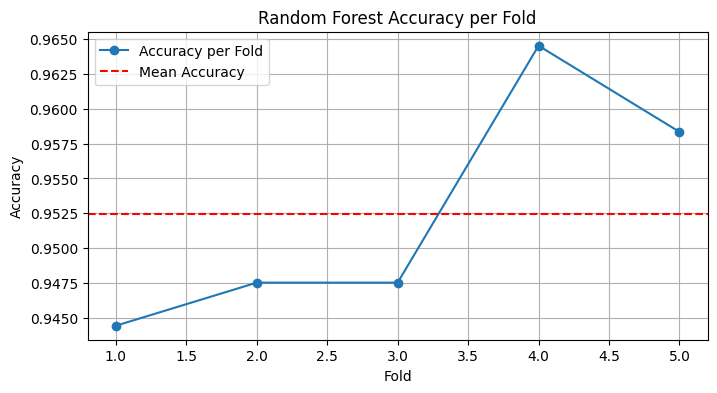

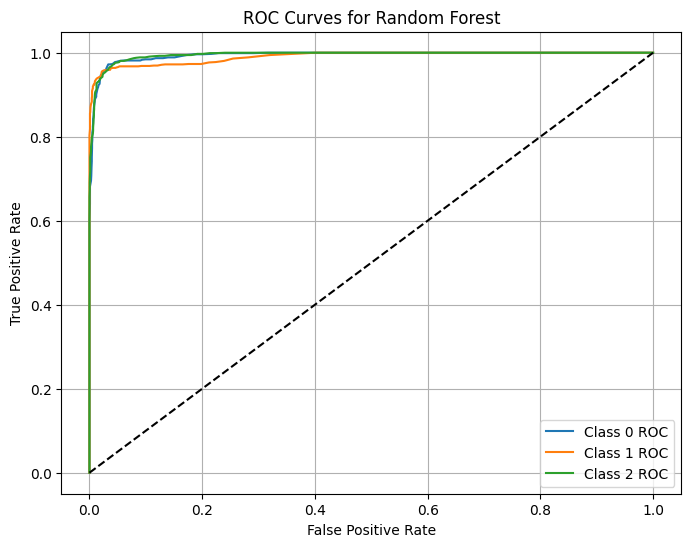

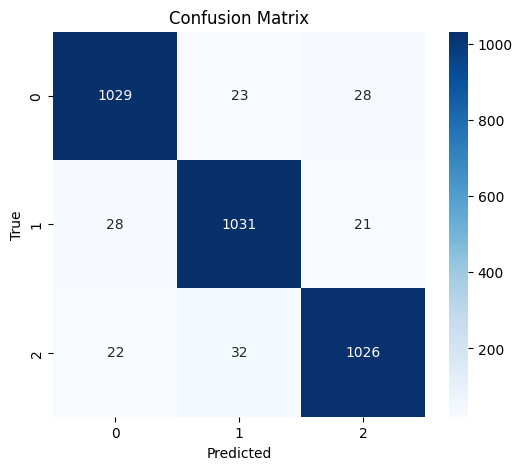

Model saved to: /content/drive/MyDrive/CMU_MOSI_Project/random_forest_model.joblib


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import (
    accuracy_score, classification_report, roc_auc_score,
    roc_curve, confusion_matrix
)
from sklearn.preprocessing import label_binarize
from joblib import dump
import os

# Load resampled data
df = pd.read_csv('/content/drive/MyDrive/CMU_MOSI_Project/resampledr_data.csv')
X = df.drop(columns=df.columns[-1])
y = df[df.columns[-1]]

# Train/Test Split (optional - for final testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Set up K-Fold Cross-Validation
kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
fold = 1
acc_scores = []
roc_scores = []
all_y_test = []
all_y_pred = []
all_y_proba = []

for train_idx, test_idx in kf.split(X, y):
    X_train_cv, X_test_cv = X.iloc[train_idx], X.iloc[test_idx]
    y_train_cv, y_test_cv = y.iloc[train_idx], y.iloc[test_idx]

    model_rf = RandomForestClassifier(n_estimators=100, random_state=42)
    model_rf.fit(X_train_cv, y_train_cv)

    y_pred = model_rf.predict(X_test_cv)
    y_proba = model_rf.predict_proba(X_test_cv)

    acc = accuracy_score(y_test_cv, y_pred)
    acc_scores.append(acc)

    # ROC AUC
    y_test_bin = label_binarize(y_test_cv, classes=np.unique(y))
    roc_auc = roc_auc_score(y_test_bin, y_proba, average='macro', multi_class='ovr')
    roc_scores.append(roc_auc)

    all_y_test.extend(y_test_cv)
    all_y_pred.extend(y_pred)
    all_y_proba.extend(y_proba)

    print(f"\nFold {fold} Accuracy: {acc:.4f}")
    print(classification_report(y_test_cv, y_pred))
    fold += 1

# Save metrics to CSV
metrics_df = pd.DataFrame({
    'Fold': list(range(1, 6)),
    'Accuracy': acc_scores,
    'ROC_AUC': roc_scores
})
metrics_csv_path = '/content/drive/MyDrive/CMU_MOSI_Project/rf_cv_metrics.csv'
metrics_df.to_csv(metrics_csv_path, index=False)
print(f"Metrics saved to {metrics_csv_path}")

# Accuracy per Fold
plt.figure(figsize=(8, 4))
plt.plot(range(1, 6), acc_scores, marker='o', label='Accuracy per Fold')
plt.axhline(np.mean(acc_scores), color='r', linestyle='--', label='Mean Accuracy')
plt.title("Random Forest Accuracy per Fold")
plt.xlabel("Fold")
plt.ylabel("Accuracy")
plt.legend()
plt.grid(True)
plt.show()

# ROC Curve (macro-averaged)
fpr = dict()
tpr = dict()
n_classes = np.unique(y).shape[0]
y_test_bin_all = label_binarize(all_y_test, classes=np.unique(y))
all_y_proba = np.array(all_y_proba)

plt.figure(figsize=(8, 6))
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin_all[:, i], all_y_proba[:, i])
    plt.plot(fpr[i], tpr[i], label=f'Class {i} ROC')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curves for Random Forest")
plt.legend()
plt.grid(True)
plt.show()

# Confusion Matrix
cm = confusion_matrix(all_y_test, all_y_pred)
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel("Predicted")
plt.ylabel("True")
plt.title("Confusion Matrix")
plt.show()

# Save model
os.makedirs('/content/drive/MyDrive/CMU_MOSI_Project', exist_ok=True)
model_path = '/content/drive/MyDrive/CMU_MOSI_Project/random_forest_model.joblib'
dump(model_rf, model_path)
print(f"Model saved to: {model_path}")


### Deep learning cnn

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split

# Load the dataset
df = pd.read_csv('/content/drive/MyDrive/CMU_MOSI_Project/resampledr_data.csv')

# Assume the label column is named 'label'
y = df['sentiment_label']

# Split features by modality
X_audio = df.iloc[:,3 :74+3]
X_image = df.iloc[:, 77:77+430]
X_text  = df.iloc[:, 507:507+300]

# Optionally concatenate for classical models
X_all = pd.concat([X_audio, X_image, X_text], axis=1)

# Train-test split
X_train_audio, X_test_audio, X_train_image, X_test_image, X_train_text, X_test_text, y_train, y_test = train_test_split(
    X_audio, X_image, X_text, y, test_size=0.2, random_state=42
)


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Concatenate, Dropout

# Input layers for each modality
input_audio = Input(shape=(74,))
input_image = Input(shape=(430,))
input_text = Input(shape=(300,))

# Audio branch
x_audio = Dense(128, activation='relu')(input_audio)
x_audio = Dropout(0.3)(x_audio)

# Image branch
x_image = Dense(256, activation='relu')(input_image)
x_image = Dropout(0.3)(x_image)

# Text branch
x_text = Dense(128, activation='relu')(input_text)
x_text = Dropout(0.3)(x_text)

# Concatenate all modalities
combined = Concatenate()([x_audio, x_image, x_text])
x = Dense(128, activation='relu')(combined)
x = Dropout(0.3)(x)
output = Dense(3, activation='softmax')(x)  # for 3-class classification

# Define the model
model = Model(inputs=[input_audio, input_image, input_text], outputs=output)

# Compile
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
model.summary()


Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3       │ (None, 74)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_4       │ (None, 430)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_5       │ (None, 300)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_26 (Dense)    │ (None, 128)       │      9,600 │ input_layer_3[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_27 (Dense)    │ (None, 256)       │    110,336 │ input_layer_4[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_28 (Dense)    │ (None, 128)       │     38,528 │ input_layer_5[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_30          │ (None, 128)       │          0 │ dense_26[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_31          │ (None, 256)       │          0 │ dense_27[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_32          │ (None, 128)       │          0 │ dense_28[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_3       │ (None, 512)       │          0 │ dropout_30[0][0], │
│ (Concatenate)       │                   │            │ dropout_31[0][0], │
│                     │                   │            │ dropout_32[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_29 (Dense)    │ (None, 128)       │     65,664 │ concatenate_3[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_33          │ (None, 128)       │          0 │ dense_29[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_30 (Dense)    │ (None, 3)         │        387 │ dropout_33[0][0]  │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 224,515 (877.01 KB)

 Trainable params: 224,515 (877.01 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Concatenate, Dropout, BatchNormalization
from tensorflow.keras.regularizers import l2

# Input layers
input_audio = Input(shape=(74,), name='audio_input')
input_image = Input(shape=(430,), name='image_input')
input_text = Input(shape=(300,), name='text_input')

# Audio branch
x_audio = Dense(256, activation='relu', kernel_regularizer=l2(1e-4))(input_audio)
x_audio = BatchNormalization()(x_audio)
x_audio = Dropout(0.4)(x_audio)

x_audio = Dense(128, activation='relu', kernel_regularizer=l2(1e-4))(x_audio)
x_audio = BatchNormalization()(x_audio)
x_audio = Dropout(0.3)(x_audio)

# Image branch
x_image = Dense(512, activation='relu', kernel_regularizer=l2(1e-4))(input_image)
x_image = BatchNormalization()(x_image)
x_image = Dropout(0.4)(x_image)

x_image = Dense(256, activation='relu', kernel_regularizer=l2(1e-4))(x_image)
x_image = BatchNormalization()(x_image)
x_image = Dropout(0.3)(x_image)

# Text branch
x_text = Dense(256, activation='relu', kernel_regularizer=l2(1e-4))(input_text)
x_text = BatchNormalization()(x_text)
x_text = Dropout(0.4)(x_text)

x_text = Dense(128, activation='relu', kernel_regularizer=l2(1e-4))(x_text)
x_text = BatchNormalization()(x_text)
x_text = Dropout(0.3)(x_text)

# Concatenate modalities
combined = Concatenate()([x_audio, x_image, x_text])

# Fully connected layers after fusion
x = Dense(256, activation='relu', kernel_regularizer=l2(1e-4))(combined)
x = BatchNormalization()(x)
x = Dropout(0.4)(x)

x = Dense(128, activation='relu', kernel_regularizer=l2(1e-4))(x)
x = Dropout(0.3)(x)

# Output
output = Dense(3, activation='softmax')(x)

# Build model
model = Model(inputs=[input_audio, input_image, input_text], outputs=output)

# Compile
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

model.summary()


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ audio_input         │ (None, 74)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ image_input         │ (None, 430)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ text_input          │ (None, 300)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_5 (Dense)     │ (None, 256)       │     19,200 │ audio_input[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_7 (Dense)     │ (None, 512)       │    220,672 │ image_input[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_9 (Dense)     │ (None, 256)       │     77,056 │ text_input[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 256)       │      1,024 │ dense_5[0][0]     │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 512)       │      2,048 │ dense_7[0][0]     │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256)       │      1,024 │ dense_9[0][0]     │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_4 (Dropout) │ (None, 256)       │          0 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_6 (Dropout) │ (None, 512)       │          0 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_8 (Dropout) │ (None, 256)       │          0 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_6 (Dense)     │ (None, 128)       │     32,896 │ dropout_4[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_8 (Dense)     │ (None, 256)       │    131,328 │ dropout_6[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_10 (Dense)    │ (None, 128)       │     32,896 │ dropout_8[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128)       │        512 │ dense_6[0][0]     │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256)       │      1,024 │ dense_8[0][0]     │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128)       │        512 │ dense_10[0][0]    │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_5 (Dropout) │ (None, 128)       │          0 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_7 (Dropout) │ (None, 256)       │          0 │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼─────────────────

 Total params: 685,827 (2.62 MB)

 Trainable params: 682,243 (2.60 MB)

 Non-trainable params: 3,584 (14.00 KB)

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (Input, Dense, Concatenate, Dropout, BatchNormalization,
                                     Conv2D, MaxPooling2D, Flatten, Reshape)
from tensorflow.keras.regularizers import l2
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Reshape

# Inputs
input_audio = Input(shape=(74,), name='audio_input')
input_image = Input(shape=(430,), name='image_input')
input_text = Input(shape=(300,), name='text_input')

# -------------------- CNN AUDIO BRANCH (unchanged) -------------------- #
x_audio = Reshape((74, 1, 1))(input_audio)
x_audio = Conv2D(32, (3, 1), activation='relu')(x_audio)
x_audio = MaxPooling2D((2, 1))(x_audio)
x_audio = Dropout(0.2)(x_audio)
x_audio = Conv2D(64, (3, 1), activation='relu')(x_audio)
x_audio = MaxPooling2D((2, 1))(x_audio)
x_audio = Dropout(0.2)(x_audio)
x_audio = Conv2D(64, (3, 1), activation='relu')(x_audio)
x_audio = Flatten()(x_audio)
x_audio = Dense(64, activation='relu', kernel_regularizer=l2(1e-4))(x_audio)
x_audio = Dropout(0.2)(x_audio)
x_audio = Dense(32, activation='relu', kernel_regularizer=l2(1e-4))(x_audio)
x_audio = BatchNormalization()(x_audio)
x_audio = Dropout(0.3)(x_audio)

# -------------------- CNN IMAGE BRANCH (updated) -------------------- #
# Reshape flat input to image format (e.g., 32x32x3)
x_image = Reshape((430, 1))(input_image)
x_image = Conv1D(64, 3, padding='same', activation='relu')(x_image)
x_image = MaxPooling1D(pool_size=2)(x_image)
x_image = Dropout(0.3)(x_image)

x_image = Conv1D(128, 3, padding='same', activation='relu')(x_image)
x_image = MaxPooling1D(pool_size=2)(x_image)
x_image = Dropout(0.3)(x_image)

x_image = Flatten()(x_image)
x_image = Dense(250, activation='relu')(x_image)
x_image = Dropout(0.4)(x_image)

# -------------------- TEXT BRANCH (unchanged) -------------------- #
x_text = Reshape((300, 1))(input_text)  # reshape for Conv1D
x_text = Conv1D(32, 3, padding='same', activation='relu')(x_text)
x_text = MaxPooling1D()(x_text)
x_text = Flatten()(x_text)
x_text = Dense(250, activation='relu')(x_text)
x_text = Dense(64, activation='relu')(x_text)  # adjust for fusion
x_text = Dropout(0.3)(x_text)

# -------------------- FUSION & OUTPUT -------------------- #
combined = Concatenate()([x_audio, x_image, x_text])

x = Dense(256, activation='relu', kernel_regularizer=l2(1e-4))(combined)
x = BatchNormalization()(x)
x = Dropout(0.4)(x)

x = Dense(128, activation='relu', kernel_regularizer=l2(1e-4))(x)
x = Dropout(0.3)(x)

output = Dense(3, activation='softmax')(x)

model = Model(inputs=[input_audio, input_image, input_text], outputs=output)

# Compile
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

model.summary()


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ audio_input         │ (None, 74)        │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_4 (Reshape) │ (None, 74, 1, 1)  │          0 │ audio_input[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_6 (Conv2D)   │ (None, 72, 1, 32) │        128 │ reshape_4[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_4     │ (None, 36, 1, 32) │          0 │ conv2d_6[0][0]    │
│ (MaxPooling2D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_20          │ (None, 36, 1, 32) │          0 │ max_pooling2d_4[… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ image_input         │ (None, 430)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_7 (Conv2D)   │ (None, 34, 1, 64) │      6,208 │ dropout_20[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_5 (Reshape) │ (None, 430, 1)    │          0 │ image_input[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_5     │ (None, 17, 1, 64) │          0 │ conv2d_7[0][0]    │
│ (MaxPooling2D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d (Conv1D)     │ (None, 430, 64)   │        256 │ reshape_5[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_21          │ (None, 17, 1, 64) │          0 │ max_pooling2d_5[… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d       │ (None, 215, 64)   │          0 │ conv1d[0][0]      │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ text_input          │ (None, 300)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_8 (Conv2D)   │ (None, 15, 1, 64) │     12,352 │ dropout_21[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_24          │ (None, 215, 64)   │          0 │ max_pooling1d[0]… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_6 (Reshape) │ (None, 300, 1)    │          0 │ text_input[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten_2 (Flatten) │ (None, 960)       │          0 │ conv2d_8[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_1 (Conv1D)   │ (None, 215, 128)  │     24,704 │ dropout_24[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_2 (Conv1D)   │ (None, 300, 32)   │        128 │ reshape_6[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_18 (Dense)    │ (None, 64)        │     61,504 │ flatten_2[0][0]   │
├─────────────────────┼───────────────────┼────────────┼─────────────────

 Total params: 4,871,191 (18.58 MB)

 Trainable params: 4,870,615 (18.58 MB)

 Non-trainable params: 576 (2.25 KB)

In [ ]:
# Remap labels: -1 → 0, 0 → 1, 1 → 2
y_train_mapped = y_train.replace({-1: 0, 0: 1, 1: 2})
y_test_mapped = y_test.replace({-1: 0, 0: 1, 1: 2})


history = model.fit(
    [X_train_audio, X_train_image, X_train_text],
    y_train_mapped,  # make sure to map -1,0,1 → 0,1,2
    validation_split=0.1,
    epochs=50,
    batch_size=32,
    verbose=1
)


Epoch 1/50
73/73 ━━━━━━━━━━━━━━━━━━━━ 4s 12ms/step - accuracy: 0.3163 - loss: 92.2562 - val_accuracy: 0.4231 - val_loss: 1.6944
Epoch 2/50
73/73 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.4477 - loss: 1.8063 - val_accuracy: 0.5269 - val_loss: 0.9972
Epoch 3/50
73/73 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.5456 - loss: 0.9504 - val_accuracy: 0.5808 - val_loss: 0.9392
Epoch 4/50
73/73 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5692 - loss: 0.9129 - val_accuracy: 0.5923 - val_loss: 0.9144
Epoch 5/50
73/73 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.5890 - loss: 0.8767 - val_accuracy: 0.6038 - val_loss: 0.9009
Epoch 6/50
73/73 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5852 - loss: 0.8895 - val_accuracy: 0.5846 - val_loss: 0.8961
Epoch 7/50
73/73 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.5733 - loss: 0.8729 - val_accuracy: 0.5885 - val_loss: 0.8979
Epoch 8/50
73/73 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.5751 - loss: 0.8860 - val_accuracy: 0.5692 - val_lo

In [ ]:
test_loss, test_acc = model.evaluate([X_test_audio, X_test_image, X_test_text], y_test_mapped)
print(f"Test Accuracy: {test_acc:.4f}")


21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.6156 - loss: 0.7541
Test Accuracy: 0.6219


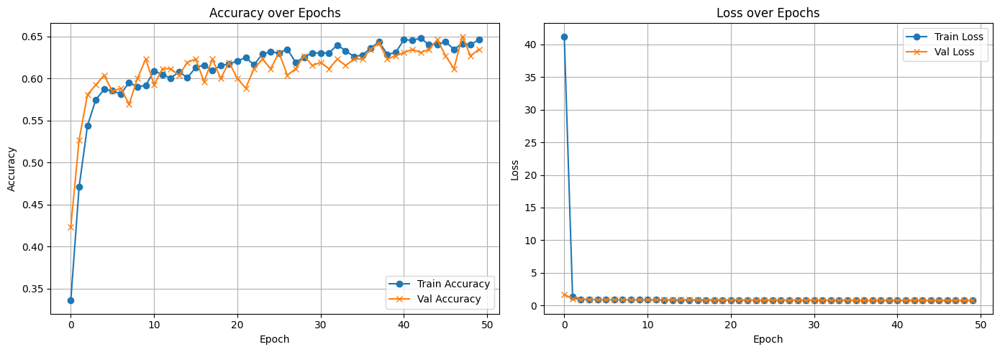

,accuracy,loss,val_accuracy,val_loss,epoch
0,0.335763,41.230057,0.423077,1.694408,1
1,0.470840,1.312253,0.526923,0.997227,2
2,0.543739,0.947880,0.580769,0.939207,3
3,0.574614,0.910650,0.592308,0.914392,4
4,0.587050,0.901279,0.603846,0.900878,5


In [ ]:
# Save full model
model.save("/content/drive/MyDrive/CMU_MOSI_Project/multimodal_sentiment_model.h5")  # Saves architecture + weights + optimizer state

# OR save just the weights
# model.save_weights("multimodal_model_weights.h5")
import matplotlib.pyplot as plt

def plot_training_history(history):
    # Accuracy
    plt.figure(figsize=(14, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy', marker='o')
    plt.plot(history.history['val_accuracy'], label='Val Accuracy', marker='x')
    plt.title('Accuracy over Epochs')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True)

    # Loss
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss', marker='o')
    plt.plot(history.history['val_loss'], label='Val Loss', marker='x')
    plt.title('Loss over Epochs')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.show()

# Call after training
plot_training_history(history)
import pandas as pd

# Convert training history to DataFrame
history_df = pd.DataFrame(history.history)

# Add epoch number as a column
history_df['epoch'] = history_df.index + 1

# Save to CSV
history_df.to_csv("training_metrics.csv", index=False)

# Show a preview
history_df.head()


In [ ]:
X_resampled

,start_time,end_time,sentiment_score,acoustic_0,acoustic_1,acoustic_2,acoustic_3,acoustic_4,acoustic_5,acoustic_6,...,text_290,text_291,text_292,text_293,text_294,text_295,text_296,text_297,text_298,text_299
0,51.904533,55.945350,2.40,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,0.965336,...,1.603632,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136
1,56.045124,66.780720,-0.80,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,0.965336,...,1.603632,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136
2,66.780720,68.736280,-1.00,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,0.965336,...,1.603632,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136
3,68.736280,70.542175,-1.75,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,0.965336,...,1.603632,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136
4,70.542175,71.699550,0.00,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,0.965336,...,1.603632,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3235,80.210924,84.832476,0.00,0.974134,-0.567387,0.343799,0.546683,1.034327,-0.903170,1.533547,...,-0.486959,0.622444,0.521236,1.039557,0.160704,-0.263304,1.622433,1.175114,-0.105108,-0.125230
3236,70.868412,72.025786,0.00,0.782980,-1.373551,1.061452,0.569479,1.229861,-0.876017,0.965336,...,1.603632,-1.088957,-0.267768,-0.396675,-0.595618,0.638158,0.709714,-0.385221,-0.976926,-0.413136
3237,109.270786,111.147622,0.00,0.372724,0.221524,1.577788,1.148331,1.447326,-0.231606,1.652935,...,0.246276,-0.711583,-1.811318,-1.532370,2.314333,0.546902,-1.726666,-1.239136,1.310215,2.265009
3238,164.185591,166.500876,0.00,-1.570943,-0.058111,0.097774,0.465650,0.151472,-0.433901,-1.175392,...,0.372077,0.475651,-0.037917,-0.498811,0.881900,-0.410949,-0.882877,-1.159029,0.150420,0.514582


## Model Testing on processed dataset

In [ ]:
import pandas as pd

# Load individual CSV files
text_df = pd.read_csv('/content/drive/MyDrive/CMU_MOSI_Project/text_features_spacy_per_line.csv')
audio_df = pd.read_csv('/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/audio_features_denoised.csv')
video_df = pd.read_csv('/content/drive/MyDrive/CMU_MOSI_Project/CMU_MOSI_Features.csv')
text_spacy_cols = text_df.loc[:, text_df.columns.str.startswith('spacy')]

# Select all rows and all columns except the last column in audio_df
audio_selected = audio_df.iloc[:, :-1]  # All rows, all columns except the last one
audio_selected.columns = [f'acoustic_{i}' for i in range(len(audio_selected.columns))]

# Select timestamp column from video_df (assuming columns 1 to 3 are timestamp-related)
timestamp = video_df.iloc[:, 1:4]

# Select sentiment_score from video_df and apply the sentiment_to_label function
def sentiment_to_label(score):
    if score > 0:
        return 1  # Positive
    elif score < 0:
        return -1  # Negative
    else:
        return 0  # Neutral

# Apply sentiment_to_label to 'sentiment_score' column (assuming 'sentiment_score' is in video_df)
sentiment_labels = video_df['sentiment_score'].apply(sentiment_to_label)

# Select image features from video_df (columns 78 to 507)
X_image = video_df.iloc[:, 78:78+430]

# Rename the columns of text_spacy_cols to 'text_0', 'text_1', etc.
text_spacy_cols.columns = [f'text_{i}' for i in range(len(text_spacy_cols.columns))]

# Concatenate the DataFrames
# This assumes that the rows in each DataFrame are in the same order and correspond to the same entities (e.g., videos)
combined_df = pd.concat([timestamp, audio_selected, X_image, text_spacy_cols, sentiment_labels], axis=1)

# Display the combined DataFrame (optional)
combined_df.head()

# Optionally, save the combined DataFrame to a CSV
output_csv_combined = '/content/drive/MyDrive/CMU_MOSI_Project/combined_featuresrumaisaa.csv'
combined_df.to_csv(output_csv_combined, index=False)

print(f"Combined dataset saved at {output_csv_combined}")


Combined dataset saved at /content/drive/MyDrive/CMU_MOSI_Project/combined_featuresrumaisaa.csv


In [ ]:
combined_df

,start_time,end_time,sentiment_score,acoustic_0,acoustic_1,acoustic_2,acoustic_3,acoustic_4,acoustic_5,acoustic_6,...,text_291,text_292,text_293,text_294,text_295,text_296,text_297,text_298,text_299,sentiment_score
0,51.904533,55.945350,2.40,-368.13750,65.312030,8.414616,59.446020,-10.238630,17.207108,-3.689290,...,-0.019347,0.011060,-0.102905,-0.008914,0.008080,-0.161977,-0.097590,0.049753,0.067465,1
1,56.045124,66.780720,-0.80,-458.27542,66.943050,3.780416,43.172554,-23.739630,18.569164,-11.373702,...,0.095070,0.013330,-0.151557,0.061108,0.093715,-0.044989,0.002026,0.049489,0.167619,-1
2,66.780720,68.736280,-1.00,-293.17484,80.080850,-2.411047,61.026780,-28.378195,26.575228,4.672551,...,-0.116363,-0.199292,-0.077722,0.257174,-0.061410,0.226191,-0.413923,-0.005412,0.155584,-1
3,68.736280,70.542175,-1.75,-389.41037,79.099594,15.747735,55.930645,-22.554308,23.088963,1.625898,...,-0.048368,-0.198294,0.137931,-0.020982,-0.090773,0.017288,-0.230190,0.147833,0.070956,-1
4,70.542175,71.699550,0.00,-397.49466,75.038590,25.555110,52.337880,-6.054044,25.725826,-1.815432,...,0.030839,-0.008458,-0.062390,0.105619,-0.115358,-0.083945,-0.053253,0.114639,0.118311,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2194,130.007030,136.921310,-1.00,-562.55720,75.053020,28.841750,13.735650,-29.237995,-16.813492,-21.427092,...,0.145996,0.025852,-0.112756,0.008564,0.161623,-0.075764,0.009096,0.001972,0.154471,-1
2195,136.921310,143.007480,0.80,-504.85960,85.900720,-28.553150,13.463282,-42.224945,-14.107276,-26.544167,...,0.014634,0.075228,-0.106250,0.098577,-0.023317,-0.138626,-0.151423,-0.010235,0.236798,1
2196,143.007480,147.736740,-0.40,-527.92114,94.336110,-24.386885,33.129060,-40.188290,-11.886528,-30.035145,...,0.227098,0.000510,-0.034288,0.018530,0.119804,-0.126798,-0.107480,0.095903,0.220212,-1
2197,157.594330,159.669620,1.20,-563.99774,31.422040,8.683523,2.975022,-10.600202,-14.795151,-19.236210,...,0.080303,-0.152075,-0.085548,0.153621,-0.034847,-0.083438,-0.127465,0.085170,0.102822,1


In [ ]:
# Save the combined DataFrame to a CSV file on Google Drive
output_csv = '/content/drive/MyDrive/CMU_MOSI_Project/combined_featuresrumaisaa.csv'
combined_df.to_csv(output_csv, index=False)

print(f"Combined DataFrame saved at {output_csv}")


Combined DataFrame saved at /content/drive/MyDrive/CMU_MOSI_Project/combined_featuresrumaisaa.csv


In [ ]:
import pandas as pd

combined_df = pd.read_csv('/content/drive/MyDrive/CMU_MOSI_Project/combined_featuresrumaisaa.csv')


X = combined_df.drop(columns=['sentiment_score.1'])
y = combined_df['sentiment_score.1']


In [ ]:
y=combined_df['sentiment_score.1']

### Logistic

In [ ]:
import joblib

model_path = '/content/drive/MyDrive/CMU_MOSI_Project/logistic_regression_model.joblib'
model = joblib.load(model_path)

X_subset = X[:1000]
y_subset = y[:1000]

y_pred_proba = model.predict_proba(X_subset)
y_pred_labels = np.argmax(y_pred_proba, axis=1)

accuracy = accuracy_score(y_subset, y_pred_labels)
print(f"Accuracy on first 100 rows: {accuracy}")

print(classification_report(y_subset, y_pred_labels))


Accuracy on first 100 rows: 0.572
              precision    recall  f1-score   support

          -1       0.00      0.00      0.00       378
           0       0.00      0.00      0.00        45
           1       0.61      0.99      0.75       577
           2       0.00      0.00      0.00         0

    accuracy                           0.57      1000
   macro avg       0.15      0.25      0.19      1000
weighted avg       0.35      0.57      0.43      1000



/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_

### Random Forest

In [ ]:
import joblib
import numpy as np
from sklearn.metrics import accuracy_score, classification_report

model_path = '/content/drive/MyDrive/CMU_MOSI_Project/random_forest_model.joblib'
model = joblib.load(model_path)

X_subset = X[:1000]
y_subset = y[:1000]

y_pred_proba = model.predict_proba(X_subset)
y_pred_labels = np.argmax(y_pred_proba, axis=1)

accuracy = accuracy_score(y_subset, y_pred_labels)
print(f"Accuracy on first 100 rows: {accuracy}")

print(classification_report(y_subset, y_pred_labels))


Accuracy on first 100 rows: 0.525
              precision    recall  f1-score   support

          -1       0.00      0.00      0.00       378
           0       0.00      0.00      0.00        45
           1       0.58      0.91      0.71       577
           2       0.00      0.00      0.00         0

    accuracy                           0.53      1000
   macro avg       0.15      0.23      0.18      1000
weighted avg       0.33      0.53      0.41      1000



/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_

### CNN

In [ ]:
import tensorflow as tf
import numpy as np
from sklearn.metrics import accuracy_score, classification_report
from tensorflow.keras.models import load_model

model_path = '/content/drive/MyDrive/CMU_MOSI_Project/multimodal_sentiment_model.h5'
model = load_model(model_path, custom_objects={'InputLayer': tf.keras.layers.InputLayer})
X_subset = X[:500]
y_subset = y[:500]
X_audio = X_subset.iloc[:,3 :74+3]
X_image = X_subset.iloc[:, 77:77+430]
X_text  = X_subset.iloc[:, 507:507+300]
y_pred_proba = model.predict([X_audio, X_image, X_text])


y_pred_labels = np.argmax(y_pred_proba, axis=1)

accuracy = accuracy_score(y_subset, y_pred_labels)
print(f"Accuracy on first 500 rows: {accuracy}")



16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
Accuracy on first 500 rows: 0.56


# FINAL MODEL

In [ ]:
from google.colab import drive

# Check if drive is already mounted
try:
    drive.mount('/content/drive', force_remount=True)  # Try mounting, forcing remount if already mounted
except ValueError as e:
    if 'already mounted' in str(e):
        print("Drive is already mounted. Skipping mounting.")
    else:
        raise e  # Re-raise if a different error occurs

Mounted at /content/drive


In [2]:
import pandas as pd
combined_df = pd.read_csv('/content/drive/MyDrive/CMU_MOSI_Project/combined_featuresrumaisaa.csv')
combined_df


,start_time,end_time,sentiment_score,acoustic_0,acoustic_1,acoustic_2,acoustic_3,acoustic_4,acoustic_5,acoustic_6,...,text_291,text_292,text_293,text_294,text_295,text_296,text_297,text_298,text_299,sentiment_score.1
0,51.904533,55.945350,2.40,-368.13750,65.312030,8.414616,59.446020,-10.238630,17.207108,-3.689290,...,-0.019347,0.011060,-0.102905,-0.008914,0.008080,-0.161977,-0.097590,0.049753,0.067465,1
1,56.045124,66.780720,-0.80,-458.27542,66.943050,3.780416,43.172554,-23.739630,18.569164,-11.373702,...,0.095070,0.013330,-0.151557,0.061108,0.093715,-0.044989,0.002026,0.049489,0.167619,-1
2,66.780720,68.736280,-1.00,-293.17484,80.080850,-2.411047,61.026780,-28.378195,26.575228,4.672551,...,-0.116363,-0.199292,-0.077722,0.257174,-0.061410,0.226191,-0.413923,-0.005412,0.155584,-1
3,68.736280,70.542175,-1.75,-389.41037,79.099594,15.747735,55.930645,-22.554308,23.088963,1.625898,...,-0.048368,-0.198294,0.137931,-0.020982,-0.090773,0.017288,-0.230190,0.147833,0.070956,-1
4,70.542175,71.699550,0.00,-397.49466,75.038590,25.555110,52.337880,-6.054044,25.725826,-1.815432,...,0.030839,-0.008458,-0.062390,0.105619,-0.115358,-0.083945,-0.053253,0.114639,0.118311,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2194,130.007030,136.921310,-1.00,-562.55720,75.053020,28.841750,13.735650,-29.237995,-16.813492,-21.427092,...,0.145996,0.025852,-0.112756,0.008564,0.161623,-0.075764,0.009096,0.001972,0.154471,-1
2195,136.921310,143.007480,0.80,-504.85960,85.900720,-28.553150,13.463282,-42.224945,-14.107276,-26.544167,...,0.014634,0.075228,-0.106250,0.098577,-0.023317,-0.138626,-0.151423,-0.010235,0.236798,1
2196,143.007480,147.736740,-0.40,-527.92114,94.336110,-24.386885,33.129060,-40.188290,-11.886528,-30.035145,...,0.227098,0.000510,-0.034288,0.018530,0.119804,-0.126798,-0.107480,0.095903,0.220212,-1
2197,157.594330,159.669620,1.20,-563.99774,31.422040,8.683523,2.975022,-10.600202,-14.795151,-19.236210,...,0.080303,-0.152075,-0.085548,0.153621,-0.034847,-0.083438,-0.127465,0.085170,0.102822,1


In [3]:
# prompt: print class imbalance

import pandas as pd
from collections import Counter

# Load the combined features dataframe
combined_df = pd.read_csv('/content/drive/MyDrive/CMU_MOSI_Project/combined_featuresrumaisaa.csv')

# Assuming 'sentiment_score.1' is your target variable column
sentiment_counts = Counter(combined_df['sentiment_score.1'])

print("Class Imbalance:")
for sentiment, count in sentiment_counts.items():
    print(f"Sentiment: {sentiment}, Count: {count}")


Class Imbalance:
Sentiment: 1, Count: 1080
Sentiment: -1, Count: 1023
Sentiment: 0, Count: 96


In [ ]:
!pip install torch torchaudio torchvision transformers numpy pandas scikit-learn tqdm


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 96.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 72.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 43.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 85.1 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [4]:
TEXT_FEATURES = [f'text_{i}' for i in range(300)]
ACOUSTIC_FEATURES = [f'acoustic_{i}' for i in range(74)]
VISUAL_FEATURES = [f'visual_{i}' for i in range(430)]  # Adjust if different

X_text = combined_df[TEXT_FEATURES].values
X_acoustic = combined_df[ACOUSTIC_FEATURES].values
X_visual = combined_df[VISUAL_FEATURES].values
y = combined_df['sentiment_score.1'].values  # Already provided


# **Multi-Head Attention**

Epoch 1/30, Train Acc: 0.4815, Val Acc: 0.5000
Epoch 2/30, Train Acc: 0.8960, Val Acc: 0.5273
Epoch 3/30, Train Acc: 0.9733, Val Acc: 0.5386
Epoch 4/30, Train Acc: 1.0000, Val Acc: 0.5432
Epoch 5/30, Train Acc: 1.0000, Val Acc: 0.5318
Epoch 6/30, Train Acc: 1.0000, Val Acc: 0.5295
Epoch 7/30, Train Acc: 1.0000, Val Acc: 0.5159
Epoch 8/30, Train Acc: 1.0000, Val Acc: 0.5295
Epoch 9/30, Train Acc: 1.0000, Val Acc: 0.5182
Epoch 10/30, Train Acc: 1.0000, Val Acc: 0.5227
Epoch 11/30, Train Acc: 1.0000, Val Acc: 0.5205
Epoch 12/30, Train Acc: 1.0000, Val Acc: 0.5205
Epoch 13/30, Train Acc: 1.0000, Val Acc: 0.5205
Epoch 14/30, Train Acc: 1.0000, Val Acc: 0.5159
Epoch 15/30, Train Acc: 1.0000, Val Acc: 0.5205
Epoch 16/30, Train Acc: 1.0000, Val Acc: 0.5159
Epoch 17/30, Train Acc: 1.0000, Val Acc: 0.5205
Epoch 18/30, Train Acc: 1.0000, Val Acc: 0.5273
Epoch 19/30, Train Acc: 1.0000, Val Acc: 0.5341
Epoch 20/30, Train Acc: 1.0000, Val Acc: 0.5205
Epoch 21/30, Train Acc: 1.0000, Val Acc: 0.5250
E

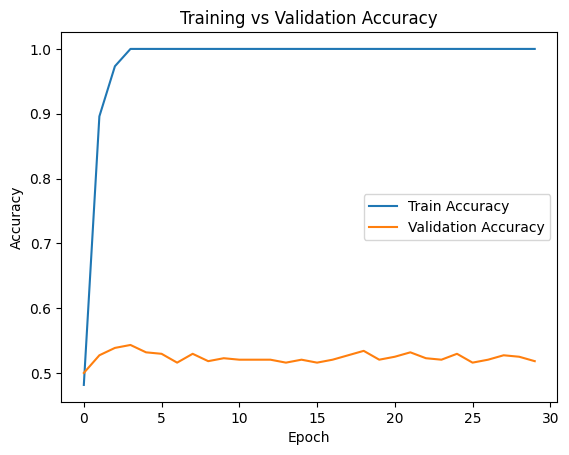

In [ ]:
# Updated version of your multimodal model with all suggestions applied:
# - Added Acoustic branch (audio model)
# - Added BatchNorm
# - Added one more FC layer to text and audio models
# - Adjusted dropout to 0.3
# - Changed optimizer to AdamW
# - Reduced LR to 0.0005
# - Added weight decay
# - Added scheduler

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

# Constants
IMG_SHAPE = 64
BATCH_SIZE = 64
EPOCHS = 30
LR = 0.0005
NUM_CLASSES = 3
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load CSV
csv_path = '/content/drive/MyDrive/CMU_MOSI_Project/combined_featuresrumaisaa.csv'
combined_df = pd.read_csv(csv_path)

TEXT_FEATURES = [f'text_{i}' for i in range(300)]
ACOUSTIC_FEATURES = [f'acoustic_{i}' for i in range(74)]
VISUAL_FEATURES = [f'visual_{i}' for i in range(430)]

X_text = combined_df[TEXT_FEATURES].values.astype(np.float32)
X_acoustic = combined_df[ACOUSTIC_FEATURES].values.astype(np.float32)
X_visual = combined_df[VISUAL_FEATURES].values.astype(np.float32)
y = combined_df['sentiment_score.1'].values.astype(int) + 1

# Dataset class
class MultimodalDataset(Dataset):
    def __init__(self, X_text, X_visual, X_acoustic, y):
        self.X_text = X_text
        self.X_visual = X_visual
        self.X_acoustic = X_acoustic
        self.y = y
        self.images = torch.randn(len(y), 3, IMG_SHAPE, IMG_SHAPE)  # synthetic image

    def __len__(self):
        return len(self.y)

    def __getitem__(self, idx):
        return (
            torch.tensor(self.X_text[idx]),
            self.images[idx],
            torch.tensor(self.X_acoustic[idx]),
            torch.tensor(self.y[idx])
        )

# Text model
class TextModel(nn.Module):
    def __init__(self):
        super().__init__()
        self.seq = nn.Sequential(
            nn.Linear(300, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(256, 128),
            nn.BatchNorm1d(128),
            nn.ReLU()
        )

    def forward(self, x):
        return self.seq(x)

# Acoustic model
class AcousticModel(nn.Module):
    def __init__(self):
        super().__init__()
        self.seq = nn.Sequential(
            nn.Linear(74, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(128, 128),
            nn.BatchNorm1d(128),
            nn.ReLU()
        )

    def forward(self, x):
        return self.seq(x)

# Visual model
class ImageModel(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 32, 3, padding=1)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        self.flatten = nn.Flatten()
        self.fc = nn.Sequential(
            nn.Linear(64 * (IMG_SHAPE // 4) * (IMG_SHAPE // 4), 128),
            nn.BatchNorm1d(128),
            nn.ReLU()
        )

    def forward(self, x):
        x = self.pool(torch.relu(self.conv1(x)))
        x = self.pool(torch.relu(self.conv2(x)))
        x = self.flatten(x)
        return self.fc(x)

# Fusion model
class MultimodalClassifier(nn.Module):
    def __init__(self):
        super().__init__()
        self.text_model = TextModel()
        self.audio_model = AcousticModel()
        self.image_model = ImageModel()
        self.attn = nn.MultiheadAttention(embed_dim=128, num_heads=4, batch_first=True)
        self.fc = nn.Sequential(
            nn.Linear(128, NUM_CLASSES)
        )

    def forward(self, text, image, audio):
        t = self.text_model(text)
        i = self.image_model(image)
        a = self.audio_model(audio)
        combined = torch.stack([t, i, a], dim=1)
        attn_out, _ = self.attn(combined, combined, combined)
        pooled = attn_out.mean(dim=1)
        return self.fc(pooled)

# Load data
dataset = MultimodalDataset(X_text, X_visual, X_acoustic, y)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_ds, val_ds = random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_ds, batch_size=BATCH_SIZE)

# Initialize model
model = MultimodalClassifier().to(DEVICE)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=LR, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.5)

# Training
train_acc_list, val_acc_list = [], []

for epoch in range(EPOCHS):
    model.train()
    correct, total = 0, 0
    for text, image, audio, label in train_loader:
        text, image, audio, label = text.to(DEVICE), image.to(DEVICE), audio.to(DEVICE), label.to(DEVICE)
        optimizer.zero_grad()
        outputs = model(text, image, audio)
        loss = criterion(outputs, label)
        loss.backward()
        optimizer.step()
        _, predicted = torch.max(outputs.data, 1)
        total += label.size(0)
        correct += (predicted == label).sum().item()
    train_acc = correct / total
    train_acc_list.append(train_acc)

    model.eval()
    correct, total = 0, 0
    with torch.no_grad():
        for text, image, audio, label in val_loader:
            text, image, audio, label = text.to(DEVICE), image.to(DEVICE), audio.to(DEVICE), label.to(DEVICE)
            outputs = model(text, image, audio)
            _, predicted = torch.max(outputs.data, 1)
            total += label.size(0)
            correct += (predicted == label).sum().item()
    val_acc = correct / total
    val_acc_list.append(val_acc)
    scheduler.step()

    print(f"Epoch {epoch+1}/{EPOCHS}, Train Acc: {train_acc:.4f}, Val Acc: {val_acc:.4f}")

# Plot accuracy
plt.plot(train_acc_list, label='Train Accuracy')
plt.plot(val_acc_list, label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training vs Validation Accuracy')
plt.show()



Classification Report:
              precision    recall  f1-score   support

    Negative       0.51      0.51      0.51       202
     Neutral       0.00      0.00      0.00        18
    Positive       0.53      0.57      0.55       220

    accuracy                           0.52       440
   macro avg       0.35      0.36      0.35       440
weighted avg       0.50      0.52      0.51       440



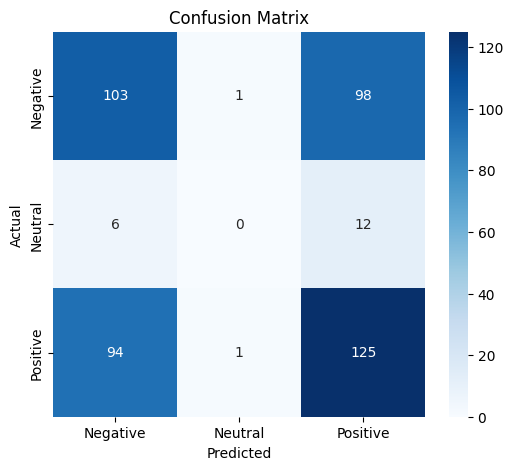

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

# Final Evaluation
model.eval()
all_preds = []
all_labels = []

with torch.no_grad():
    for text, image, audio, label in val_loader:
        text, image, audio = text.to(DEVICE), image.to(DEVICE), audio.to(DEVICE)
        outputs = model(text, image, audio)
        preds = torch.argmax(outputs, dim=1).cpu().numpy()
        all_preds.extend(preds)
        all_labels.extend(label.numpy())

# Classification Report
print("\nClassification Report:")
print(classification_report(all_labels, all_preds, target_names=["Negative", "Neutral", "Positive"]))

# Confusion Matrix
cm = confusion_matrix(all_labels, all_preds)
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=["Negative", "Neutral", "Positive"], yticklabels=["Negative", "Neutral", "Positive"])
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()


Epoch 1/30, Train Acc: 0.4849, Val Acc: 0.4614
✅ New best model saved
Epoch 2/30, Train Acc: 0.8960, Val Acc: 0.4500
⚠️ No improvement for 1 epoch(s)
Epoch 3/30, Train Acc: 0.9443, Val Acc: 0.4932
✅ New best model saved
Epoch 4/30, Train Acc: 0.9596, Val Acc: 0.5114
✅ New best model saved
Epoch 5/30, Train Acc: 0.9795, Val Acc: 0.4818
⚠️ No improvement for 1 epoch(s)
Epoch 6/30, Train Acc: 0.9972, Val Acc: 0.5045
⚠️ No improvement for 2 epoch(s)
Epoch 7/30, Train Acc: 0.9989, Val Acc: 0.4659
⚠️ No improvement for 3 epoch(s)
Epoch 8/30, Train Acc: 1.0000, Val Acc: 0.4659
⚠️ No improvement for 4 epoch(s)
Epoch 9/30, Train Acc: 1.0000, Val Acc: 0.5068
⚠️ No improvement for 5 epoch(s)
🛑 Early stopping triggered


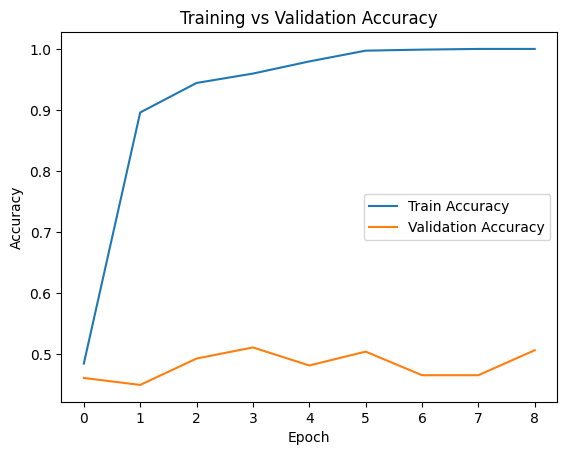

In [5]:
# Full updated code: Multimodal classifier with improved generalization
# - Best model saving
# - Early stopping
# - Higher dropout
# - Smaller FC layers
# - Lower learning rate
# - Increased weight decay

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

# Constants
IMG_SHAPE = 64
BATCH_SIZE = 64
EPOCHS = 30
LR = 0.0003
NUM_CLASSES = 3
DROPOUT = 0.5
WEIGHT_DECAY = 1e-4
PATIENCE = 5
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load CSV
csv_path = '/content/drive/MyDrive/CMU_MOSI_Project/combined_featuresrumaisaa.csv'
combined_df = pd.read_csv(csv_path)

TEXT_FEATURES = [f'text_{i}' for i in range(300)]
ACOUSTIC_FEATURES = [f'acoustic_{i}' for i in range(74)]
VISUAL_FEATURES = [f'visual_{i}' for i in range(430)]

X_text = combined_df[TEXT_FEATURES].values.astype(np.float32)
X_acoustic = combined_df[ACOUSTIC_FEATURES].values.astype(np.float32)
X_visual = combined_df[VISUAL_FEATURES].values.astype(np.float32)
y = combined_df['sentiment_score.1'].values.astype(int) + 1

# Dataset class
class MultimodalDataset(Dataset):
    def __init__(self, X_text, X_visual, X_acoustic, y):
        self.X_text = X_text
        self.X_visual = X_visual
        self.X_acoustic = X_acoustic
        self.y = y
        self.images = torch.randn(len(y), 3, IMG_SHAPE, IMG_SHAPE)

    def __len__(self):
        return len(self.y)

    def __getitem__(self, idx):
        return (
            torch.tensor(self.X_text[idx]),
            self.images[idx],
            torch.tensor(self.X_acoustic[idx]),
            torch.tensor(self.y[idx])
        )

# Sub-models
class TextModel(nn.Module):
    def __init__(self):
        super().__init__()
        self.seq = nn.Sequential(
            nn.Linear(300, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(DROPOUT),
            nn.Linear(128, 64),
            nn.BatchNorm1d(64),
            nn.ReLU()
        )

    def forward(self, x):
        return self.seq(x)

class AcousticModel(nn.Module):
    def __init__(self):
        super().__init__()
        self.seq = nn.Sequential(
            nn.Linear(74, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(DROPOUT),
            nn.Linear(128, 64),
            nn.BatchNorm1d(64),
            nn.ReLU()
        )

    def forward(self, x):
        return self.seq(x)

class ImageModel(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 32, 3, padding=1)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(32, 64, 3, padding=1)
        self.flatten = nn.Flatten()
        self.fc = nn.Sequential(
            nn.Linear(64 * (IMG_SHAPE // 4) * (IMG_SHAPE // 4), 64),
            nn.BatchNorm1d(64),
            nn.ReLU()
        )

    def forward(self, x):
        x = self.pool(torch.relu(self.conv1(x)))
        x = self.pool(torch.relu(self.conv2(x)))
        x = self.flatten(x)
        return self.fc(x)

# Fusion model
class MultimodalClassifier(nn.Module):
    def __init__(self):
        super().__init__()
        self.text_model = TextModel()
        self.audio_model = AcousticModel()
        self.image_model = ImageModel()
        self.attn = nn.MultiheadAttention(embed_dim=64, num_heads=4, batch_first=True)
        self.fc = nn.Sequential(
            nn.Linear(64, NUM_CLASSES)
        )

    def forward(self, text, image, audio):
        t = self.text_model(text)
        i = self.image_model(image)
        a = self.audio_model(audio)
        combined = torch.stack([t, i, a], dim=1)
        attn_out, _ = self.attn(combined, combined, combined)
        pooled = attn_out.mean(dim=1)
        return self.fc(pooled)

# Prepare data
dataset = MultimodalDataset(X_text, X_visual, X_acoustic, y)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_ds, val_ds = random_split(dataset, [train_size, val_size])

train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_ds, batch_size=BATCH_SIZE)

# Model setup
model = MultimodalClassifier().to(DEVICE)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=LR, weight_decay=WEIGHT_DECAY)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.5)

# Training with early stopping
best_val_acc = 0.0
patience_counter = 0
train_acc_list, val_acc_list = [], []

for epoch in range(EPOCHS):
    model.train()
    correct, total = 0, 0
    for text, image, audio, label in train_loader:
        text, image, audio, label = text.to(DEVICE), image.to(DEVICE), audio.to(DEVICE), label.to(DEVICE)
        optimizer.zero_grad()
        outputs = model(text, image, audio)
        loss = criterion(outputs, label)
        loss.backward()
        optimizer.step()
        _, predicted = torch.max(outputs.data, 1)
        total += label.size(0)
        correct += (predicted == label).sum().item()
    train_acc = correct / total
    train_acc_list.append(train_acc)

    model.eval()
    correct, total = 0, 0
    with torch.no_grad():
        for text, image, audio, label in val_loader:
            text, image, audio, label = text.to(DEVICE), image.to(DEVICE), audio.to(DEVICE), label.to(DEVICE)
            outputs = model(text, image, audio)
            _, predicted = torch.max(outputs.data, 1)
            total += label.size(0)
            correct += (predicted == label).sum().item()
    val_acc = correct / total
    val_acc_list.append(val_acc)
    scheduler.step()

    print(f"Epoch {epoch+1}/{EPOCHS}, Train Acc: {train_acc:.4f}, Val Acc: {val_acc:.4f}")

    if val_acc > best_val_acc:
        best_val_acc = val_acc
        patience_counter = 0
        torch.save(model.state_dict(), "best_multimodal_model.pt")
        print("✅ New best model saved")
    else:
        patience_counter += 1
        print(f"⚠️ No improvement for {patience_counter} epoch(s)")
        if patience_counter >= PATIENCE:
            print("🛑 Early stopping triggered")
            break

# Accuracy plot
plt.plot(train_acc_list, label='Train Accuracy')
plt.plot(val_acc_list, label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training vs Validation Accuracy')
plt.show()



Classification Report:
              precision    recall  f1-score   support

    Negative       0.51      0.74      0.60       211
     Neutral       0.00      0.00      0.00        26
    Positive       0.52      0.34      0.41       203

    accuracy                           0.51       440
   macro avg       0.34      0.36      0.34       440
weighted avg       0.48      0.51      0.48       440



/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


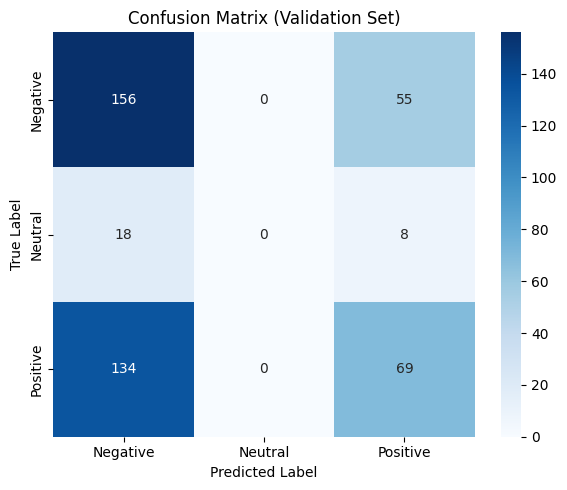

In [6]:
# Load best model
model.load_state_dict(torch.load("best_multimodal_model.pt"))
model.eval()

# Inference on validation set
all_preds = []
all_labels = []

with torch.no_grad():
    for text, image, audio, label in val_loader:
        text, image, audio = text.to(DEVICE), image.to(DEVICE), audio.to(DEVICE)
        outputs = model(text, image, audio)
        preds = torch.argmax(outputs, dim=1).cpu().numpy()
        all_preds.extend(preds)
        all_labels.extend(label.numpy())

# Classification Report
print("\nClassification Report:")
print(classification_report(all_labels, all_preds, target_names=["Negative", "Neutral", "Positive"]))

# Confusion Matrix
cm = confusion_matrix(all_labels, all_preds)
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=["Negative", "Neutral", "Positive"],
            yticklabels=["Negative", "Neutral", "Positive"])
plt.title("Confusion Matrix (Validation Set)")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.tight_layout()
plt.show()


In [ ]:
from sklearn.model_selection import train_test_split
from collections import Counter

# Perform stratified split into train and test
train_df, test_df = train_test_split(combined_df, test_size=0.2, stratify=combined_df['sentiment_score.1'], random_state=42)

# Check imbalance in training data
train_labels = train_df['sentiment_score.1'].astype(int) + 1
train_dist = Counter(train_labels)
print("\n📊 Class distribution in Training Data:")
for cls, count in sorted(train_dist.items()):
    print(f"Class {cls}: {count} samples ({(count / len(train_labels)) * 100:.2f}%)")

# Check imbalance in testing data
test_labels = test_df['sentiment_score.1'].astype(int) + 1
test_dist = Counter(test_labels)
print("\n📊 Class distribution in Testing Data:")
for cls, count in sorted(test_dist.items()):
    print(f"Class {cls}: {count} samples ({(count / len(test_labels)) * 100:.2f}%)")



📊 Class distribution in Training Data:
Class 0: 818 samples (46.50%)
Class 1: 77 samples (4.38%)
Class 2: 864 samples (49.12%)

📊 Class distribution in Testing Data:
Class 0: 205 samples (46.59%)
Class 1: 19 samples (4.32%)
Class 2: 216 samples (49.09%)


# **late fusion**

In [ ]:
!pip uninstall -y transformers
!pip install transformers==4.39.3

Found existing installation: transformers 4.39.3
Uninstalling transformers-4.39.3:
  Successfully uninstalled transformers-4.39.3
  Using cached transformers-4.39.3-py3-none-any.whl.metadata (134 kB)
Using cached transformers-4.39.3-py3-none-any.whl (8.8 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
sentence-transformers 3.4.1 requires transformers<5.0.0,>=4.41.0, but you have transformers 4.39.3 which is incompatible.



Epoch 1/10


Evaluating: 100%|██████████| 44/44 [00:00<00:00, 245.20it/s]


Train Acc: 0.4807 | Val Acc: 0.5398 | Val F1: 0.4966

Epoch 2/10


Evaluating: 100%|██████████| 44/44 [00:00<00:00, 168.82it/s]


Train Acc: 0.5022 | Val Acc: 0.4773 | Val F1: 0.3878

Epoch 3/10


Evaluating: 100%|██████████| 44/44 [00:00<00:00, 592.33it/s]


Train Acc: 0.4864 | Val Acc: 0.4886 | Val F1: 0.3220

Epoch 4/10


Evaluating: 100%|██████████| 44/44 [00:00<00:00, 1070.21it/s]


Train Acc: 0.5054 | Val Acc: 0.5000 | Val F1: 0.3998
🛑 Early stopping triggered


Evaluating: 100%|██████████| 110/110 [00:00<00:00, 1211.69it/s]
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is"


Test Accuracy: 0.4841 | Test F1 Score: 0.4263
              precision    recall  f1-score   support

           0       0.47      0.82      0.60       205
           1       0.00      0.00      0.00        19
           2       0.54      0.21      0.30       216

    accuracy                           0.48       440
   macro avg       0.34      0.34      0.30       440
weighted avg       0.48      0.48      0.43       440



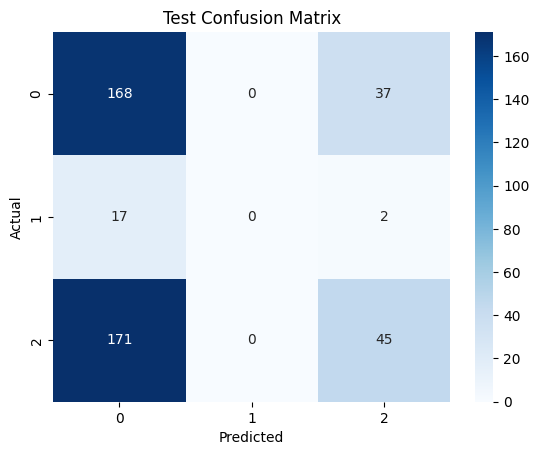

In [ ]:
# Ultra-low-memory late fusion model using simplified ResNet and text embeddings (no full BERT)

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, f1_score
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

# Config
class Config:
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    batch_size = 4
    epochs = 10
    lr = 1e-3
    dropout = 0.4
    num_classes = 3
    text_feat_dim = 300
    audio_feat_dim = 74
    visual_feat_dim = 430

config = Config()

# Dataset class using pre-extracted features only (no image loading)
class LateFusionFeaturesDataset(Dataset):
    def __init__(self, df):
        self.text_features = df[[f'text_{i}' for i in range(config.text_feat_dim)]].values.astype(np.float32)
        self.audio_features = df[[f'acoustic_{i}' for i in range(config.audio_feat_dim)]].values.astype(np.float32)
        self.visual_features = df[[f'visual_{i}' for i in range(config.visual_feat_dim)]].values.astype(np.float32)
        self.labels = df['sentiment_score.1'].values.astype(int) + 1  # Shift to 0, 1, 2

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        return {
            'text': torch.tensor(self.text_features[idx], dtype=torch.float32),
            'audio': torch.tensor(self.audio_features[idx], dtype=torch.float32),
            'visual': torch.tensor(self.visual_features[idx], dtype=torch.float32),
            'label': torch.tensor(self.labels[idx], dtype=torch.long)
        }

# Model definition
class LightweightLateFusionModel(nn.Module):
    def __init__(self):
        super().__init__()
        self.text_branch = nn.Sequential(
            nn.Linear(config.text_feat_dim, 128),
            nn.ReLU(),
            nn.Dropout(config.dropout)
        )
        self.audio_branch = nn.Sequential(
            nn.Linear(config.audio_feat_dim, 128),
            nn.ReLU(),
            nn.Dropout(config.dropout)
        )
        self.visual_branch = nn.Sequential(
            nn.Linear(config.visual_feat_dim, 128),
            nn.ReLU(),
            nn.Dropout(config.dropout)
        )
        self.classifier = nn.Sequential(
            nn.Linear(128 * 3, 256),
            nn.ReLU(),
            nn.Dropout(config.dropout),
            nn.Linear(256, config.num_classes)
        )

    def forward(self, text, audio, visual):
        t = self.text_branch(text)
        a = self.audio_branch(audio)
        v = self.visual_branch(visual)
        combined = torch.cat([t, a, v], dim=1)
        return self.classifier(combined)

# Training
def train_epoch(model, loader, optimizer, criterion):
    model.train()
    correct, total_loss = 0, 0
    for batch in tqdm(loader, desc="Training"):
        text = batch['text'].to(config.device)
        audio = batch['audio'].to(config.device)
        visual = batch['visual'].to(config.device)
        labels = batch['label'].to(config.device)

        optimizer.zero_grad()
        output = model(text, audio, visual)
        loss = criterion(output, labels)
        loss.backward()
        optimizer.step()

        total_loss += loss.item()
        correct += (output.argmax(1) == labels).sum().item()
    return correct / len(loader.dataset), total_loss / len(loader)

# Evaluation
def eval_model(model, loader, criterion):
    model.eval()
    correct, total_loss = 0, 0
    preds, labels_list = [], []
    with torch.no_grad():
        for batch in tqdm(loader, desc="Evaluating"):
            text = batch['text'].to(config.device)
            audio = batch['audio'].to(config.device)
            visual = batch['visual'].to(config.device)
            labels = batch['label'].to(config.device)

            output = model(text, audio, visual)
            loss = criterion(output, labels)

            total_loss += loss.item()
            predicted = output.argmax(1)
            correct += (predicted == labels).sum().item()
            preds.extend(predicted.cpu().numpy())
            labels_list.extend(labels.cpu().numpy())
    f1 = f1_score(labels_list, preds, average='weighted')
    return correct / len(loader.dataset), total_loss / len(loader), f1, preds, labels_list

# Main function
def main():
    df = pd.read_csv('/content/drive/MyDrive/CMU_MOSI_Project/combined_featuresrumaisaa.csv')
    train_df, test_df = train_test_split(df, test_size=0.2, stratify=df['sentiment_score.1'], random_state=42)
    train_df, val_df = train_test_split(train_df, test_size=0.1, stratify=train_df['sentiment_score.1'], random_state=42)

    train_ds = LateFusionFeaturesDataset(train_df)
    val_ds = LateFusionFeaturesDataset(val_df)
    test_ds = LateFusionFeaturesDataset(test_df)

    train_loader = DataLoader(train_ds, batch_size=config.batch_size, shuffle=True)
    val_loader = DataLoader(val_ds, batch_size=config.batch_size)
    test_loader = DataLoader(test_ds, batch_size=config.batch_size)

    model = LightweightLateFusionModel().to(config.device)
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.AdamW(model.parameters(), lr=config.lr)

    best_f1, patience = 0, 0
    for epoch in range(config.epochs):
        print(f"\nEpoch {epoch+1}/{config.epochs}")
        train_acc, train_loss = train_epoch(model, train_loader, optimizer, criterion)
        val_acc, val_loss, val_f1, _, _ = eval_model(model, val_loader, criterion)
        print(f"Train Acc: {train_acc:.4f} | Val Acc: {val_acc:.4f} | Val F1: {val_f1:.4f}")
        if val_f1 > best_f1:
            best_f1 = val_f1
            patience = 0
            torch.save(model.state_dict(), "light_late_fusion_best.pt")
        else:
            patience += 1
            if patience >= 3:
                print("🛑 Early stopping triggered")
                break

    model.load_state_dict(torch.load("light_late_fusion_best.pt"))
    test_acc, test_loss, test_f1, preds, labels = eval_model(model, test_loader, criterion)
    print(f"\nTest Accuracy: {test_acc:.4f} | Test F1 Score: {test_f1:.4f}")
    print(classification_report(labels, preds))
    sns.heatmap(confusion_matrix(labels, preds), annot=True, fmt='d', cmap='Blues')
    plt.title("Test Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.show()

main()


Epoch 1/50 - Train Acc: 0.5092 - Val Acc: 0.5284
✅ Best model saved.
Epoch 2/50 - Train Acc: 0.5629 - Val Acc: 0.5852
✅ Best model saved.
Epoch 3/50 - Train Acc: 0.5856 - Val Acc: 0.5852
Epoch 4/50 - Train Acc: 0.6140 - Val Acc: 0.6080
✅ Best model saved.
Epoch 5/50 - Train Acc: 0.6273 - Val Acc: 0.6080
Epoch 6/50 - Train Acc: 0.6248 - Val Acc: 0.5909
Epoch 7/50 - Train Acc: 0.6475 - Val Acc: 0.6136
✅ Best model saved.
Epoch 8/50 - Train Acc: 0.6387 - Val Acc: 0.5966
Epoch 9/50 - Train Acc: 0.6526 - Val Acc: 0.5795
Epoch 10/50 - Train Acc: 0.6658 - Val Acc: 0.5909
Epoch 11/50 - Train Acc: 0.6810 - Val Acc: 0.6080
Epoch 12/50 - Train Acc: 0.6924 - Val Acc: 0.5795
Epoch 13/50 - Train Acc: 0.6860 - Val Acc: 0.5909
Epoch 14/50 - Train Acc: 0.6955 - Val Acc: 0.5909
🛑 Early stopping triggered.

📊 Classification Report:
              precision    recall  f1-score   support

    Negative       0.69      0.42      0.52       205
     Neutral       0.00      0.00      0.00        19
    Positive

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


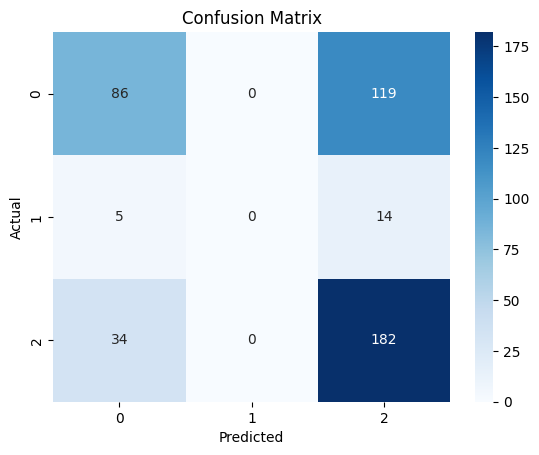

In [7]:
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Configuration
TEXT_DIM = 300
AUDIO_DIM = 74
VISUAL_DIM = 430
HIDDEN_DIM = 128
NUM_CLASSES = 3
DROPOUT = 0.4
BATCH_SIZE = 32
EPOCHS = 50
LR = 1e-3
PATIENCE = 7
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load CSV
df = pd.read_csv('/content/drive/MyDrive/CMU_MOSI_Project/combined_featuresrumaisaa.csv')

# Extract features and labels
X_text = df[[f'text_{i}' for i in range(TEXT_DIM)]].values.astype(np.float32)
X_audio = df[[f'acoustic_{i}' for i in range(AUDIO_DIM)]].values.astype(np.float32)
X_visual = df[[f'visual_{i}' for i in range(VISUAL_DIM)]].values.astype(np.float32)
y = df['sentiment_score.1'].values.astype(int) + 1

# Dataset class
class MultimodalFeatureDataset(Dataset):
    def __init__(self, X_text, X_audio, X_visual, y):
        self.X_text = torch.tensor(X_text, dtype=torch.float32)
        self.X_audio = torch.tensor(X_audio, dtype=torch.float32)
        self.X_visual = torch.tensor(X_visual, dtype=torch.float32)
        self.y = torch.tensor(y, dtype=torch.long)

    def __len__(self):
        return len(self.y)

    def __getitem__(self, idx):
        return self.X_text[idx], self.X_audio[idx], self.X_visual[idx], self.y[idx]

# Model components
class TextBranch(nn.Module):
    def __init__(self):
        super().__init__()
        self.lstm = nn.LSTM(TEXT_DIM, HIDDEN_DIM, batch_first=True, bidirectional=True)
        self.fc = nn.Sequential(
            nn.Linear(HIDDEN_DIM * 2, HIDDEN_DIM),
            nn.ReLU(),
            nn.Dropout(DROPOUT)
        )

    def forward(self, x):
        x = x.unsqueeze(1)
        _, (h_n, _) = self.lstm(x)
        h = torch.cat((h_n[0], h_n[1]), dim=1)
        return self.fc(h)

class AudioBranch(nn.Module):
    def __init__(self):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(AUDIO_DIM, HIDDEN_DIM),
            nn.BatchNorm1d(HIDDEN_DIM),
            nn.ReLU(),
            nn.Dropout(DROPOUT)
        )

    def forward(self, x):
        return self.net(x)

class VisualBranch(nn.Module):
    def __init__(self):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(VISUAL_DIM, HIDDEN_DIM),
            nn.BatchNorm1d(HIDDEN_DIM),
            nn.ReLU(),
            nn.Dropout(DROPOUT)
        )

    def forward(self, x):
        return self.net(x)

class LateFusionModel(nn.Module):
    def __init__(self):
        super().__init__()
        self.text_branch = TextBranch()
        self.audio_branch = AudioBranch()
        self.visual_branch = VisualBranch()
        self.classifier = nn.Sequential(
            nn.Linear(HIDDEN_DIM * 3, HIDDEN_DIM),
            nn.ReLU(),
            nn.Dropout(DROPOUT),
            nn.Linear(HIDDEN_DIM, NUM_CLASSES)
        )

    def forward(self, text, audio, visual):
        t = self.text_branch(text)
        a = self.audio_branch(audio)
        v = self.visual_branch(visual)
        fused = torch.cat([t, a, v], dim=1)
        return self.classifier(fused)

# Split and prepare data
X_text_train, X_text_test, X_audio_train, X_audio_test, X_visual_train, X_visual_test, y_train, y_test = train_test_split(
    X_text, X_audio, X_visual, y, test_size=0.2, stratify=y, random_state=42)

X_text_train, X_text_val, X_audio_train, X_audio_val, X_visual_train, X_visual_val, y_train, y_val = train_test_split(
    X_text_train, X_audio_train, X_visual_train, y_train, test_size=0.1, stratify=y_train, random_state=42)

train_ds = MultimodalFeatureDataset(X_text_train, X_audio_train, X_visual_train, y_train)
val_ds = MultimodalFeatureDataset(X_text_val, X_audio_val, X_visual_val, y_val)
test_ds = MultimodalFeatureDataset(X_text_test, X_audio_test, X_visual_test, y_test)

train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_ds, batch_size=BATCH_SIZE)
test_loader = DataLoader(test_ds, batch_size=BATCH_SIZE)

# Training setup
model = LateFusionModel().to(DEVICE)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=LR)

best_val_acc = 0
patience_counter = 0

# Training loop
for epoch in range(EPOCHS):
    model.train()
    correct, total = 0, 0
    for text, audio, visual, label in train_loader:
        text, audio, visual, label = text.to(DEVICE), audio.to(DEVICE), visual.to(DEVICE), label.to(DEVICE)
        optimizer.zero_grad()
        output = model(text, audio, visual)
        loss = criterion(output, label)
        loss.backward()
        optimizer.step()
        correct += (output.argmax(1) == label).sum().item()
        total += label.size(0)
    train_acc = correct / total

    # Validation
    model.eval()
    correct, total = 0, 0
    with torch.no_grad():
        for text, audio, visual, label in val_loader:
            text, audio, visual, label = text.to(DEVICE), audio.to(DEVICE), visual.to(DEVICE), label.to(DEVICE)
            output = model(text, audio, visual)
            correct += (output.argmax(1) == label).sum().item()
            total += label.size(0)
    val_acc = correct / total

    print(f"Epoch {epoch+1}/{EPOCHS} - Train Acc: {train_acc:.4f} - Val Acc: {val_acc:.4f}")

    if val_acc > best_val_acc:
        best_val_acc = val_acc
        patience_counter = 0
        torch.save(model.state_dict(), "best_late_fusion_model.pt")
        print("✅ Best model saved.")
    else:
        patience_counter += 1
        if patience_counter >= PATIENCE:
            print("🛑 Early stopping triggered.")
            break

# Load best model and evaluate
model.load_state_dict(torch.load("best_late_fusion_model.pt"))
model.eval()
all_preds, all_labels = [], []

with torch.no_grad():
    for text, audio, visual, label in test_loader:
        text, audio, visual = text.to(DEVICE), audio.to(DEVICE), visual.to(DEVICE)
        output = model(text, audio, visual)
        preds = output.argmax(1).cpu().numpy()
        all_preds.extend(preds)
        all_labels.extend(label.numpy())

# Report
print("\n📊 Classification Report:")
print(classification_report(all_labels, all_preds, target_names=["Negative", "Neutral", "Positive"]))

# Confusion matrix
cm = confusion_matrix(all_labels, all_preds)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()


In [39]:
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

def run_late_fusion_pipeline():
    # Configuration
    TEXT_DIM = 300
    AUDIO_DIM = 74
    VISUAL_DIM = 430
    HIDDEN_DIM = 128
    NUM_CLASSES = 3
    DROPOUT = 0.4
    BATCH_SIZE = 32
    EPOCHS = 50
    LR = 1e-3
    PATIENCE = 7
    DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Load CSV
    df = pd.read_csv('/content/drive/MyDrive/CMU_MOSI_Project/combined_featuresrumaisaa.csv')

    # Extract features and labels
    X_text = df[[f'text_{i}' for i in range(TEXT_DIM)]].values.astype(np.float32)
    X_audio = df[[f'acoustic_{i}' for i in range(AUDIO_DIM)]].values.astype(np.float32)
    X_visual = df[[f'visual_{i}' for i in range(VISUAL_DIM)]].values.astype(np.float32)
    y = df['sentiment_score.1'].values.astype(int) + 1  # Shifting from [-1,0,1] to [0,1,2]

    # Dataset class
    class MultimodalFeatureDataset(Dataset):
        def __init__(self, X_text, X_audio, X_visual, y):
            self.X_text = torch.tensor(X_text, dtype=torch.float32)
            self.X_audio = torch.tensor(X_audio, dtype=torch.float32)
            self.X_visual = torch.tensor(X_visual, dtype=torch.float32)
            self.y = torch.tensor(y, dtype=torch.long)

        def __len__(self):
            return len(self.y)

        def __getitem__(self, idx):
            return self.X_text[idx], self.X_audio[idx], self.X_visual[idx], self.y[idx]

    # Model components
    class TextBranch(nn.Module):
        def __init__(self):
            super().__init__()
            self.lstm = nn.LSTM(TEXT_DIM, HIDDEN_DIM, batch_first=True, bidirectional=True)
            self.fc = nn.Sequential(
                nn.Linear(HIDDEN_DIM * 2, HIDDEN_DIM),
                nn.ReLU(),
                nn.Dropout(DROPOUT)
            )

        def forward(self, x):
            x = x.unsqueeze(1)
            _, (h_n, _) = self.lstm(x)
            h = torch.cat((h_n[0], h_n[1]), dim=1)
            return self.fc(h)

    class AudioBranch(nn.Module):
        def __init__(self):
            super().__init__()
            self.net = nn.Sequential(
                nn.Linear(AUDIO_DIM, HIDDEN_DIM),
                nn.BatchNorm1d(HIDDEN_DIM),
                nn.ReLU(),
                nn.Dropout(DROPOUT)
            )

        def forward(self, x):
            return self.net(x)

    class VisualBranch(nn.Module):
        def __init__(self):
            super().__init__()
            self.net = nn.Sequential(
                nn.Linear(VISUAL_DIM, HIDDEN_DIM),
                nn.BatchNorm1d(HIDDEN_DIM),
                nn.ReLU(),
                nn.Dropout(DROPOUT)
            )

        def forward(self, x):
            return self.net(x)

    class LateFusionModel(nn.Module):
        def __init__(self):
            super().__init__()
            self.text_branch = TextBranch()
            self.audio_branch = AudioBranch()
            self.visual_branch = VisualBranch()
            self.classifier = nn.Sequential(
                nn.Linear(HIDDEN_DIM * 3, HIDDEN_DIM),
                nn.ReLU(),
                nn.Dropout(DROPOUT),
                nn.Linear(HIDDEN_DIM, NUM_CLASSES)
            )

        def forward(self, text, audio, visual):
            t = self.text_branch(text)
            a = self.audio_branch(audio)
            v = self.visual_branch(visual)
            fused = torch.cat([t, a, v], dim=1)
            return self.classifier(fused)

    # Split and prepare data
    X_text_train, X_text_test, X_audio_train, X_audio_test, X_visual_train, X_visual_test, y_train, y_test = train_test_split(
        X_text, X_audio, X_visual, y, test_size=0.2, stratify=y, random_state=42)

    X_text_train, X_text_val, X_audio_train, X_audio_val, X_visual_train, X_visual_val, y_train, y_val = train_test_split(
        X_text_train, X_audio_train, X_visual_train, y_train, test_size=0.1, stratify=y_train, random_state=42)

    train_ds = MultimodalFeatureDataset(X_text_train, X_audio_train, X_visual_train, y_train)
    val_ds = MultimodalFeatureDataset(X_text_val, X_audio_val, X_visual_val, y_val)
    test_ds = MultimodalFeatureDataset(X_text_test, X_audio_test, X_visual_test, y_test)

    train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True)
    val_loader = DataLoader(val_ds, batch_size=BATCH_SIZE)
    test_loader = DataLoader(test_ds, batch_size=BATCH_SIZE)

    # Training setup
    model = LateFusionModel().to(DEVICE)
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=LR)

    best_val_acc = 0
    patience_counter = 0

    train_accuracies, val_accuracies = [], []
    train_losses, val_losses = [], []

    # Training loop
    for epoch in range(EPOCHS):
        model.train()
        correct, total, running_loss = 0, 0, 0
        for text, audio, visual, label in train_loader:
            text, audio, visual, label = text.to(DEVICE), audio.to(DEVICE), visual.to(DEVICE), label.to(DEVICE)
            optimizer.zero_grad()
            output = model(text, audio, visual)
            loss = criterion(output, label)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
            correct += (output.argmax(1) == label).sum().item()
            total += label.size(0)
        train_acc = correct / total
        train_loss = running_loss / len(train_loader)

        # Validation
        model.eval()
        correct, total, val_loss = 0, 0, 0
        with torch.no_grad():
            for text, audio, visual, label in val_loader:
                text, audio, visual, label = text.to(DEVICE), audio.to(DEVICE), visual.to(DEVICE), label.to(DEVICE)
                output = model(text, audio, visual)
                loss = criterion(output, label)
                val_loss += loss.item()
                correct += (output.argmax(1) == label).sum().item()
                total += label.size(0)
        val_acc = correct / total
        val_loss /= len(val_loader)

        train_accuracies.append(train_acc)
        val_accuracies.append(val_acc)
        train_losses.append(train_loss)
        val_losses.append(val_loss)

        print(f"Epoch {epoch+1}/{EPOCHS} - Train Acc: {train_acc:.4f} - Val Acc: {val_acc:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            patience_counter = 0
            torch.save(model.state_dict(), "best_late_fusion_model.pt")
            print(" Best model saved.")
        else:
            patience_counter += 1
            if patience_counter >= PATIENCE:
                print(" Early stopping triggered.")
                break

    # Load best model and evaluate
    model.load_state_dict(torch.load("best_late_fusion_model.pt"))
    model.eval()
    all_preds, all_labels = [], []

    with torch.no_grad():
        for text, audio, visual, label in test_loader:
            text, audio, visual = text.to(DEVICE), audio.to(DEVICE), visual.to(DEVICE)
            output = model(text, audio, visual)
            preds = output.argmax(1).cpu().numpy()
            all_preds.extend(preds)
            all_labels.extend(label.numpy())

    print("\n📊 Classification Report:")
    print(classification_report(all_labels, all_preds, target_names=["Negative", "Neutral", "Positive"]))

    cm = confusion_matrix(all_labels, all_preds)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted")
    plt.ylabel("Actual")
    plt.show()

    # Plot training curves
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(train_accuracies, label='Train Accuracy')
    plt.plot(val_accuracies, label='Val Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Accuracy over Epochs')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(train_losses, label='Train Loss')
    plt.plot(val_losses, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Loss over Epochs')
    plt.legend()

    plt.tight_layout()
    plt.show()


Epoch 1/50 - Train Acc: 0.5142 - Val Acc: 0.5284
 Best model saved.
Epoch 2/50 - Train Acc: 0.5603 - Val Acc: 0.5568
 Best model saved.
Epoch 3/50 - Train Acc: 0.5622 - Val Acc: 0.5739
 Best model saved.
Epoch 4/50 - Train Acc: 0.5938 - Val Acc: 0.5909
 Best model saved.
Epoch 5/50 - Train Acc: 0.6229 - Val Acc: 0.6420
 Best model saved.
Epoch 6/50 - Train Acc: 0.6532 - Val Acc: 0.6477
 Best model saved.
Epoch 7/50 - Train Acc: 0.6355 - Val Acc: 0.5966
Epoch 8/50 - Train Acc: 0.6582 - Val Acc: 0.6136
Epoch 9/50 - Train Acc: 0.6545 - Val Acc: 0.5568
Epoch 10/50 - Train Acc: 0.6538 - Val Acc: 0.5909
Epoch 11/50 - Train Acc: 0.6671 - Val Acc: 0.5909
Epoch 12/50 - Train Acc: 0.6930 - Val Acc: 0.5795


  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))

  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))

  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))



Epoch 13/50 - Train Acc: 0.6955 - Val Acc: 0.6080
 Early stopping triggered.

📊 Classification Report:
              precision    recall  f1-score   support

    Negative       0.64      0.55      0.59       205
     Neutral       0.00      0.00      0.00        19
    Positive       0.60      0.74      0.66       216

    accuracy                           0.62       440
   macro avg       0.41      0.43      0.42       440
weighted avg       0.59      0.62      0.60       440



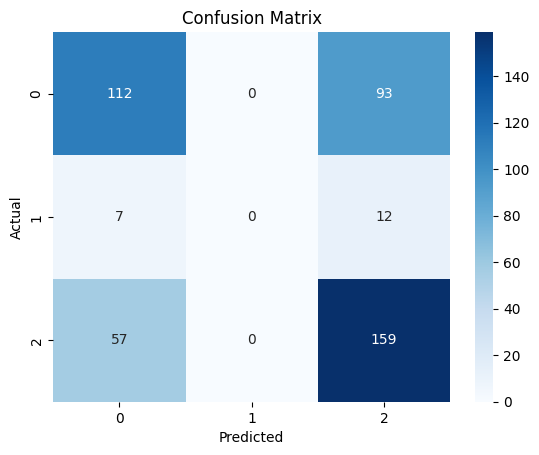

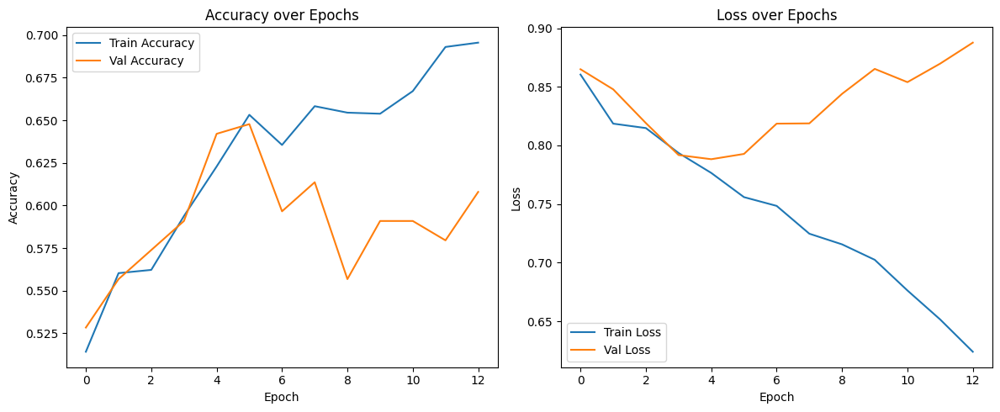

In [40]:
run_late_fusion_pipeline()

In [15]:
import pandas as pd
import torch
import numpy as np

# Load the dataset
df = pd.read_csv('/content/drive/MyDrive/CMU_MOSI_Project/combined_featuresrumaisaa.csv')

# Extract a single row (e.g., first row)
row = df.iloc[100]

# Slice features for each modality
text_features = row[[f'text_{i}' for i in range(300)]].values.astype(np.float32)
audio_features = row[[f'acoustic_{i}' for i in range(74)]].values.astype(np.float32)
visual_features = row[[f'visual_{i}' for i in range(430)]].values.astype(np.float32)
true_label = int(row['sentiment_score.1']) + 1  # original label

# Convert to tensors
text_tensor = torch.tensor(text_features).unsqueeze(0).to(DEVICE)
audio_tensor = torch.tensor(audio_features).unsqueeze(0).to(DEVICE)
visual_tensor = torch.tensor(visual_features).unsqueeze(0).to(DEVICE)

# Load the trained model
model = LateFusionModel().to(DEVICE)
model.load_state_dict(torch.load("best_late_fusion_model.pt", map_location=DEVICE))
model.eval()

# Predict
with torch.no_grad():
    output = model(text_tensor, audio_tensor, visual_tensor)
    pred_class = torch.argmax(output, dim=1).item()

# Label mapping
label_map = {0: "Negative", 1: "Neutral", 2: "Positive"}

print(" True Label(in dataset):     ", label_map[true_label])
print(" Predicted Label:", label_map[pred_class])


 True Label(in dataset):      Positive
 Predicted Label: Positive


In [13]:
from lime import lime_tabular

# Combine all modalities into a single vector for a specific sample
sample_idx = 100
sample = np.concatenate([
    X_text[sample_idx],
    X_acoustic[sample_idx],
    X_visual[sample_idx]
])

explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.concatenate([X_text, X_acoustic, X_visual], axis=1),
    feature_names=[f'text_{i}' for i in range(300)] +
                  [f'audio_{i}' for i in range(74)] +
                  [f'visual_{i}' for i in range(430)],
    class_names=['Negative', 'Neutral', 'Positive'],
    discretize_continuous=True
)

# Define a prediction wrapper
def predict_fn(inputs):
    inputs = torch.tensor(inputs, dtype=torch.float32).to(DEVICE)
    text = inputs[:, :300]
    audio = inputs[:, 300:374]
    visual = inputs[:, 374:]
    with torch.no_grad():
        outputs = model(text, audio, visual)
    return torch.nn.functional.softmax(outputs, dim=1).cpu().numpy()

# Explain prediction
exp = explainer.explain_instance(sample, predict_fn, num_features=10)
exp.show_in_notebook()

In [11]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 6.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=1607c172625f805d41d586f50ea4b3227a23b4e99fd198539d8b221f36236446
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime


# Gemini Prompts

1. "Design a late fusion deep learning model that combines pre-extracted features from text, visual, and audio modalities.
   Use an LSTM for text, MLP for audio, and MLP for visual, then combine them in a classifier head. Provide full PyTorch code."

2. "For a multi-modal dataset with text (300-dim), audio (74-dim), and visual (430-dim) pre-extracted features,
  build a PyTorch Dataset and DataLoader. Ensure compatibility with late fusion architectures."

3. "Add early stopping and best model saving to a training loop in PyTorch based on validation accuracy improvement.
   Patience should be configurable."

4. "Implement a complete PyTorch training pipeline for a late fusion model that uses LSTM for text, MLPs for audio and visual.
   Include classification report and confusion matrix after evaluation."

5. "Give inference code using a trained late fusion model with inputs as real extracted feature rows from a CSV file.
  Ensure the input comes from a specific row index and prediction returns a human-readable label."

6. "How can I check for class imbalance in my training, validation, and test sets after performing stratified train-test split on a Pandas DataFrame?"

7. "Plot training and validation accuracy curves for each epoch from two Python lists using matplotlib."

8. "Build a model to classify multimodal sentiment using pre-extracted features only.   No raw audio or images. Include dropout, batch normalization, and explain each branch of the model."

9. "Suggest base models for each modality (text, visual, acoustic) in a late fusion architecture. Be lightweight and suitable for a feature-level dataset."

10. "Compare using synthetic random features vs. using real extracted features for inference in a multimodal pipeline. Which is better and how do I extract a row for inference?"


#pipeline

In [16]:
!pip install noisereduce

In [38]:
import cv2
import os
import numpy as np
import torch
from torchvision import models, transforms
import mediapipe as mp

def video_feature_extraction_pipeline(video_path, sample_rate=10, duration_limit=30):
    # === Initialize MediaPipe Pose ===
    mp_pose = mp.solutions.pose
    pose = mp_pose.Pose(static_image_mode=False, min_detection_confidence=0.5)

    # === Load VGG16 Model ===
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model = models.vgg16(pretrained=True).to(device).eval()
    preprocess = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225]),
    ])

    # === Feature Extraction Functions ===
    def extract_mediapipe_features(frame):
        results = pose.process(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        if results.pose_landmarks:
            return np.array([[lmk.x, lmk.y, lmk.z] for lmk in results.pose_landmarks.landmark]).flatten()
        return np.zeros(33 * 3)

    def extract_vgg_features(frame):
        img_tensor = preprocess(frame).unsqueeze(0).to(device)
        with torch.no_grad():
            features = model(img_tensor).cpu().numpy().flatten()
        return features[:100]

    def extract_optical_flow(prev_frame, curr_frame):
        prev_gray = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)
        curr_gray = cv2.cvtColor(curr_frame, cv2.COLOR_BGR2GRAY)
        flow = cv2.calcOpticalFlowFarneback(prev_gray, curr_gray, None,
                                            0.5, 3, 15, 3, 5, 1.2, 0)
        return flow.mean(axis=(0, 1))  # Shape: (2,)

    # === Main Video Processing ===
    cap = cv2.VideoCapture(video_path)
    fps = cap.get(cv2.CAP_PROP_FPS)
    frame_limit = int(fps * duration_limit)

    mediapipe_feats, vgg_feats, flow_feats = [], [], []
    prev_frame = None
    sampled_frames = 0

    while True:
        success, frame = cap.read()
        if not success:
            break
        if sampled_frames >= frame_limit:
            break
        if sampled_frames % sample_rate == 0:
            mediapipe_feats.append(extract_mediapipe_features(frame))
            vgg_feats.append(extract_vgg_features(frame))
            if prev_frame is not None:
                flow_feats.append(extract_optical_flow(prev_frame, frame))
        prev_frame = frame
        sampled_frames += 1

    cap.release()

    # === Feature Aggregation ===
    pose_vec = np.mean(mediapipe_feats, axis=0) if mediapipe_feats else np.zeros(33*3)
    vgg_vec = np.mean(vgg_feats, axis=0) if vgg_feats else np.zeros(100)
    flow_vec = np.mean(flow_feats, axis=0) if flow_feats else np.zeros(2)

    # Adjust to 297 if needed (e.g., if model expects 430 features total)
    pose_vec = pose_vec[:328]  # Trimming if needed
    final_feature_vector = np.concatenate([pose_vec, vgg_vec, flow_vec])  # (297 + 100 + 2 = 399)
    final_feature_vector = np.pad(final_feature_vector, (0, 430 - final_feature_vector.shape[0]), mode='constant')

    return final_feature_vector  # Shape: (430,)

# === Example Usage ===
video_path = "/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/Full/yvsjCA6Y5Fc.mp4"
feature_vector = video_feature_extraction_pipeline(video_path)
print("Shape of extracted feature vector:", feature_vector.shape)  # Should print (430,)


  warnings.warn(

  warnings.warn(msg)



Shape of extracted feature vector: (430,)


In [29]:
!pip install mediapipe

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.6/35.6 MB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 52.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.6/294.6 kB 22.2 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 5.29.4
    Uninstalling protobuf-5.29.4:
      Successfully uninstalled protobuf-5.29.4
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.26.4 which is incompatible.
grpcio-status 1.71.0 requires protobuf<6.0dev,>=5.26.1, but you have protobuf 4.25.7 which is incompatib

In [43]:
import cv2
import torch
import librosa
import numpy as np
from moviepy.editor import VideoFileClip
from transformers import pipeline  # For transcription or use whisper
from torchvision import models, transforms
import spacy
from textblob import TextBlob
import noisereduce as nr

# Constants
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
VIDEO_PATH = "/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/Full/yvsjCA6Y5Fc.mp4"

# Load video
clip = VideoFileClip(VIDEO_PATH)
clip = clip.subclip(0, 30)

# Load spaCy for NER and word vectors (en_core_web_lg has word vectors)
nlp = spacy.load("en_core_web_lg")

def extract_text_features_spacy(text):
    # Sentiment features
    blob = TextBlob(text)
    polarity = blob.sentiment.polarity
    subjectivity = blob.sentiment.subjectivity

    # NER
    doc = nlp(text)
    entities = [ent.text for ent in doc.ents]

    # Tokenize text
    words = text.split()

    # Get word vectors and compute average
    vectors = [token.vector for token in doc if token.has_vector]

    if vectors:
        mean_vector = np.mean(vectors, axis=0)
    else:
        mean_vector = np.zeros(300)  # fallback for empty or OOV text

    return {
        'sentiment_polarity': polarity,
        'sentiment_subjectivity': subjectivity,
        'entities_count': len(entities),
        'word_count': len(words),
        **{f'spacy_{i}': v for i, v in enumerate(mean_vector)}
    }


def extract_audio_features_denoised(audio_path):
    y, sr = librosa.load(audio_path, sr=None)

    # Noise reduction using entire clip
    y_denoised = nr.reduce_noise(y=y, sr=sr)

    # Extract features
    mfcc = librosa.feature.mfcc(y=y_denoised, sr=sr, n_mfcc=30)
    chroma = librosa.feature.chroma_stft(y=y_denoised, sr=sr)
    spectral_contrast = librosa.feature.spectral_contrast(y=y_denoised, sr=sr)
    zcr = librosa.feature.zero_crossing_rate(y=y_denoised)
    rmse = librosa.feature.rms(y=y_denoised)

    # Aggregate features
    features = {
        **{f'mfcc_mean_{i}': mfcc[i].mean() for i in range(mfcc.shape[0])},
        **{f'mfcc_std_{i}': mfcc[i].std() for i in range(mfcc.shape[0])},
        **{f'chroma_mean_{i}': chroma[i].mean() for i in range(6)},  # first 6
        **{f'spectral_contrast_mean_{i}': spectral_contrast[i].mean() for i in range(4)},  # first 4
        'zcr_mean': zcr.mean(),
        'zcr_std': zcr.std(),
        'rmse_mean': rmse.mean(),
        'rmse_std': rmse.std()
    }

    return features


# Extract audio and transcribe
audio_path = "temp_audio.wav"
clip.audio.write_audiofile(audio_path)
asr = pipeline("automatic-speech-recognition", model="openai/whisper-base")
transcription = asr(audio_path)["text"]

# Extract text features (e.g., BERT)
text_features = extract_text_features_spacy(transcription)  # should return a dict with 300 dimensions + other features
# Flatten the features dictionary to a list or NumPy array
text_feature_list = np.array([value for key, value in sorted(text_features.items())])

# Extract audio features (e.g., MFCCs using librosa)
audio_features = extract_audio_features_denoised(audio_path)  # should return a dict with audio features
# Flatten the audio features dictionary to a list or NumPy array
audio_feature_list = np.array([value for key, value in sorted(audio_features.items())])

# Extract visual features (sample and encode frames using ResNet50)
visual_features = video_feature_extraction_pipeline(VIDEO_PATH)  # should return shape [430]
print("extraction done")

# Ensure text features have the correct size (300)
text_feature_vector = np.array(list(text_features.values()))
if text_feature_vector.shape[0] > 300:
    text_feature_vector = text_feature_vector[:300]  # Truncate if too large
elif text_feature_vector.shape[0] < 300:
    text_feature_vector = np.pad(text_feature_vector, (0, 300 - text_feature_vector.shape[0]), mode='constant')  # Pad if too small

# Convert to tensor with correct dtype
text_tensor = torch.tensor(text_feature_vector).unsqueeze(0).to(DEVICE).float()
audio_tensor = torch.tensor(np.array(list(audio_features.values())), dtype=torch.float32).unsqueeze(0).to(DEVICE)

visual_tensor = torch.tensor(visual_features).unsqueeze(0).to(DEVICE).float()

# Load model and predict
model = LateFusionModel().to(DEVICE)
model.load_state_dict(torch.load("best_late_fusion_model.pt", map_location=DEVICE))
model.eval()

with torch.no_grad():
    output = model(text_tensor, audio_tensor, visual_tensor)
    pred_class = torch.argmax(output, dim=1).item()

# Map label
label_map = {0: "Negative", 1: "Neutral", 2: "Positive"}
print("Predicted Sentiment:", label_map[pred_class])


MoviePy - Writing audio in temp_audio.wav


MoviePy - Done.


Device set to use cpu
  warnings.warn(

  warnings.warn(

  warnings.warn(msg)



extraction done
Predicted Sentiment: Negative


In [48]:
sclip = clip.subclip(0, 30)
# Save the 30-second trimmed clip
trimmed_video_path = "trimmed_clip.mp4"
sclip.write_videofile(trimmed_video_path, codec="libx264", audio_codec="aac")

# Display the saved clip
from IPython.display import Video, Audio, display

print(" Displaying Video Clip:")
display(Video(trimmed_video_path, embed=True, width=640, height=360))

# Play audio
print("\n Playing Audio:")
display(Audio(audio_path))
label_map = {0: "Negative", 1: "Neutral", 2: "Positive"}
print("Predicted Sentiment:", label_map[pred_class])

Moviepy - Building video trimmed_clip.mp4.
MoviePy - Writing audio in trimmed_clipTEMP_MPY_wvf_snd.mp4


MoviePy - Done.
Moviepy - Writing video trimmed_clip.mp4



Moviepy - Done !
Moviepy - video ready trimmed_clip.mp4
 Displaying Video Clip:



 Playing Audio:


Predicted Sentiment: Negative


In [56]:
import cv2
import torch
import librosa
import numpy as np
from moviepy.editor import VideoFileClip
from transformers import pipeline
from torchvision import models, transforms
import spacy
from textblob import TextBlob
import noisereduce as nr
from IPython.display import Video, Audio, display

# Constants
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
nlp = spacy.load("en_core_web_lg")
asr = pipeline("automatic-speech-recognition", model="openai/whisper-base")


def extract_text_features_spacy(text):
    blob = TextBlob(text)
    polarity = blob.sentiment.polarity
    subjectivity = blob.sentiment.subjectivity
    doc = nlp(text)
    entities = [ent.text for ent in doc.ents]
    words = text.split()
    vectors = [token.vector for token in doc if token.has_vector]

    mean_vector = np.mean(vectors, axis=0) if vectors else np.zeros(300)
    return {
        'sentiment_polarity': polarity,
        'sentiment_subjectivity': subjectivity,
        'entities_count': len(entities),
        'word_count': len(words),
        **{f'spacy_{i}': v for i, v in enumerate(mean_vector)}
    }


def extract_audio_features_denoised(audio_path):
    y, sr = librosa.load(audio_path, sr=None)
    y_denoised = nr.reduce_noise(y=y, sr=sr)

    mfcc = librosa.feature.mfcc(y=y_denoised, sr=sr, n_mfcc=30)
    chroma = librosa.feature.chroma_stft(y=y_denoised, sr=sr)
    spectral_contrast = librosa.feature.spectral_contrast(y=y_denoised, sr=sr)
    zcr = librosa.feature.zero_crossing_rate(y=y_denoised)
    rmse = librosa.feature.rms(y=y_denoised)

    return {
        **{f'mfcc_mean_{i}': mfcc[i].mean() for i in range(mfcc.shape[0])},
        **{f'mfcc_std_{i}': mfcc[i].std() for i in range(mfcc.shape[0])},
        **{f'chroma_mean_{i}': chroma[i].mean() for i in range(6)},
        **{f'spectral_contrast_mean_{i}': spectral_contrast[i].mean() for i in range(4)},
        'zcr_mean': zcr.mean(),
        'zcr_std': zcr.std(),
        'rmse_mean': rmse.mean(),
        'rmse_std': rmse.std()
    }




def predict_sentiment_from_video(video_path,start=0,end=30, model_path="best_late_fusion_model.pt"):
    print(f" Processing video: {video_path}")

    clip = VideoFileClip(video_path).subclip(start, end)
    audio_path = "temp_audio.wav"
    clip.audio.write_audiofile(audio_path, verbose=False, logger=None)

    # Step 1: Transcribe
    transcription = asr(audio_path)["text"]

    # Step 2: Extract Features
    text_features = extract_text_features_spacy(transcription)
    text_vector = np.array(list(text_features.values()))
    if text_vector.shape[0] > 300:
        text_vector = text_vector[:300]
    elif text_vector.shape[0] < 300:
        text_vector = np.pad(text_vector, (0, 300 - text_vector.shape[0]), mode='constant')

    audio_features = extract_audio_features_denoised(audio_path)
    visual_features = video_feature_extraction_pipeline(video_path)

    # Step 3: Convert to tensors
    text_tensor = torch.tensor(text_vector).unsqueeze(0).to(DEVICE).float()
    audio_tensor = torch.tensor(np.array(list(audio_features.values())), dtype=torch.float32).unsqueeze(0).to(DEVICE)
    visual_tensor = torch.tensor(visual_features).unsqueeze(0).to(DEVICE).float()

    # Step 4: Load model
    model = LateFusionModel().to(DEVICE)
    model.load_state_dict(torch.load(model_path, map_location=DEVICE))
    model.eval()

    with torch.no_grad():
        output = model(text_tensor, audio_tensor, visual_tensor)
        pred_class = torch.argmax(output, dim=1).item()

    # Save the 30-second trimmed clip
    trimmed_video_path = "trimmed_clip.mp4"
    clip.write_videofile(trimmed_video_path, codec="libx264", audio_codec="aac")

    # Display the saved clip
    print(" Displaying Video Clip:")
    display(Video(trimmed_video_path, embed=True, width=640, height=360))

    # Play audio
    print("\n🔊 Playing Audio:")
    display(Audio(audio_path))

    label_map = {0: "Negative", 1: "Neutral", 2: "Positive"}
    print(" Predicted Sentiment:", label_map[pred_class])
    return label_map[pred_class]


Device set to use cpu


In [57]:
predict_sentiment_from_video("/content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/Full/_dI--eQ6qVU.mp4",15,45)

 Processing video: /content/drive/MyDrive/CMU_MOSI_Project/Kaggle_Raw_Dataset/Video/Full/_dI--eQ6qVU.mp4


  warnings.warn(

  warnings.warn(

  warnings.warn(msg)



Moviepy - Building video trimmed_clip.mp4.
MoviePy - Writing audio in trimmed_clipTEMP_MPY_wvf_snd.mp4


MoviePy - Done.
Moviepy - Writing video trimmed_clip.mp4



Moviepy - Done !
Moviepy - video ready trimmed_clip.mp4
 Displaying Video Clip:



🔊 Playing Audio:


 Predicted Sentiment: Positive


'Positive'

In [18]:
!python -m spacy download en_core_web_lg


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.7/400.7 MB 1.8 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_lg')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.
